In [1]:
#! /app/software/R/4.0.3-foss-2020b/bin/Rscript
## JG used R/4.1.2-foss-2020b

# load external dependencies
lmod <- Sys.getenv("LMOD_CMD")
modules <- c(
    #"cairo/1.16.0-GCCcore-10.2.0",
    "R/4.1.2-foss-2020b",
    #"X11/20201008-GCCcore-10.2.0",
    "MACS2/2.2.6-foss-2019b-Python-3.7.4")

for (module in modules) {
    cmd <- paste(lmod, 'R', 'load', module)
    code <- system(cmd, intern = TRUE)
    eval(parse(text = code))
}

In [2]:
Sys.unsetenv("DISPLAY")

suppressPackageStartupMessages({
    library(ArchR)
    library(parallel)
    library(rtracklayer)
    library(repr)
    library(dplyr)
    library(Seurat)
    library(plyr)
    library(ComplexHeatmap)
    library(RColorBrewer)    
    library(BSgenome.Hsapiens.UCSC.hg38)
    library(raincloudplots)
    library(PupillometryR)
    library(cowplot)
    library(scales) 
})
set.seed(1)

# Set default plot size
options(repr.plot.width=10, repr.plot.height=10)


                                                   / |
                                                 /    \
            .                                  /      |.
            \\\                              /        |.
              \\\                          /           `|.
                \\\                      /              |.
                  \                    /                |\
                  \\#####\           /                  ||
                ==###########>      /                   ||
                 \\##==......\    /                     ||
            ______ =       =|__ /__                     ||      \\\
        ,--' ,----`-,__ ___/'  --,-`-===================##========>
       \               '        ##_______ _____ ,--,__,=##,__   ///
        ,    __==    ___,-,__,--'#'  ==='      `-'    | ##,-/
        -,____,---'       \\####\\________________,--\\_##,/
           ___      .______        ______  __    __  .______      
          /   \     |   _ 

In [3]:
addArchRThreads(threads = 24)

Setting default number of Parallel threads to 24.



In [4]:
#Utility functions
# SVD, UMAP, and Clustering
UMAP_clusters = function(proj){
    #SVD
    proj <- addIterativeLSI(
        ArchRProj = proj,
        useMatrix = "TileMatrix", 
        name = "IterativeLSI", 
        iterations = 2, 
        dimsToUse = 1:15, 
        varFeatures = 200000, 
        clusterParams = list( #See Seurat::FindClusters,
            resolution = c(0.1, 0.3), 
            sampleCells = 8000, 
            n.start = 10), 
        outlierQuantiles = c(0.025, 0.975), 
        verbose = FALSE,
        force=TRUE
    )
    #UMAP
    proj <- addUMAP(
        ArchRProj = proj,
        reducedDims = "IterativeLSI",
        name = "UMAP",
        nNeighbors = 40,
        minDist = 0.4,
        metric = "cosine",
        verbose = FALSE,
        force = TRUE
    )
    #Clustering
    #proj <- addClusters(input = proj, 
    #                        method = "Seurat", 
    #                        name = "Clusters", 
    #                        reducedDims = "IterativeLSI",  
    #                        resolution = 0.3, 
    #                        #maxClusters = 100,
    #                        verbose = FALSE,
    #                        force=TRUE
    #                       )
    
    #Save
    #p1 <- plotEmbedding(ArchRProj = proj, colorBy = "cellColData", name = "Clusters", embedding = "UMAP")
    #plotPDF(p1, name = "Plot-UMAP-Sample-Clusters_1.pdf", ArchRProj = proj, addDOC = FALSE, width = 5, height = 5)
    return(proj)
}

In [5]:
#compute gene scores, impute genes

impute_genes = function(proj){
    # Gene scores with selected features
    # Artificial black list to exclude all non variable features
    #chrs <- getChromSizes(proj)
    #var_features_gr <- GRanges(var_features$seqnames,
    #                           IRanges(var_features$start,
    #                                   var_features$start + bin_size))
    #blacklist <- setdiff(chrs, var_features_gr)
    proj <- addGeneScoreMatrix(proj, matrixName='GeneScoreMatrix', force=TRUE) 
    
    #impute
    proj = addImputeWeights(      
    ArchRProj = proj,
    reducedDims = "IterativeLSI",
    dimsToUse = 2:15,
    scaleDims = NULL,
    corCutOff = 0.75,
    td = 3,
    ka = 4,
    sampleCells = 3000,
    nRep = 5,
    k = 15,
    epsilon = 1,
    useHdf5 = TRUE,
    randomSuffix = FALSE,
    threads = getArchRThreads(),
    seed = 1,
    verbose = TRUE,
    logFile = createLogFile("addImputeWeights")
    )
     return(proj)
}

In [6]:
#load data
proj_name = 'DJ_Hs_PBMC_K4me123_220523_220527_79x79_MERGE_50k'
version = 'proj_FINAL_v4'
proj_dir <- paste0("/fh/fast/henikoff_s/user/jgreene/projects/sciCnT/data/ArchR/", proj_name, '/', version)
proj = loadArchRProject(path = proj_dir,
                 force = TRUE,
                 showLogo = TRUE)
setwd(proj_dir)

Successfully loaded ArchRProject!


                                                   / |
                                                 /    \
            .                                  /      |.
            \\\                              /        |.
              \\\                          /           `|.
                \\\                      /              |.
                  \                    /                |\
                  \\#####\           /                  ||
                ==###########>      /                   ||
                 \\##==......\    /                     ||
            ______ =       =|__ /__                     ||      \\\
        ,--' ,----`-,__ ___/'  --,-`-===================##========>
       \               '        ##_______ _____ ,--,__,=##,__   ///
        ,    __==    ___,-,__,--'#'  ==='      `-'    | ##,-/
        -,____,---'       \\####\\________________,--\\_##,/
           ___      .______        ______  __    __  .____

In [7]:
mean(proj$nFrags)

[1] 1420

ArchR logging to : ArchRLogs/ArchR-plotEmbedding-24b11ba8e13-Date-2023-05-10_Time-14-29-02.log
If there is an issue, please report to github with logFile!

Getting UMAP Embedding

ColorBy = cellColData

Plotting Embedding

1 


ArchR logging successful to : ArchRLogs/ArchR-plotEmbedding-24b11ba8e13-Date-2023-05-10_Time-14-29-02.log



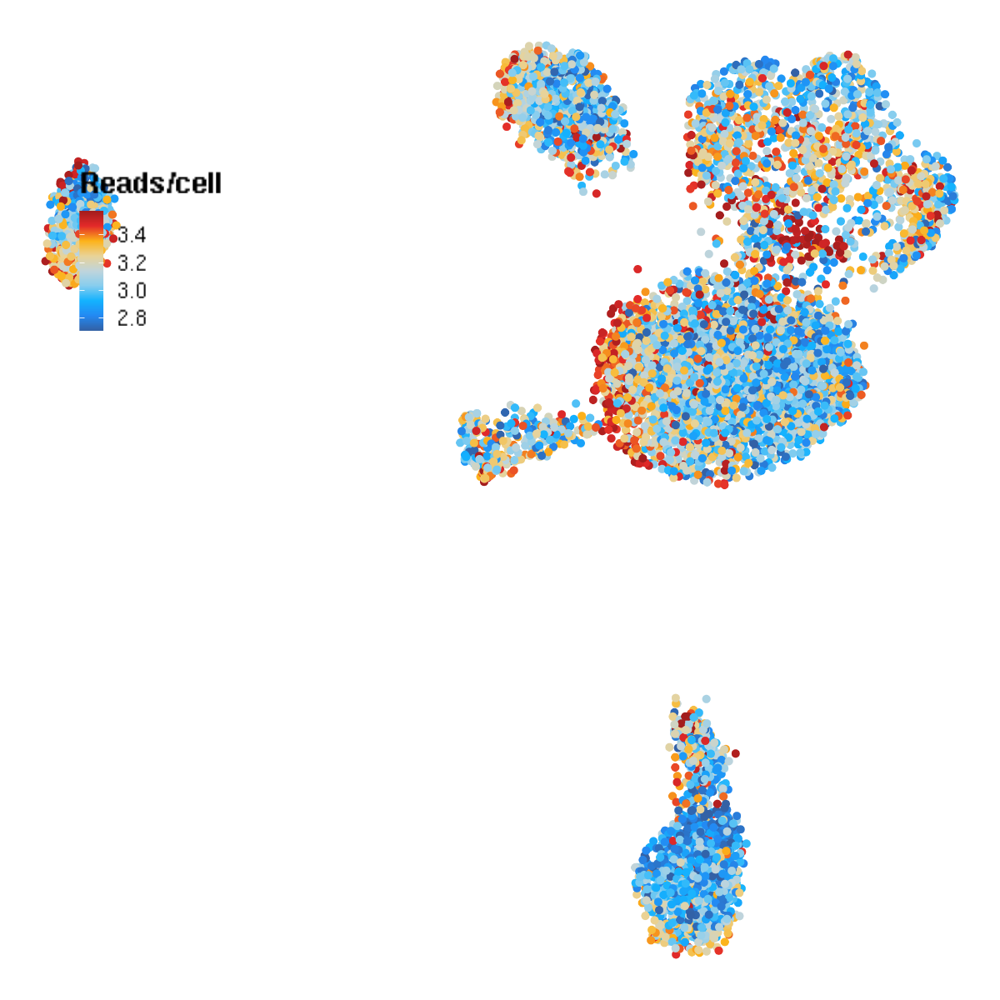

In [9]:
#Visualize clusters
proj$logFrags = log10(proj$nFrags)
p0 = plotEmbedding(ArchRProj = proj, colorBy = "cellColData", 
              name = "logFrags", 
              embedding = "UMAP", 
              size =1, 
              #pal= c("3"="black","2"="#f77e05", "1"="#b50202"),
              plotAs= "points", 
              #imputeWeights = getImputeWeights(proj)
              colorTitle = 'Reads/cell'
             )+theme_void()+theme(plot.title = element_blank(), 
                                  strip.text = element_blank(), 
                                  legend.position = c(.15, .75), 
                                  legend.text = element_text(size=15, family = 'Helvetica'),
                                  legend.title = element_text(size=20, family = 'Helvetica', face = "bold")
                                 )#+NoLegend()
p0

In [258]:
plot_dir = '/fh/fast/henikoff_s/user/jgreene/projects/sciCnT/data/Figures/50kb/'
pdf(file=paste0(plot_dir, '221220_PBMC_K4me123_15dims_counts_legend.pdf'),width=10, height=10)
p0
dev.off()

png 
  2

In [8]:
median(proj$nFrags)

[1] 1212

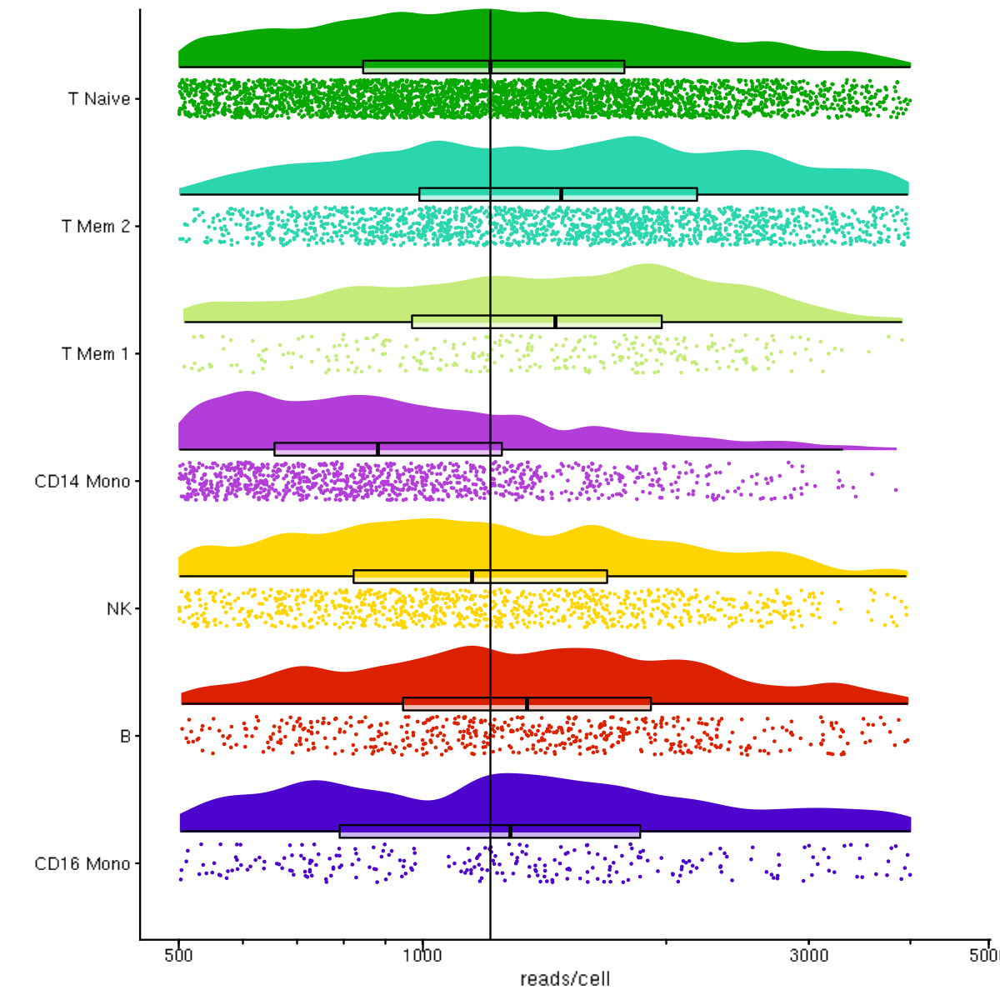

In [27]:
#Rainclouds with median and confidence interval
pal = c( 
        

        "#07a802",
        "#2bd6ae",
        "#c5eb7a", 
        
        '#b23dd9',
        "#ffd500",
        "#db2100",


        "#4d04cc")
#extract umap
umap_df = proj@cellColData %>% data.frame()
umap_df$UMAP_1 = proj@embeddings$UMAP$df[,1]
umap_df$UMAP_2 = proj@embeddings$UMAP$df[,2]

#reorder and plot
ord_new = c('T Naive', 'T Mem 2','T Mem 1', 'CD14 Mono', 'NK', 'B', 'CD16 Mono')
umap_df$Clusters <- factor(umap_df$annotation, levels = rev(ord_new))
umap_df <- umap_df[order(umap_df$Clusters),]

p7 <- ggplot(umap_df,
             aes(x=Clusters,
                 y=nFrags, 
                 fill = Clusters, 
                 colour = Clusters
                )
            )+
    geom_flat_violin(
        position = position_nudge(
        x = .25, 
        y = 0),
        adjust =.5,
        scale = "width"
    )+
    geom_point(position = position_jitter(width = .15), 
             size = .25)+
    geom_boxplot(aes(x = Clusters, 
                     y = nFrags),
                 position = position_nudge(
                        x = .25, 
                        y = 0),
                 outlier.shape = NA, 
                 alpha = 0.3, 
                 width = .1, 
                 colour = "BLACK") +

    geom_hline(yintercept = median(umap_df$nFrags), color = 'black')+
    ylab('reads/cell')+
    xlab('')+
    coord_flip(clip = "off")+
    theme_cowplot()+
    guides(fill = 'none', 
           colour = 'none')+
    scale_color_manual(name = "Celltypes",
                         values = rev(pal)
    )+
    scale_fill_manual(name = "Celltypes",
                         values = rev(pal)
    )+
    scale_y_log10(limits = c(500, 4500))+ 
    scale_x_discrete()+
    annotation_logticks(sides = 'b', outside = T,)
p7

In [28]:
plot_dir = '/fh/fast/henikoff_s/user/jgreene/projects/sciCnT/data/Figures/'
pdf(file=paste0(plot_dir, '221216_PBMC_K4me123_rainplot.pdf'),width=15, height=10)
p7
dev.off()

png 
  2

# B alone

In [11]:
projB = proj[(proj$Clusters %in% c('C6'))]
#projB = UMAP_clusters(projB)

ArchR logging to : ArchRLogs/ArchR-plotEmbedding-4168d2533fd-Date-2022-10-16_Time-18-06-15.log
If there is an issue, please report to github with logFile!

Getting UMAP Embedding

ColorBy = cellColData

Plotting Embedding

1 


ArchR logging successful to : ArchRLogs/ArchR-plotEmbedding-4168d2533fd-Date-2022-10-16_Time-18-06-15.log



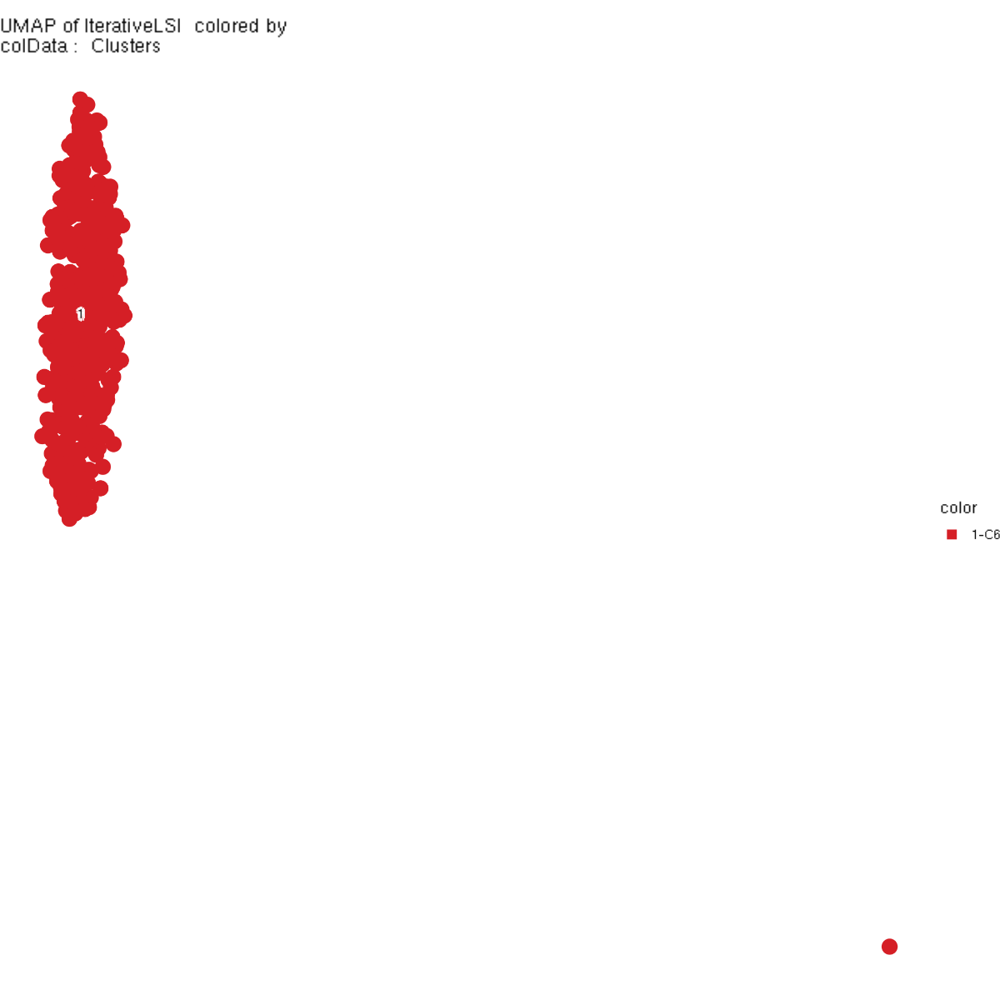

In [12]:
#Visualize clusters
plotEmbedding(ArchRProj = projB, colorBy = "cellColData", 
              name = "Clusters", 
              embedding = "UMAP", 
              size =3, 
              #pal= paletteContinuous(), 
              plotAs= "points", 
              #imputeWeights = getImputeWeights(proj)
             )+theme_void()#+theme(plot.title = element_blank())+ NoLegend()

In [35]:
projB


           ___      .______        ______  __    __  .______      
          /   \     |   _  \      /      ||  |  |  | |   _  \     
         /  ^  \    |  |_)  |    |  ,----'|  |__|  | |  |_)  |    
        /  /_\  \   |      /     |  |     |   __   | |      /     
       /  _____  \  |  |\  \\___ |  `----.|  |  |  | |  |\  \\___.
      /__/     \__\ | _| `._____| \______||__|  |__| | _| `._____|
    



class: ArchRProject 
outputDirectory: /fh/fast/henikoff_s/user/jgreene/projects/sciCnT/data/ArchR/DJ_Hs_PBMC_K4me123_220523_220527_79x79_MERGE_50k/proj_FINAL_v3 
samples(1): DJ_Hs_PBMC_K4me123_ALLSEQ_220523_220527
sampleColData names(1): ArrowFiles
cellColData names(22): Sample TSSEnrichment ... assignment Clusters
numberOfCells(1): 518
medianTSS(1): 7.362
medianFrags(1): 1353

In [36]:
mean(projB$nFrags)

[1] 1516.087

In [16]:
projB <- addGeneScoreMatrix(projB, matrixName='GeneScoreMatrix', force=TRUE) 

ArchR logging to : ArchRLogs/ArchR-addGeneScoreMatrix-5a194d075bb2-Date-2022-10-04_Time-18-41-01.log
If there is an issue, please report to github with logFile!

2022-10-04 18:41:01 : Batch Execution w/ safelapply!, 0 mins elapsed.

.createArrowGroup : Arrow Group already exists! Dropping Group from ArrowFile! This will take ~10-30 seconds!

.dropGroupsFromArrow : Initializing Temp ArrowFile

.dropGroupsFromArrow : Adding Metadata to Temp ArrowFile

.dropGroupsFromArrow : Adding SubGroups to Temp ArrowFile

.dropGroupsFromArrow : Move Temp ArrowFile to ArrowFile

DJ_Hs_PBMC_K27me3_ALLSEQ_220523_220527 .addGeneScoreMat useTSS = FALSE

2022-10-04 18:41:13 : Computing Gene Scores using distance relative to GeneBody! , 0.209 mins elapsed.

ArchR logging successful to : ArchRLogs/ArchR-addGeneScoreMatrix-5a194d075bb2-Date-2022-10-04_Time-18-41-01.log



In [17]:
#marker genes
markersGS <- getMarkerFeatures(
ArchRProj = projB, 
useMatrix = "GeneScoreMatrix", 
groupBy = "Clusters",
bias = c("log10(nFrags)"),
testMethod = "wilcoxon"
)

ArchR logging to : ArchRLogs/ArchR-getMarkerFeatures-5a195d3a5c9a-Date-2022-10-04_Time-18-41-48.log
If there is an issue, please report to github with logFile!

MatrixClass = Sparse.Double.Matrix

2022-10-04 18:41:49 : Matching Known Biases, 0.002 mins elapsed.

###########
2022-10-04 18:42:11 : Completed Pairwise Tests, 0.369 mins elapsed.
###########

ArchR logging successful to : ArchRLogs/ArchR-getMarkerFeatures-5a195d3a5c9a-Date-2022-10-04_Time-18-41-48.log



Warning message:
“Removed 18 rows containing missing values (geom_point_rast).”


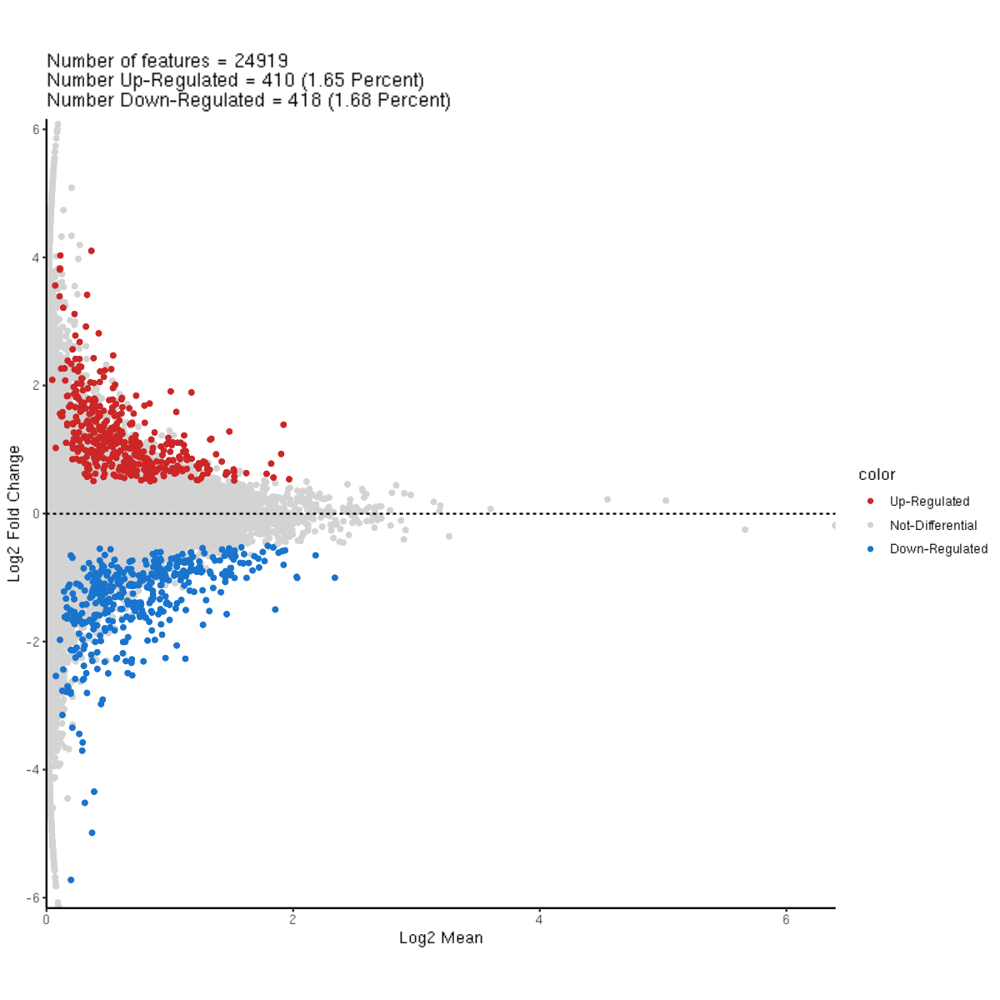

In [18]:
plotMarkers(
  seMarker = markersGS,
  name = 'C1',
  cutOff = "FDR <= 0.01 & abs(Log2FC) >= 0.5",
  plotAs = "MA",
  scaleTo = 10^4
)+theme_classic()

In [19]:
markerGenes  <- c(
    "CD34", #Early Progenitor
    "GATA1", #Erythroid
    "PAX5", "MS4A1", "EBF1", "MME", #B-Cell Trajectory
    "CD14", "CEBPB", "MPO", #Monocytes
    "IRF8", 'RUNX1', 'FCGR3A', 'HAVCR2', 'TOX', 'PDCD1',
    "CD3D", "CD8A", "TBX21", "IL7R", #TCells
    'CD163', 'IRAK3', 'FLT3', 'CEBPA', 'NCAM2', 'LEF1', 
    'BACH2', 'PRDM1', 'KLRD1', 'S100A12', 'PTPRC',
    'CCR3', 'CCR5', 'IL17A', 'IL17F', 'IL2RA', 'IL10RA', 'ITGAX', 'CDH5', 'CEACAM4', 'GYPA', 'ENPP2',
    'HLA-DRA', 'HLA-DQB2', 'FCGR2B',
    
    ## CD34 progenitors
    "CD34","CD38","PTPRC", "KIT", "FLT3", "HMGB3", "IL3RA", "IL7R", "MME", "CD27", "BCR", "ABL1",
    ## CD33 myeloid progenitors
    "CD34", "CD33","KIT","CD68", "NECTIN2", "FLT3", "CSF3R",
    ## B-cells
    "CD19", "MS4A1", "HLA-DRB1", "FCGR3A", "CD27", "IGheavy1", "CD9", "CD58", "PRDM2",
    ## Plasma Cells
    "ENPP1", "CD38", "SDC1", "CD27",
    ## T-cells
    "CD2", "CD3D", "NCAM1", "IL2RA", "CD69", "CD5", "CD4", "CD8A", "CD40LG",           
    "CD4", "CD8A","IL7R", "CCR7", "TCF7", "GZMK", "CTLA4", "TIGIT", "TBX21", "GATA3", "RORA", "FOXP3",
    ## NK-cells
    "CD3D", "NCAM1", "FCGR3A",
    ## dendritic cells
    "CD1C", "CD83", "THBD", "CD209", "HLA-DRB1", "ITGAX", "IL3RA", "CLEC4C", "NRP1",
    ## platelets, should be no platelets 
    "GP1BA", "SELP",
    ## Macrophages
    "ITGAM", "CD68", "CD163", "ANPEP",
    ## Monocytes
    "CD14", "FCGR3A", "FCGR1A",
    ## Red Blood Cells and erythroblast
    "ST6GALNAC1", "TFRC", "SLC4A1", "GYPA", "GYPB", "RHD", "RHCE", "RHAG", "HBB",
    ## Neutrophiles
    "FUT4", "FCGR3A", "CEACAM8", "CEACAM3",
    ## Basophils/Eosinophils
    "IL3RA", "ENPP3", "FCER1A", "ITGAM", "CCR3", "ADGRE1", "SIGLEC8",
    ##Endothelial
    "CD36", "CD93", "PECAM1", "VCAM1", "CDH5", "ESAM"
  )

ArchR logging to : ArchRLogs/ArchR-plotMarkerHeatmap-5a192219ccfa-Date-2022-10-04_Time-18-42-15.log
If there is an issue, please report to github with logFile!

Printing Top Marker Genes:

C1:

	PRKCZ, SPATA21, PADI1, PLA2G2D, UBXN10-AS1, LOC100506801, NBPF3, WNT4, LOC284632, GRHL3, NCMAP, SDC3, NKAIN1, PSMB2, C1orf216

C2:

	MEGF6, MIR551A, TPRG1L, NFIA, ROR1, ROR1-AS1, PDE4B, SGIP1, MIR3117, TCTEX1D1, ADGRL2, COL24A1, RPAP2, LINC01676, XCL2

Identified 761 markers!



  [1] "CD34"       "GATA1"      "PAX5"       "MS4A1"      "EBF1"      
  [6] "MME"        "CD14"       "CEBPB"      "MPO"        "IRF8"      
 [11] "RUNX1"      "FCGR3A"     "HAVCR2"     "TOX"        "PDCD1"     
 [16] "CD3D"       "CD8A"       "TBX21"      "IL7R"       "CD163"     
 [21] "IRAK3"      "FLT3"       "CEBPA"      "NCAM2"      "LEF1"      
 [26] "BACH2"      "PRDM1"      "KLRD1"      "S100A12"    "PTPRC"     
 [31] "CCR3"       "CCR5"       "IL17A"      "IL17F"      "IL2RA"     
 [36] "IL10RA"     "ITGAX"      "CDH5"       "CEACAM4"    "GYPA"      
 [41] "ENPP2"      "HLA-DRA"    "HLA-DQB2"   "FCGR2B"     "CD34"      
 [46] "CD38"       "PTPRC"      "KIT"        "FLT3"       "HMGB3"     
 [51] "IL3RA"      "IL7R"       "MME"        "CD27"       "BCR"       
 [56] "ABL1"       "CD34"       "CD33"       "KIT"        "CD68"      
 [61] "NECTIN2"    "FLT3"       "CSF3R"      "CD19"       "MS4A1"     
 [66] "HLA-DRB1"   "FCGR3A"     "CD27"       "IGheavy1"   "CD9"       
 [71] 

Preparing Main Heatmap..

ArchR logging successful to : ArchRLogs/ArchR-plotMarkerHeatmap-5a192219ccfa-Date-2022-10-04_Time-18-42-15.log



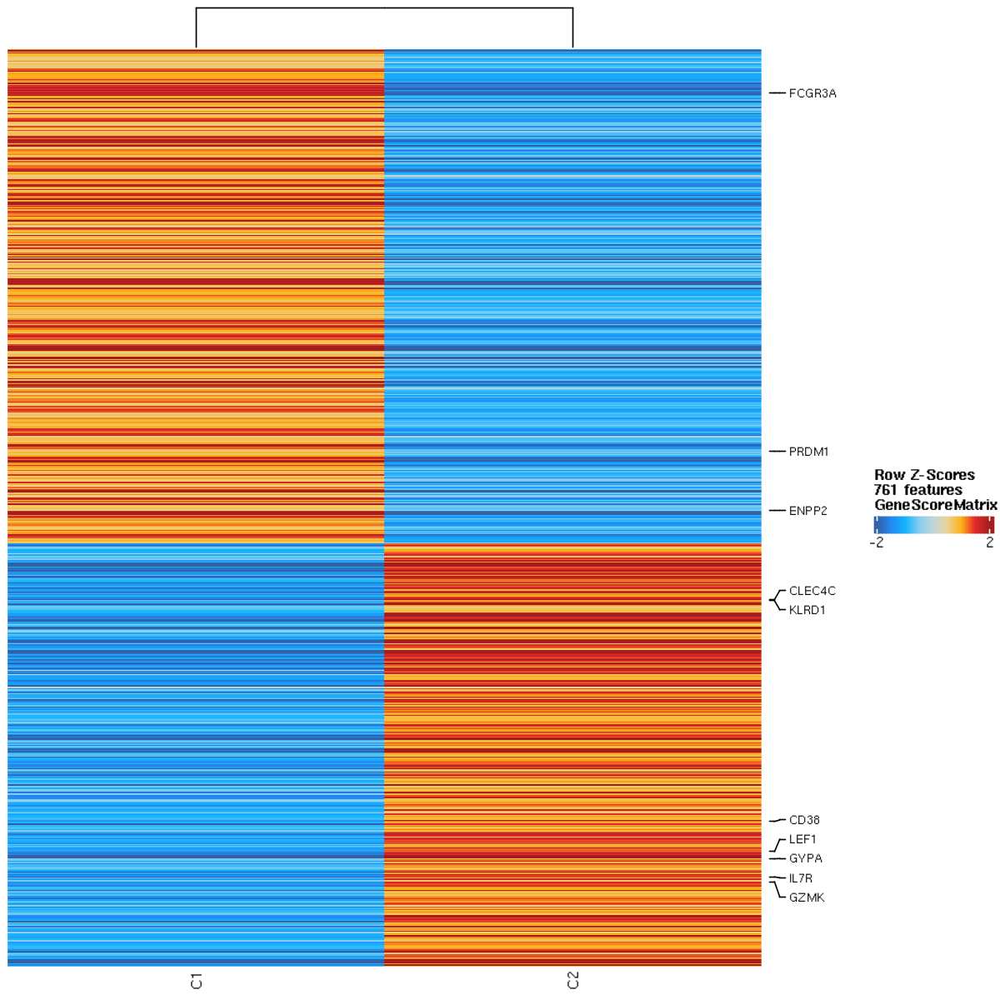

In [20]:
plotMarkerHeatmap(
  seMarker = markersGS,
  cutOff = "FDR <= 0.01 & Log2FC >= 0.5",
  log2Norm = TRUE,
  scaleTo = 10^4,
  scaleRows = TRUE,
  plotLog2FC = TRUE,
  limits = c(-2, 2),
  grepExclude = NULL,
  pal = paletteContinuous(),
  binaryClusterRows = TRUE,
  clusterCols = TRUE,
  labelMarkers = markerGenes,
  nLabel = 15,
  nPrint = 15,
  labelRows = FALSE,
  returnMatrix = FALSE,
  transpose = FALSE,
  invert = FALSE,
  logFile = createLogFile("plotMarkerHeatmap")
)

ArchR logging to : ArchRLogs/ArchR-plotMarkerHeatmap-5a19116d4acd-Date-2022-10-04_Time-18-42-17.log
If there is an issue, please report to github with logFile!

Printing Top Marker Genes:

C1:

	MEGF6, MIR551A, TPRG1L, NFIA, ROR1, ROR1-AS1, MIR4794, PDE4B, SGIP1, TCTEX1D1, INSL5, ADGRL2, LOC101928565, XCL2, C1orf21

C2:

	SPATA21, NBPF1, CROCC, LOC284632, MIR4420, NKAIN1, MIR3659, LINC01343, BMP8B, FOXJ3, CFAP57, MCOLN2, LOC646626, DDAH1, TMEM56-RWDD3

Identified 717 markers!



  [1] "CD34"       "GATA1"      "PAX5"       "MS4A1"      "EBF1"      
  [6] "MME"        "CD14"       "CEBPB"      "MPO"        "IRF8"      
 [11] "RUNX1"      "FCGR3A"     "HAVCR2"     "TOX"        "PDCD1"     
 [16] "CD3D"       "CD8A"       "TBX21"      "IL7R"       "CD163"     
 [21] "IRAK3"      "FLT3"       "CEBPA"      "NCAM2"      "LEF1"      
 [26] "BACH2"      "PRDM1"      "KLRD1"      "S100A12"    "PTPRC"     
 [31] "CCR3"       "CCR5"       "IL17A"      "IL17F"      "IL2RA"     
 [36] "IL10RA"     "ITGAX"      "CDH5"       "CEACAM4"    "GYPA"      
 [41] "ENPP2"      "HLA-DRA"    "HLA-DQB2"   "FCGR2B"     "CD34"      
 [46] "CD38"       "PTPRC"      "KIT"        "FLT3"       "HMGB3"     
 [51] "IL3RA"      "IL7R"       "MME"        "CD27"       "BCR"       
 [56] "ABL1"       "CD34"       "CD33"       "KIT"        "CD68"      
 [61] "NECTIN2"    "FLT3"       "CSF3R"      "CD19"       "MS4A1"     
 [66] "HLA-DRB1"   "FCGR3A"     "CD27"       "IGheavy1"   "CD9"       
 [71] 

Preparing Main Heatmap..

ArchR logging successful to : ArchRLogs/ArchR-plotMarkerHeatmap-5a19116d4acd-Date-2022-10-04_Time-18-42-17.log



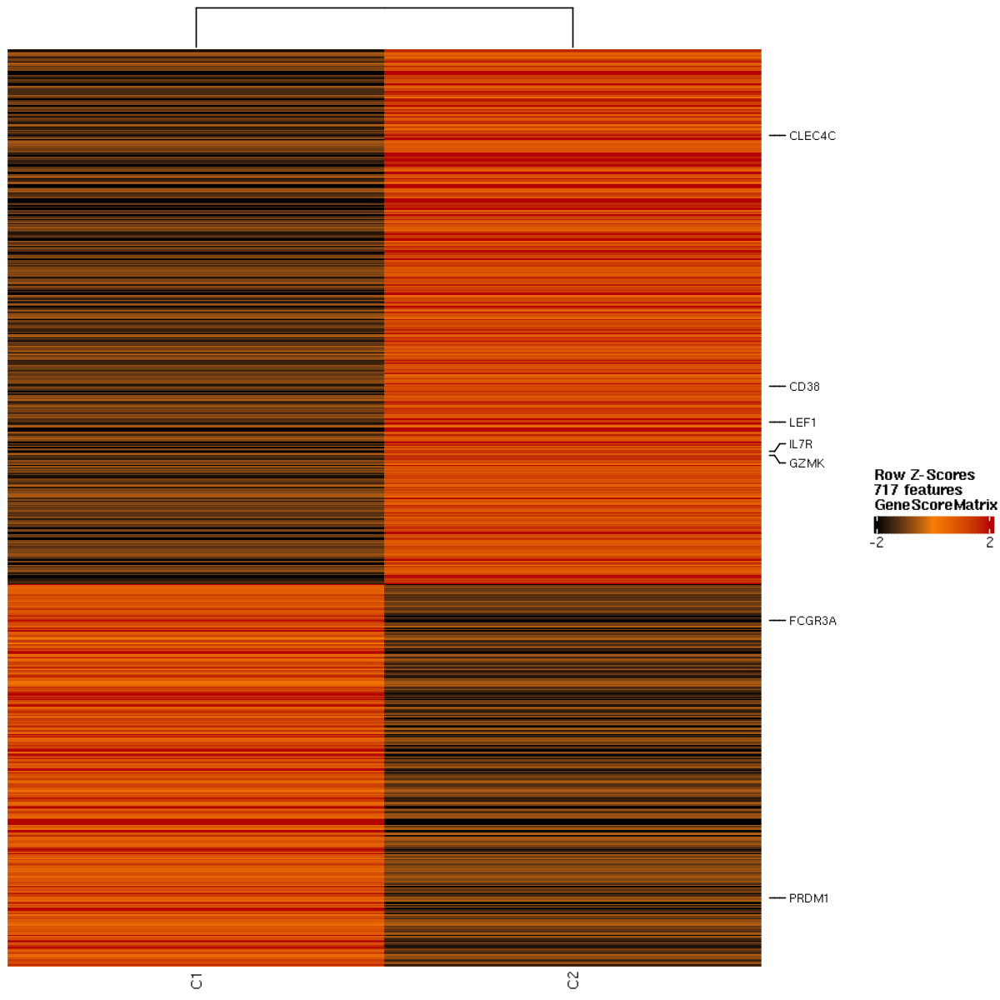

In [21]:
plotMarkerHeatmap(
  seMarker = markersGS,
  cutOff = "FDR <= 0.01 & Log2FC <= -0.5",
  log2Norm = TRUE,
  scaleTo = 10^4,
  scaleRows = TRUE,
  plotLog2FC = TRUE,
  limits = c(-2, 2),
  grepExclude = NULL,
  pal = c("3"="black","2"="#f77e05", "1"="#b50202"),
  binaryClusterRows = TRUE,
  clusterCols = TRUE,
  labelMarkers = markerGenes,
  nLabel = 15,
  nPrint = 15,
  labelRows = FALSE,
  returnMatrix = FALSE,
  transpose = FALSE,
  invert = FALSE,
  logFile = createLogFile("plotMarkerHeatmap")
)

ArchR logging to : ArchRLogs/ArchR-plotEmbedding-5a19358f0602-Date-2022-10-04_Time-18-42-21.log
If there is an issue, please report to github with logFile!

Getting UMAP Embedding

ColorBy = GeneScoreMatrix

Getting Matrix Values...

2022-10-04 18:42:22 : 

1 


Plotting Embedding

1 


ArchR logging successful to : ArchRLogs/ArchR-plotEmbedding-5a19358f0602-Date-2022-10-04_Time-18-42-21.log



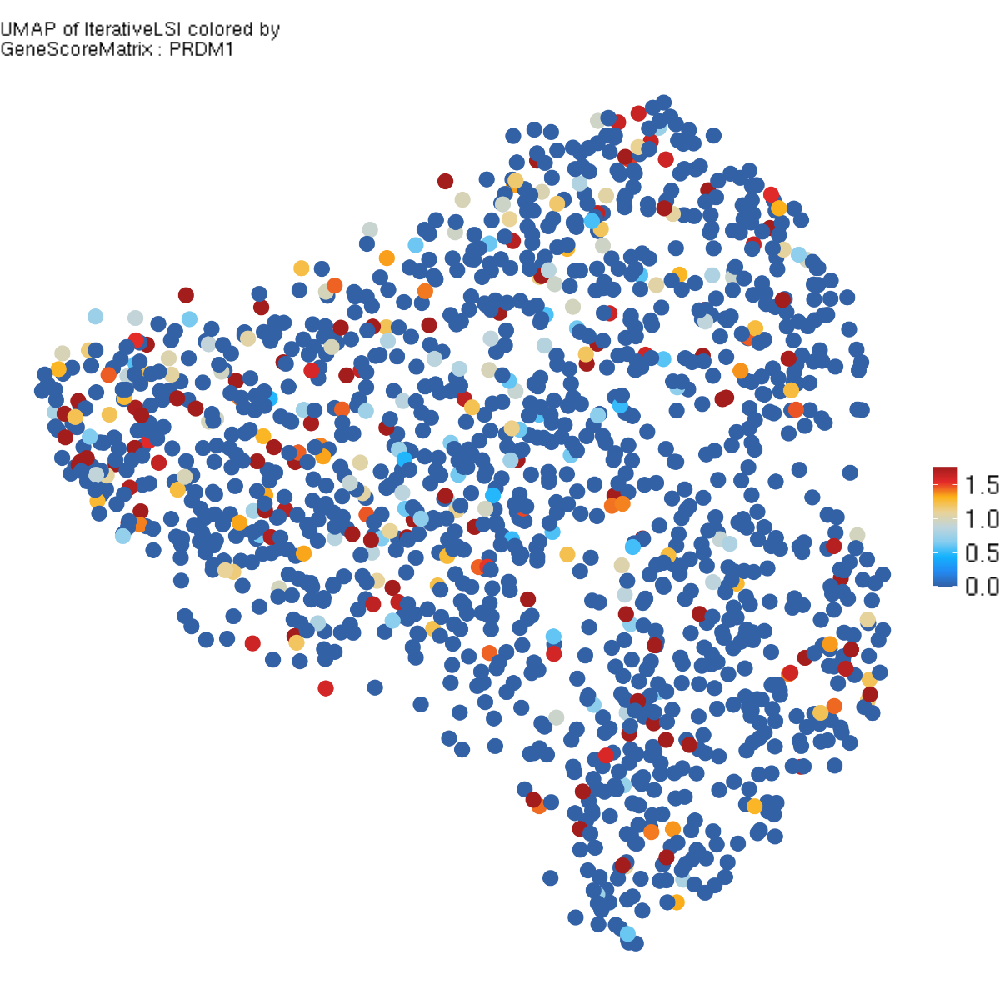

In [22]:
 plotEmbedding(
        ArchRProj = projB, 
        colorBy = "GeneScoreMatrix", 
        name = 'PRDM1', 
        embedding = "UMAP",
        quantCut = c(0.01, 0.95),
        size =3, 
        pal= paletteContinuous(), 
        plotAs= "points", 
        imputeWeights = NULL#getImputeWeights(proj)
)+theme_void()+theme(legend.title=element_blank(), legend.text=element_text(size=18))

In [13]:
#label clusters
remapClust <- c(
    "C6" = "B"
)

projB$Clusters1 = projB$Clusters

projB$Clusters1 = mapLabels(projB$Clusters, newLabels = remapClust, oldLabels = names(remapClust))

In [61]:
#add to data
proj = addCellColData(ArchRProj = proj, 
                           data = paste0(projB$Clusters1),
                           cells = proj[proj$cellNames %in% c(projB$cellNames)]$cellNames, 
                           name = "Clusters_B", 
                          force = TRUE
                          )

Dropping ImputeWeights Since You Are Subsetting Cells! ImputeWeights is a cell-x-cell Matrix!



# Mono alone

In [14]:
projM = proj[(proj$Clusters %in% c('C5'))]
#projM = UMAP_clusters(projM)

In [15]:
projM <- addClusters(input = projM, 
                        method = "Seurat", 
                        name = "Clusters", 
                        reducedDims = "IterativeLSI",  
                        resolution = 0.1, 
                        #maxClusters = 2,
                        verbose = FALSE,
                        force=TRUE
                       )

ArchR logging to : ArchRLogs/ArchR-addClusters-416857b00f6b-Date-2022-10-16_Time-18-06-59.log
If there is an issue, please report to github with logFile!

Overriding previous entry for Clusters



ArchR logging to : ArchRLogs/ArchR-plotEmbedding-416831803ca5-Date-2022-10-16_Time-18-07-02.log
If there is an issue, please report to github with logFile!

Getting UMAP Embedding

ColorBy = cellColData

Plotting Embedding

1 


ArchR logging successful to : ArchRLogs/ArchR-plotEmbedding-416831803ca5-Date-2022-10-16_Time-18-07-02.log



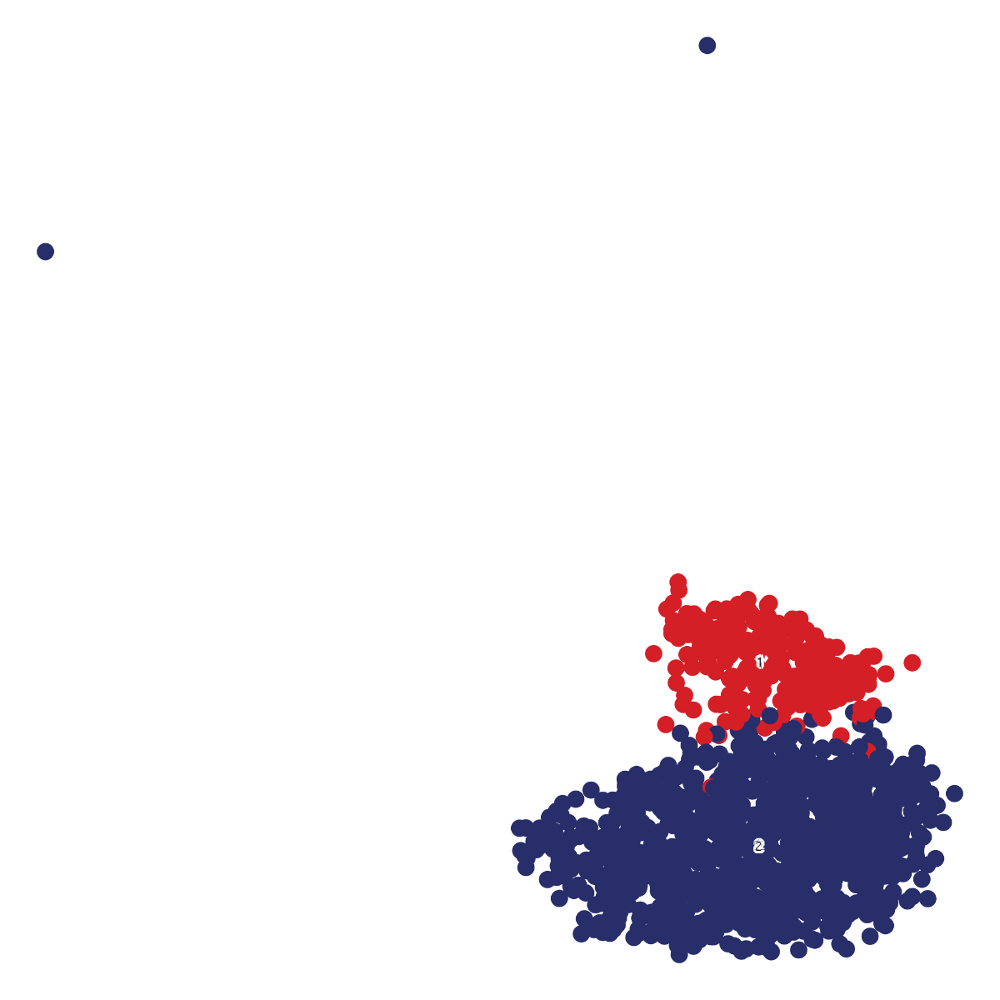

In [16]:
#Visualize clusters
plotEmbedding(ArchRProj = projM, colorBy = "cellColData", 
              name = "Clusters", 
              embedding = "UMAP", 
              size =3, 
              #pal= paletteContinuous(), 
              plotAs= "points", 
              #imputeWeights = getImputeWeights(proj)
             )+theme_void()+theme(plot.title = element_blank())+ NoLegend()

In [72]:
projM <- addGeneScoreMatrix(projM, matrixName='GeneScoreMatrix', force=TRUE, threads =1) 

ArchR logging to : ArchRLogs/ArchR-addGeneScoreMatrix-8764141da809-Date-2022-10-05_Time-22-27-45.log
If there is an issue, please report to github with logFile!

2022-10-05 22:27:45 : Batch Execution w/ safelapply!, 0 mins elapsed.

Can not create group. Object with name 'GeneScoreMatrix' already exists.

DJ_Hs_PBMC_K4me123_ALLSEQ_220523_220527 .addGeneScoreMat useTSS = FALSE

2022-10-05 22:27:46 : Computing Gene Scores using distance relative to GeneBody! , 0.008 mins elapsed.

ArchR logging successful to : ArchRLogs/ArchR-addGeneScoreMatrix-8764141da809-Date-2022-10-05_Time-22-27-45.log



In [42]:
#impute
projM = addImputeWeights(      
ArchRProj = projM,
reducedDims = "IterativeLSI",
dimsToUse = 1:15,
scaleDims = NULL,
corCutOff = 0.75,
td = 3,
ka = 4,
sampleCells = 3000,
nRep = 5,
k = 15,
epsilon = 1,
useHdf5 = TRUE,
randomSuffix = FALSE,
threads = getArchRThreads(),
seed = 1,
verbose = TRUE,
logFile = createLogFile("addImputeWeights")
)

ArchR logging to : ArchRLogs/ArchR-addImputeWeights-57dd2c9c6eef-Date-2022-10-16_Time-13-46-08.log
If there is an issue, please report to github with logFile!

2022-10-16 13:46:08 : Computing Impute Weights Using Magic (Cell 2018), 0 mins elapsed.

Warning message in sprintf("Completed Getting Magic Weights!", round(object.size(weightList)/10^9, :
“one argument not used by format 'Completed Getting Magic Weights!'”


In [74]:
#marker genes
markersGS <- getMarkerFeatures(
ArchRProj = projM, 
useMatrix = "GeneScoreMatrix", 
groupBy = "Clusters",
bias = c("log10(nFrags)"),
testMethod = "wilcoxon"
)

ArchR logging to : ArchRLogs/ArchR-getMarkerFeatures-87646f6df8ae-Date-2022-10-05_Time-22-29-23.log
If there is an issue, please report to github with logFile!

MatrixClass = Sparse.Double.Matrix

2022-10-05 22:29:24 : Matching Known Biases, 0.002 mins elapsed.

###########
2022-10-05 22:29:50 : Completed Pairwise Tests, 0.432 mins elapsed.
###########

ArchR logging successful to : ArchRLogs/ArchR-getMarkerFeatures-87646f6df8ae-Date-2022-10-05_Time-22-29-23.log



Warning message:
“Removed 12 rows containing missing values (geom_point_rast).”


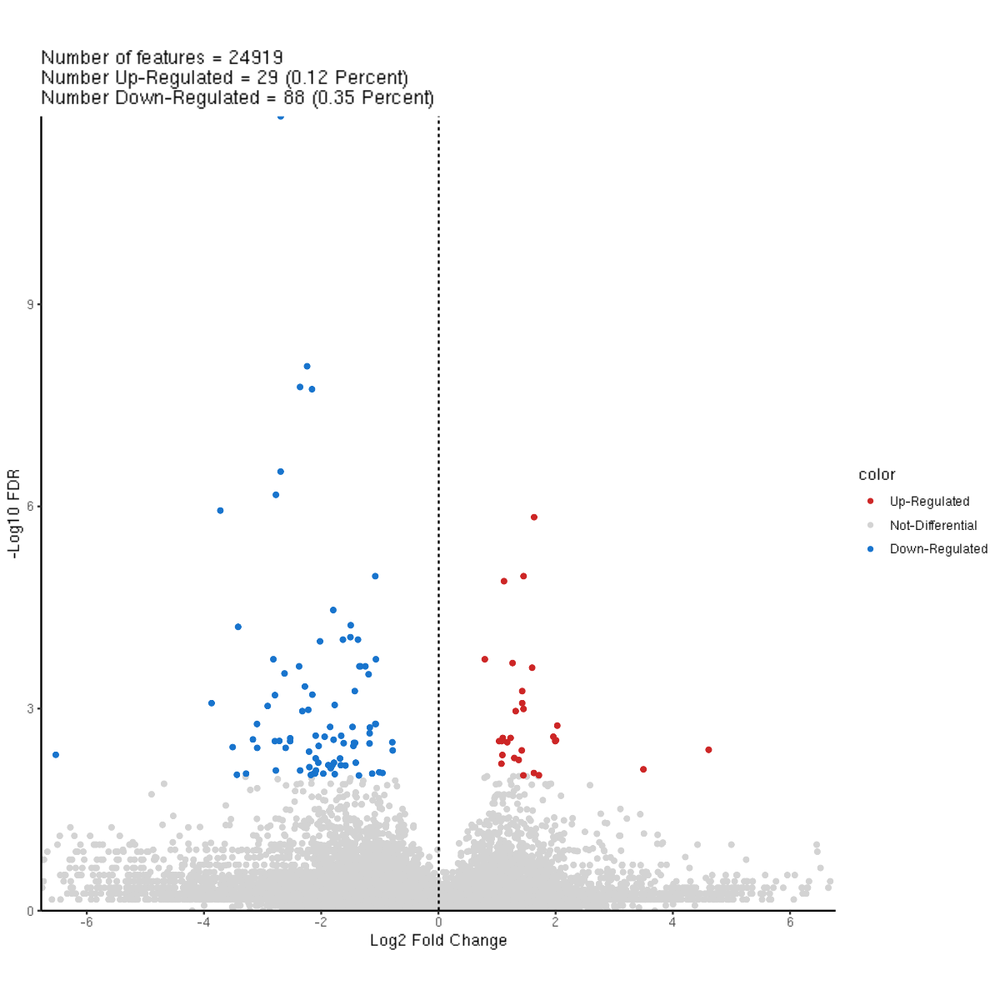

In [75]:
plotMarkers(
  seMarker = markersGS,
  name = 'C1',
  cutOff = "FDR <= 0.01 & abs(Log2FC) >= 0.5",
  plotAs = "Volcano",
  scaleTo = 10^4
)+theme_classic()

In [76]:
markerGenes  <- c(
    "CD34", #Early Progenitor
    "GATA1", #Erythroid
    "PAX5", "MS4A1", "EBF1", "MME", #B-Cell Trajectory
    "CD14", "CEBPB", "MPO", #Monocytes
    "IRF8", 'RUNX1', 'FCGR3A', 'HAVCR2', 'TOX', 'PDCD1',
    "CD3D", "CD8A", "TBX21", "IL7R", #TCells
    'CD163', 'IRAK3', 'FLT3', 'CEBPA', 'NCAM2', 'LEF1', 
    'BACH2', 'PRDM1', 'KLRD1', 'S100A12', 'PTPRC',
    'CCR3', 'CCR5', 'IL17A', 'IL17F', 'IL2RA', 'IL10RA', 'ITGAX', 'CDH5', 'CEACAM4', 'GYPA', 'ENPP2',
    'HLA-DRA', 'HLA-DQB2', 'FCGR2B',
    
    ## CD34 progenitors
    "CD34","CD38","PTPRC", "KIT", "FLT3", "HMGB3", "IL3RA", "IL7R", "MME", "CD27", "BCR", "ABL1",
    ## CD33 myeloid progenitors
    "CD34", "CD33","KIT","CD68", "NECTIN2", "FLT3", "CSF3R",
    ## B-cells
    "CD19", "MS4A1", "HLA-DRB1", "FCGR3A", "CD27", "IGheavy1", "CD9", "CD58", "PRDM2",
    ## Plasma Cells
    "ENPP1", "CD38", "SDC1", "CD27",
    ## T-cells
    "CD2", "CD3D", "NCAM1", "IL2RA", "CD69", "CD5", "CD4", "CD8A", "CD40LG",           
    "CD4", "CD8A","IL7R", "CCR7", "TCF7", "GZMK", "CTLA4", "TIGIT", "TBX21", "GATA3", "RORA", "FOXP3",
    ## NK-cells
    "CD3D", "NCAM1", "FCGR3A",
    ## dendritic cells
    "CD1C", "CD83", "THBD", "CD209", "HLA-DRB1", "ITGAX", "IL3RA", "CLEC4C", "NRP1",
    ## platelets, should be no platelets 
    "GP1BA", "SELP",
    ## Macrophages
    "ITGAM", "CD68", "CD163", "ANPEP",
    ## Monocytes
    "CD14", "FCGR3A", "FCGR1A",
    ## Red Blood Cells and erythroblast
    "ST6GALNAC1", "TFRC", "SLC4A1", "GYPA", "GYPB", "RHD", "RHCE", "RHAG", "HBB",
    ## Neutrophiles
    "FUT4", "FCGR3A", "CEACAM8", "CEACAM3",
    ## Basophils/Eosinophils
    "IL3RA", "ENPP3", "FCER1A", "ITGAM", "CCR3", "ADGRE1", "SIGLEC8",
    ##Endothelial
    "CD36", "CD93", "PECAM1", "VCAM1", "CDH5", "ESAM"
  )

ArchR logging to : ArchRLogs/ArchR-plotMarkerHeatmap-876457c80551-Date-2022-10-05_Time-22-29-54.log
If there is an issue, please report to github with logFile!

Printing Top Marker Genes:

C1:

	SRGAP2B, FAM72D, SRGAP2, MRVI1, LMO2, NRXN2, PHETA1, SLC7A7, SLC24A4, LILRB2, MIR4752, LILRA5, SLC8A1, SIRPA, LINC00656

C8:

	MDS2, SSBP3, CD247, KLF12, DAD1, BCL11B, RORA, CCR7, SMARCE1, MAL, NCK2, EDAR, PLCG1, UBASH3A, FHIT

Identified 55 markers!



 [1] "SRGAP2B"   "FAM72D"    "SRGAP2"    "MRVI1"     "LMO2"      "NRXN2"    
 [7] "PHETA1"    "SLC7A7"    "SLC24A4"   "LILRB2"    "MIR4752"   "LILRA5"   
[13] "SLC8A1"    "SIRPA"     "LINC00656" "MDS2"      "SSBP3"     "CD247"    
[19] "KLF12"     "DAD1"      "BCL11B"    "RORA"      "CCR7"      "SMARCE1"  
[25] "MAL"       "NCK2"      "EDAR"      "PLCG1"     "UBASH3A"   "FHIT"     


Preparing Main Heatmap..

ArchR logging successful to : ArchRLogs/ArchR-plotMarkerHeatmap-876457c80551-Date-2022-10-05_Time-22-29-54.log



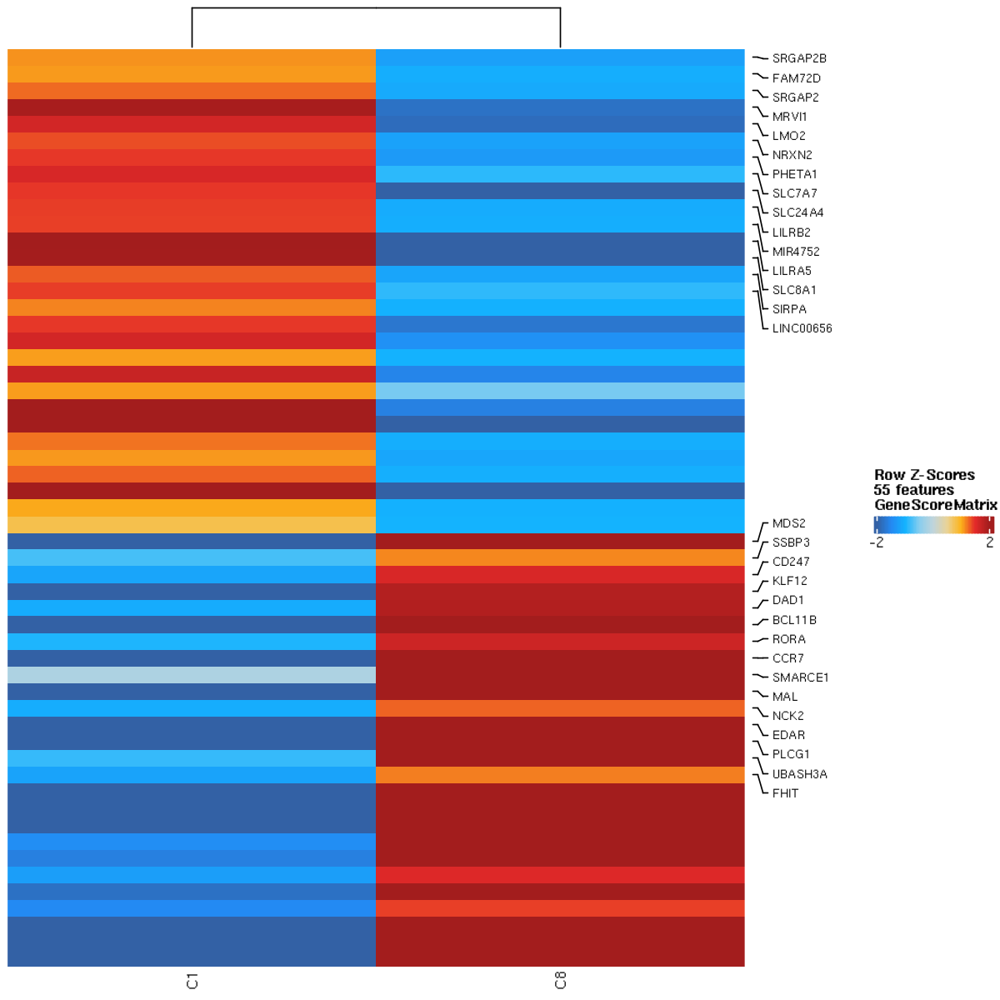

In [77]:
plotMarkerHeatmap(
  seMarker = markersGS,
  cutOff = "FDR <= 0.01 & Log2FC >= 0.5",
  log2Norm = TRUE,
  scaleTo = 10^4,
  scaleRows = TRUE,
  plotLog2FC = TRUE,
  limits = c(-2, 2),
  grepExclude = NULL,
  pal = paletteContinuous(),
  binaryClusterRows = TRUE,
  clusterCols = TRUE,
  #labelMarkers = markerGenes,
  nLabel = 15,
  nPrint = 15,
  labelRows = FALSE,
  returnMatrix = FALSE,
  transpose = FALSE,
  invert = FALSE,
  logFile = createLogFile("plotMarkerHeatmap")
)

ArchR logging to : ArchRLogs/ArchR-plotMarkerHeatmap-87643d7f603a-Date-2022-10-05_Time-22-29-56.log
If there is an issue, please report to github with logFile!

Printing Top Marker Genes:

C1:

	CLSTN1, MDS2, LCK, SSBP3, SSBP3-AS1, CD247, WNT9A, GATA3

C8:

	FAM72C, SRGAP2B, LMO2, SLC24A4, SLC8A1, AFF3, MAFB, SMIM25

Identified 99 markers!



 [1] "CLSTN1"    "MDS2"      "LCK"       "SSBP3"     "SSBP3-AS1" "CD247"    
 [7] "WNT9A"     "GATA3"     "FAM72C"    "SRGAP2B"   "LMO2"      "SLC24A4"  
[13] "SLC8A1"    "AFF3"      "MAFB"      "SMIM25"   


Preparing Main Heatmap..

ArchR logging successful to : ArchRLogs/ArchR-plotMarkerHeatmap-87643d7f603a-Date-2022-10-05_Time-22-29-56.log



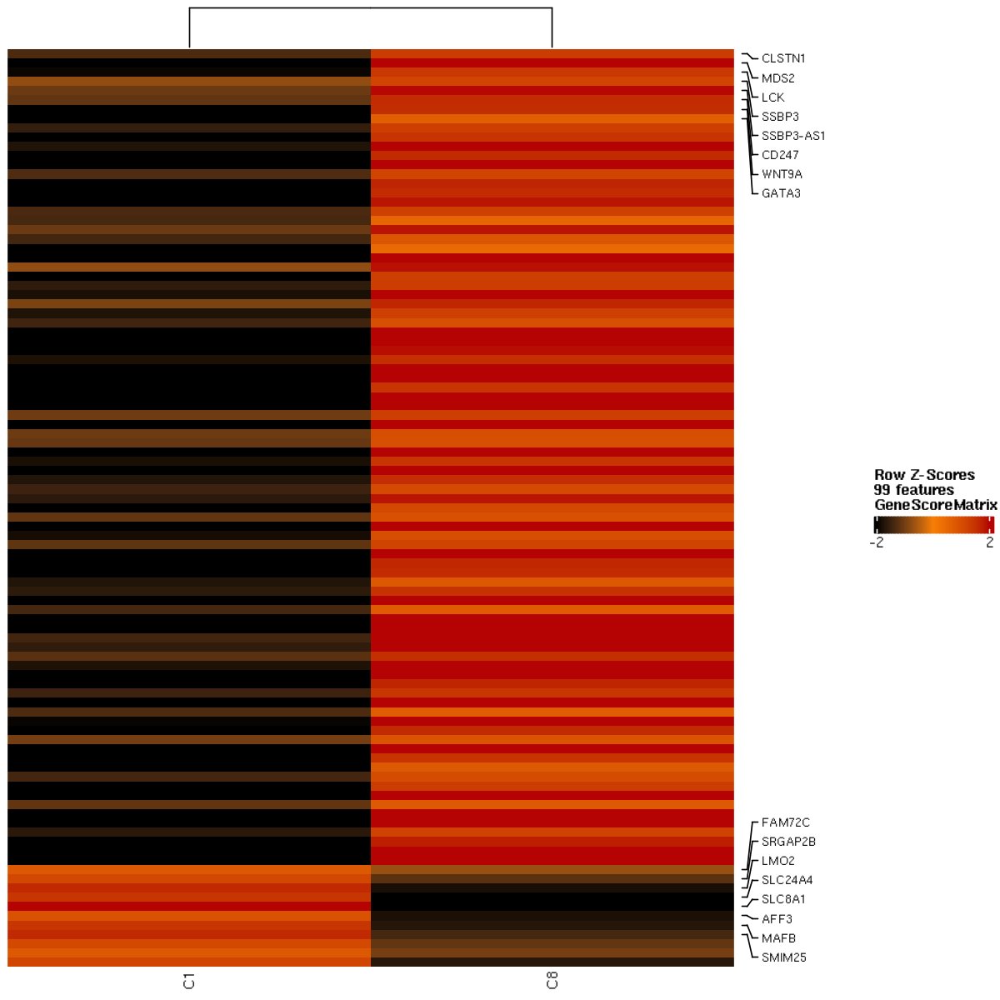

In [78]:
plotMarkerHeatmap(
  seMarker = markersGS,
  cutOff = "FDR <= 0.01 & Log2FC <= -0.5",
  log2Norm = TRUE,
  scaleTo = 10^4,
  scaleRows = TRUE,
  plotLog2FC = TRUE,
  limits = c(-2, 2),
  grepExclude = NULL,
  pal = c("3"="black","2"="#f77e05", "1"="#b50202"),
  binaryClusterRows = TRUE,
  clusterCols = TRUE,
  #labelMarkers = markerGenes,
  nLabel = 8,
  nPrint = 8,
  labelRows = FALSE,
  returnMatrix = FALSE,
  transpose = FALSE,
  invert = FALSE,
  logFile = createLogFile("plotMarkerHeatmap")
)

Getting ImputeWeights

No imputeWeights found, returning NULL

ArchR logging to : ArchRLogs/ArchR-plotEmbedding-4168d62d24b-Date-2022-10-16_Time-18-08-11.log
If there is an issue, please report to github with logFile!

Getting UMAP Embedding

ColorBy = GeneScoreMatrix

Getting Matrix Values...

2022-10-16 18:08:12 : 

1 


Plotting Embedding

1 


ArchR logging successful to : ArchRLogs/ArchR-plotEmbedding-4168d62d24b-Date-2022-10-16_Time-18-08-11.log



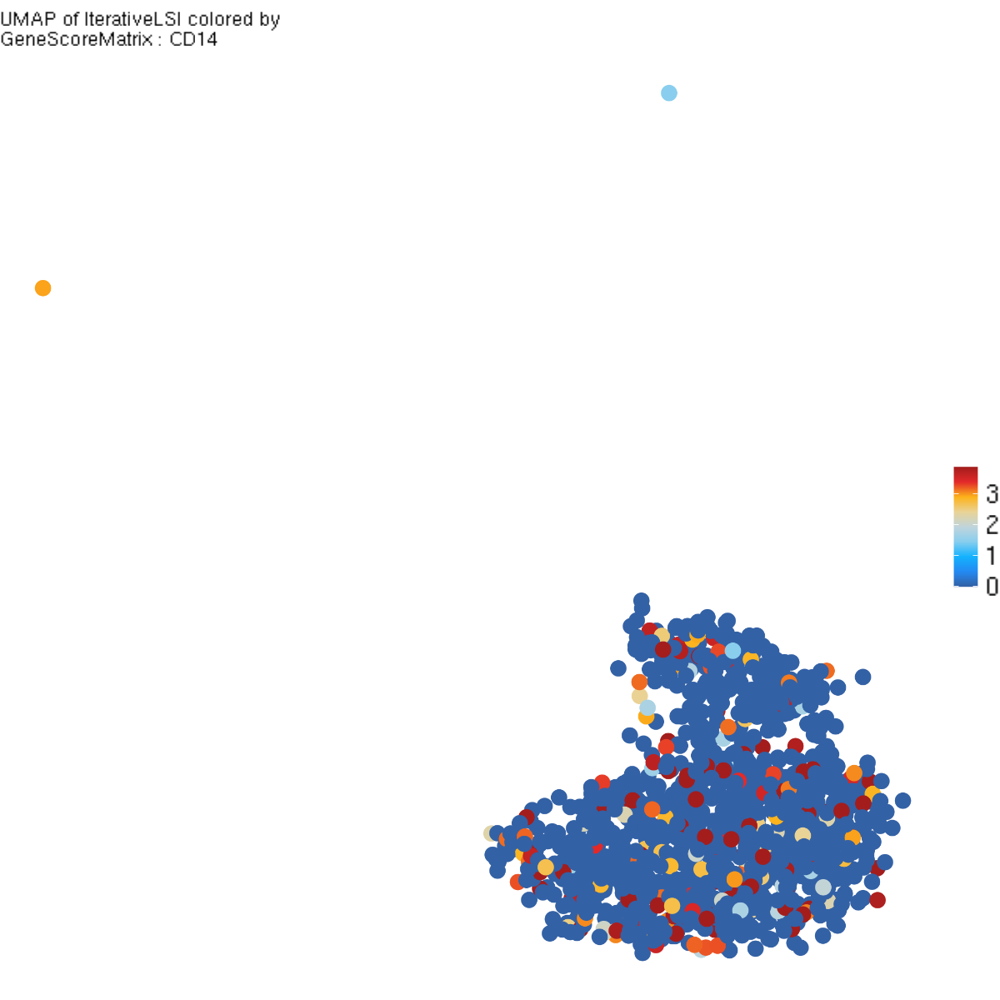

In [17]:
 plotEmbedding(
        ArchRProj = projM, 
        colorBy = "GeneScoreMatrix", 
        name = 'CD14', 
        embedding = "UMAP",
        quantCut = c(0.01, 0.95),
        size =3, 
        pal= paletteContinuous(), 
        plotAs= "points", 
        imputeWeights = getImputeWeights(projM)
)+theme_void()+theme(legend.title=element_blank(), legend.text=element_text(size=18))

ArchR logging to : ArchRLogs/ArchR-plotEmbedding-57dd252c3955-Date-2022-10-16_Time-13-46-30.log
If there is an issue, please report to github with logFile!

Getting UMAP Embedding

ColorBy = GeneScoreMatrix

Getting Matrix Values...

2022-10-16 13:46:30 : 

1 


Plotting Embedding

1 


ArchR logging successful to : ArchRLogs/ArchR-plotEmbedding-57dd252c3955-Date-2022-10-16_Time-13-46-30.log



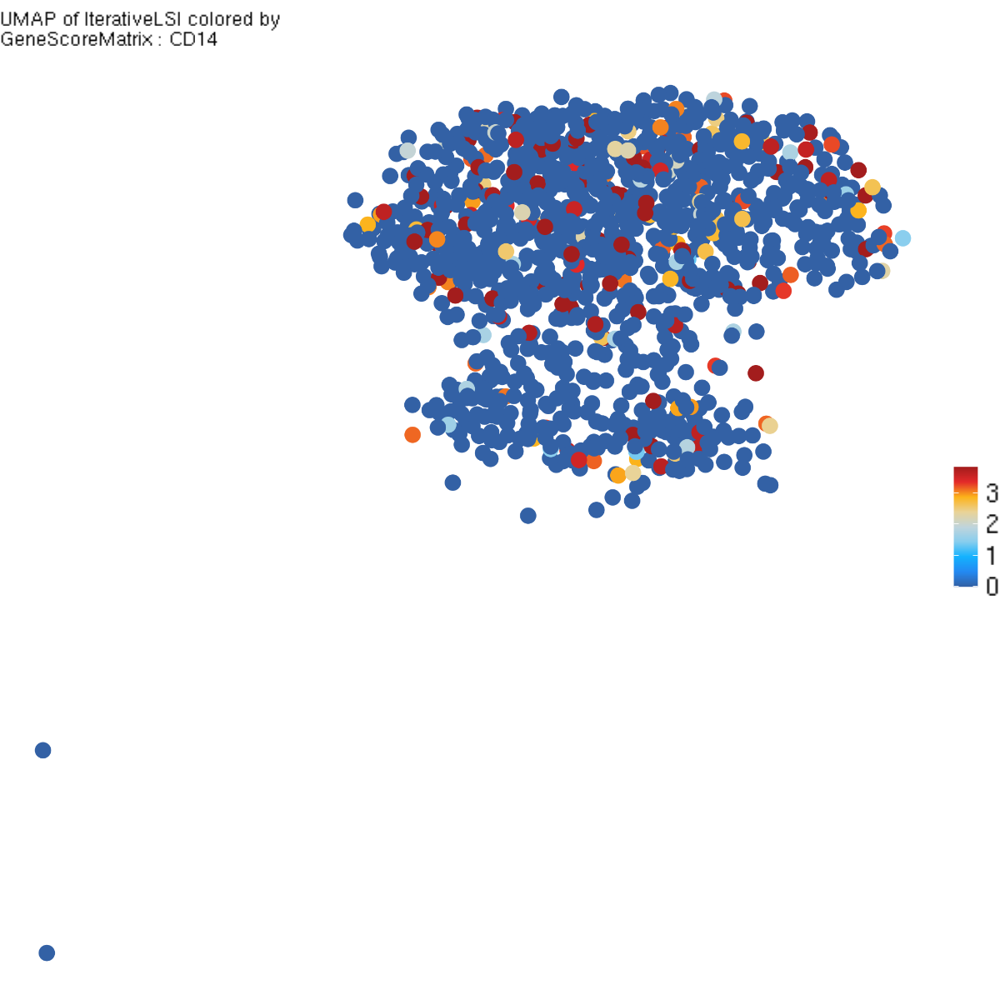

In [44]:
 plotEmbedding(
        ArchRProj = projM, 
        colorBy = "GeneScoreMatrix", 
        name = 'CD14', 
        embedding = "UMAP",
        quantCut = c(0.01, 0.95),
        size =3, 
        pal= paletteContinuous(), 
        plotAs= "points", 
        imputeWeights = NULL #getImputeWeights(projM)
)+theme_void()+theme(legend.title=element_blank(), legend.text=element_text(size=18))

In [18]:
#label clusters
remapClust <- c(
    "C2" = "CD14 Mono",
    "C1" = "CD16 Mono"
)

projM$Clusters1 = projM$Clusters

projM$Clusters1 = mapLabels(projM$Clusters, newLabels = remapClust, oldLabels = names(remapClust))

In [82]:
#add to data
proj = addCellColData(ArchRProj = proj, 
                           data = paste0(projM$Clusters1),
                           cells = proj[proj$cellNames %in% c(projM$cellNames)]$cellNames, 
                           name = "Clusters_M", 
                          force = TRUE
                          )

Dropping ImputeWeights Since You Are Subsetting Cells! ImputeWeights is a cell-x-cell Matrix!



# T alone

In [42]:
projT = proj[(proj$Clusters %in% c('C1','C2','C3', 'C4'))]
#projT = UMAP_clusters(projT)

In [43]:
projT


           ___      .______        ______  __    __  .______      
          /   \     |   _  \      /      ||  |  |  | |   _  \     
         /  ^  \    |  |_)  |    |  ,----'|  |__|  | |  |_)  |    
        /  /_\  \   |      /     |  |     |   __   | |      /     
       /  _____  \  |  |\  \\___ |  `----.|  |  |  | |  |\  \\___.
      /__/     \__\ | _| `._____| \______||__|  |__| | _| `._____|
    



class: ArchRProject 
outputDirectory: /fh/fast/henikoff_s/user/jgreene/projects/sciCnT/data/ArchR/DJ_Hs_PBMC_K4me123_220523_220527_79x79_MERGE_50k/proj_FINAL_v4 
samples(1): DJ_Hs_PBMC_K4me123_ALLSEQ_220523_220527
sampleColData names(1): ArrowFiles
cellColData names(22): Sample TSSEnrichment ... assignment Clusters
numberOfCells(1): 6247
medianTSS(1): 7.404
medianFrags(1): 1266

In [24]:
unique(projT$Clusters)

[1] "C3" "C4" "C2" "C1"

ArchR logging to : ArchRLogs/ArchR-plotEmbedding-416814cd67c7-Date-2022-10-16_Time-18-15-43.log
If there is an issue, please report to github with logFile!

Getting UMAP Embedding

ColorBy = cellColData

Plotting Embedding

1 


ArchR logging successful to : ArchRLogs/ArchR-plotEmbedding-416814cd67c7-Date-2022-10-16_Time-18-15-43.log



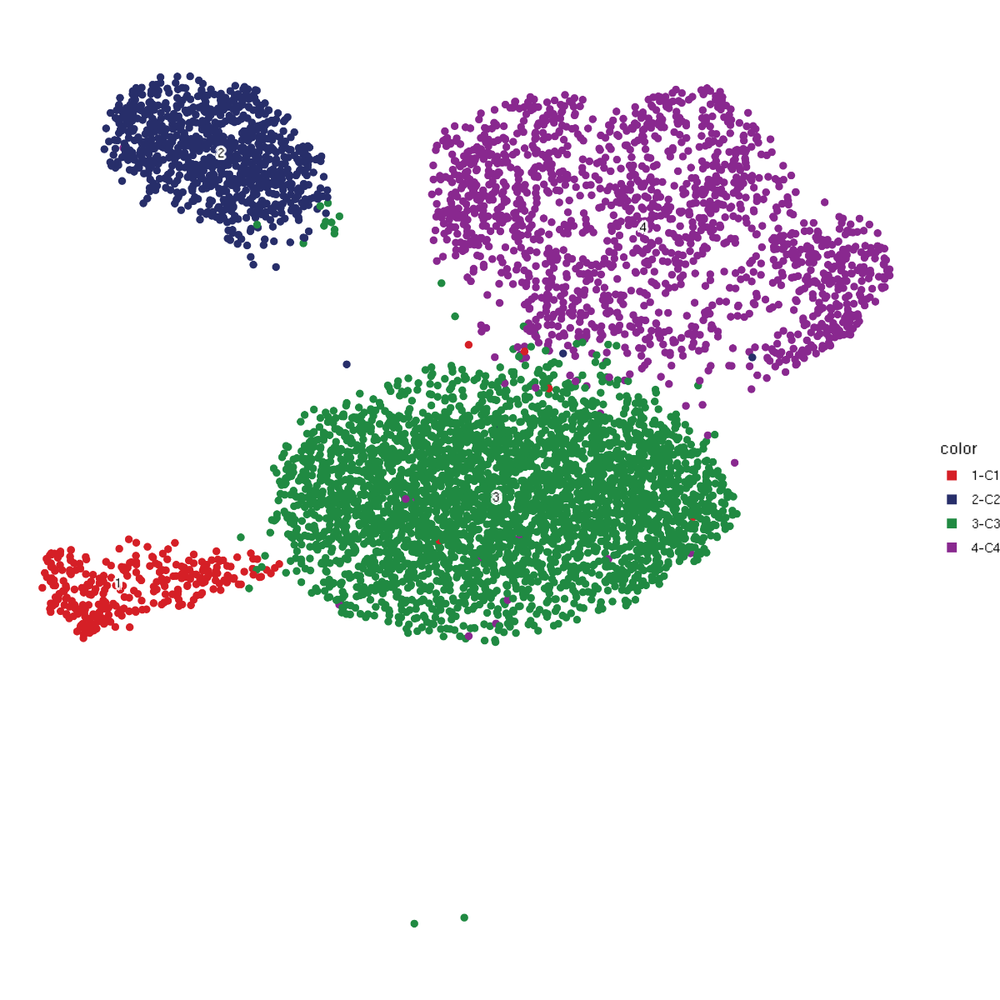

In [44]:
#Visualize clusters
plotEmbedding(ArchRProj = projT, colorBy = "cellColData", 
              name = "Clusters", 
              embedding = "UMAP", 
              size =1, 
              #pal= paletteContinuous(), 
              plotAs= "points", 
              #imputeWeights = getImputeWeights(proj)
             )+theme_void()+theme(plot.title = element_blank())#+ NoLegend()

In [45]:
#remove NK
projNK = projT[(projT$Clusters %in% c('C2'))]
projT = projT[!(projT$Clusters %in% c('C2'))]

#projT = UMAP_clusters(projT)

In [70]:
projT <- addClusters(input = projT, 
                        method = "Seurat", 
                        name = "Clusters", 
                        reducedDims = "IterativeLSI",  
                        resolution = 0.1, 
                        #maxClusters = 2,
                        verbose = FALSE,
                        force=TRUE
                       )

ArchR logging to : ArchRLogs/ArchR-addClusters-57dd43446ee3-Date-2022-10-16_Time-13-51-21.log
If there is an issue, please report to github with logFile!

Overriding previous entry for Clusters



ArchR logging to : ArchRLogs/ArchR-plotEmbedding-41683574d375-Date-2022-10-16_Time-18-16-24.log
If there is an issue, please report to github with logFile!

Getting UMAP Embedding

ColorBy = cellColData

Plotting Embedding

1 


ArchR logging successful to : ArchRLogs/ArchR-plotEmbedding-41683574d375-Date-2022-10-16_Time-18-16-24.log



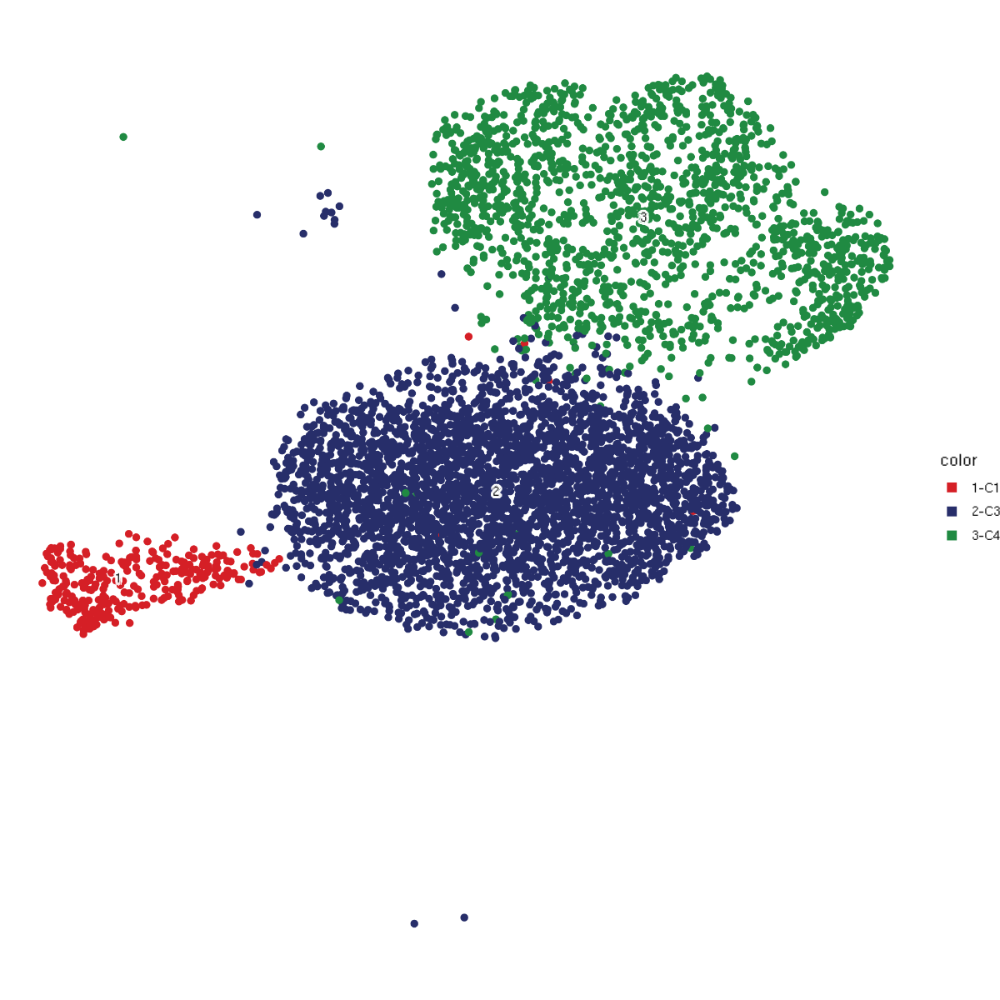

In [46]:
#Visualize clusters
plotEmbedding(ArchRProj = projT, colorBy = "cellColData", 
              name = "Clusters", 
              embedding = "UMAP", 
              size =1, 
              #pal= paletteContinuous(), 
              plotAs= "points", 
              #imputeWeights = getImputeWeights(proj)
             )+theme_void()+theme(plot.title = element_blank())#+ NoLegend()

In [47]:
projT


           ___      .______        ______  __    __  .______      
          /   \     |   _  \      /      ||  |  |  | |   _  \     
         /  ^  \    |  |_)  |    |  ,----'|  |__|  | |  |_)  |    
        /  /_\  \   |      /     |  |     |   __   | |      /     
       /  _____  \  |  |\  \\___ |  `----.|  |  |  | |  |\  \\___.
      /__/     \__\ | _| `._____| \______||__|  |__| | _| `._____|
    



class: ArchRProject 
outputDirectory: /fh/fast/henikoff_s/user/jgreene/projects/sciCnT/data/ArchR/DJ_Hs_PBMC_K4me123_220523_220527_79x79_MERGE_50k/proj_FINAL_v4 
samples(1): DJ_Hs_PBMC_K4me123_ALLSEQ_220523_220527
sampleColData names(1): ArrowFiles
cellColData names(22): Sample TSSEnrichment ... assignment Clusters
numberOfCells(1): 5362
medianTSS(1): 7.2985
medianFrags(1): 1289

In [48]:
mean(projT$nFrags)

[1] 1489.213

In [20]:
projT <- addGeneScoreMatrix(projT, matrixName='GeneScoreMatrix', force=TRUE, threads =1) 

ArchR logging to : ArchRLogs/ArchR-addGeneScoreMatrix-3b867170519e-Date-2022-10-06_Time-12-01-15.log
If there is an issue, please report to github with logFile!

2022-10-06 12:01:15 : Batch Execution w/ safelapply!, 0 mins elapsed.

.createArrowGroup : Arrow Group already exists! Dropping Group from ArrowFile! This will take ~10-30 seconds!

.dropGroupsFromArrow : Initializing Temp ArrowFile

.dropGroupsFromArrow : Adding Metadata to Temp ArrowFile

.dropGroupsFromArrow : Adding SubGroups to Temp ArrowFile

.dropGroupsFromArrow : Move Temp ArrowFile to ArrowFile

DJ_Hs_PBMC_K4me123_ALLSEQ_220523_220527 .addGeneScoreMat useTSS = FALSE

2022-10-06 12:01:36 : Computing Gene Scores using distance relative to GeneBody! , 0.35 mins elapsed.

ArchR logging successful to : ArchRLogs/ArchR-addGeneScoreMatrix-3b867170519e-Date-2022-10-06_Time-12-01-15.log



In [72]:
#marker genes
markersGS <- getMarkerFeatures(
ArchRProj = projT, 
useMatrix = "GeneScoreMatrix", 
groupBy = "Clusters",
bias = c("log10(nFrags)"),
testMethod = "wilcoxon"
)

ArchR logging to : ArchRLogs/ArchR-getMarkerFeatures-57ddb2dc528-Date-2022-10-16_Time-13-52-10.log
If there is an issue, please report to github with logFile!

MatrixClass = Sparse.Double.Matrix

2022-10-16 13:52:11 : Matching Known Biases, 0.002 mins elapsed.

###########
2022-10-16 13:52:40 : Completed Pairwise Tests, 0.5 mins elapsed.
###########

ArchR logging successful to : ArchRLogs/ArchR-getMarkerFeatures-57ddb2dc528-Date-2022-10-16_Time-13-52-10.log



In [73]:
markerGenes  <- c(
    "CD34", #Early Progenitor
    "GATA1", #Erythroid
    "PAX5", "MS4A1", "EBF1", "MME", #B-Cell Trajectory
    "CD14", "CEBPB", "MPO", #Monocytes
    "IRF8", 'RUNX1', 'FCGR3A', 'HAVCR2', 'TOX', 'PDCD1',
    "CD3D", "CD8A", "TBX21", "IL7R", #TCells
    'CD163', 'IRAK3', 'FLT3', 'CEBPA', 'NCAM2', 'LEF1', 
    'BACH2', 'PRDM1', 'KLRD1', 'S100A12', 'PTPRC',
    'CCR3', 'CCR5', 'IL17A', 'IL17F', 'IL2RA', 'IL10RA', 'ITGAX', 'CDH5', 'CEACAM4', 'GYPA', 'ENPP2',
    'HLA-DRA', 'HLA-DQB2', 'FCGR2B',
    
    ## CD34 progenitors
    "CD34","CD38","PTPRC", "KIT", "FLT3", "HMGB3", "IL3RA", "IL7R", "MME", "CD27", "BCR", "ABL1",
    ## CD33 myeloid progenitors
   # "CD34", "CD33","KIT","CD68", "NECTIN2", "FLT3", "CSF3R",
    ## B-cells
   # "CD19", "MS4A1", "HLA-DRB1", "FCGR3A", "CD27", "IGheavy1", "CD9", "CD58", "PRDM2",
    ## Plasma Cells
   # "ENPP1", "CD38", "SDC1", "CD27",
    ## T-cells
    "CD2", "CD3D", "NCAM1", "IL2RA", "CD69", "CD5", "CD4", "CD8A", "CD40LG",           
    "CD4", "CD8A","IL7R", "CCR7", "TCF7", "GZMK", "CTLA4", "TIGIT", "TBX21", "GATA3", "RORA", "FOXP3",
    ## NK-cells
    "CD3D", "NCAM1", "FCGR3A"
    ## dendritic cells
   # "CD1C", "CD83", "THBD", "CD209", "HLA-DRB1", "ITGAX", "IL3RA", "CLEC4C", "NRP1",
    ## platelets, should be no platelets 
    #"GP1BA", "SELP",
    ## Macrophages
    #"ITGAM", "CD68", "CD163", "ANPEP",
    ## Monocytes
    #"CD14", "FCGR3A", "FCGR1A",
    ## Red Blood Cells and erythroblast
    #"ST6GALNAC1", "TFRC", "SLC4A1", "GYPA", "GYPB", "RHD", "RHCE", "RHAG", "HBB",
    ## Neutrophiles
    #"FUT4", "FCGR3A", "CEACAM8", "CEACAM3",
    ## Basophils/Eosinophils
    #"IL3RA", "ENPP3", "FCER1A", "ITGAM", "CCR3", "ADGRE1", "SIGLEC8",
    ##Endothelial
    #"CD36", "CD93", "PECAM1", "VCAM1", "CDH5", "ESAM"
  )

ArchR logging to : ArchRLogs/ArchR-plotMarkerHeatmap-57dd6ac4b6ce-Date-2022-10-16_Time-13-52-41.log
If there is an issue, please report to github with logFile!

Printing Top Marker Genes:

C1:

	NPIPB3, MIR3680-1, NPIPB4, NPIPB5, SMG1P1, NPIPB11, CORO1A, NPIPB13, RNF187, RNA5S1, RNA5S9, RHOU

C2:

	RNF187, RNA5S1, RNA5S9, RHOU, NPIPB3, MIR3680-1, NPIPB4, NPIPB5, SMG1P1, NPIPB11, CORO1A, NPIPB13

C3:

	RNF187, RNA5S1, RNA5S9, RHOU, NPIPB3, MIR3680-1, NPIPB4, NPIPB5, SMG1P1, NPIPB11, CORO1A, NPIPB13

Identified 12 markers!



 [1] "NPIPB3"    "MIR3680-1" "NPIPB4"    "NPIPB5"    "SMG1P1"    "NPIPB11"  
 [7] "CORO1A"    "NPIPB13"   "RNF187"    "RNA5S1"    "RNA5S9"    "RHOU"     


Preparing Main Heatmap..

ArchR logging successful to : ArchRLogs/ArchR-plotMarkerHeatmap-57dd6ac4b6ce-Date-2022-10-16_Time-13-52-41.log



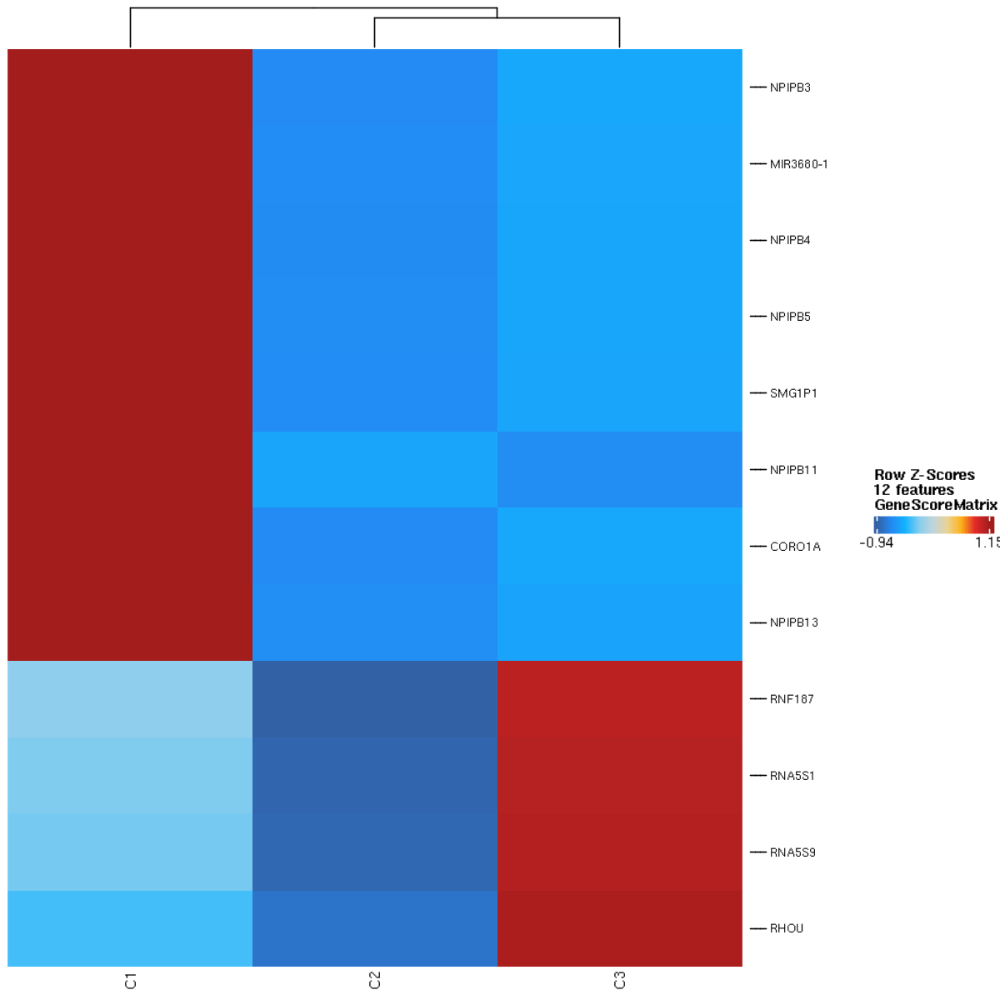

In [74]:
plotMarkerHeatmap(
  seMarker = markersGS,
  cutOff = "FDR <= 0.01 & Log2FC >= 0.5",
  log2Norm = TRUE,
  scaleTo = 10^4,
  scaleRows = TRUE,
  plotLog2FC = FALSE,
  limits = c(-2, 2),
  grepExclude = NULL,
  pal = paletteContinuous(),
  binaryClusterRows = TRUE,
  clusterCols = TRUE,
  #labelMarkers = markerGenes,
  nLabel = 15,
  nPrint = 15,
  labelRows = FALSE,
  returnMatrix = FALSE,
  transpose = FALSE,
  invert = FALSE,
  logFile = createLogFile("plotMarkerHeatmap")
)

ArchR logging to : ArchRLogs/ArchR-plotMarkerHeatmap-57dd6d04b9a4-Date-2022-10-16_Time-13-52-44.log
If there is an issue, please report to github with logFile!

Printing Top Marker Genes:

C1:

	RNF187, RNA5S1, RNA5S9, RHOU, NPIPB3, NPIPB4, NPIPB5, SMG1P1

C2:

	RNF187, RNA5S1, RNA5S9, RHOU, NPIPB3, NPIPB4, NPIPB5, SMG1P1

C3:

	RNF187, RNA5S1, RNA5S9, RHOU, NPIPB3, NPIPB4, NPIPB5, SMG1P1

Identified 8 markers!



[1] "RNF187" "RNA5S1" "RNA5S9" "RHOU"   "NPIPB3" "NPIPB4" "NPIPB5" "SMG1P1"


Preparing Main Heatmap..

ArchR logging successful to : ArchRLogs/ArchR-plotMarkerHeatmap-57dd6d04b9a4-Date-2022-10-16_Time-13-52-44.log



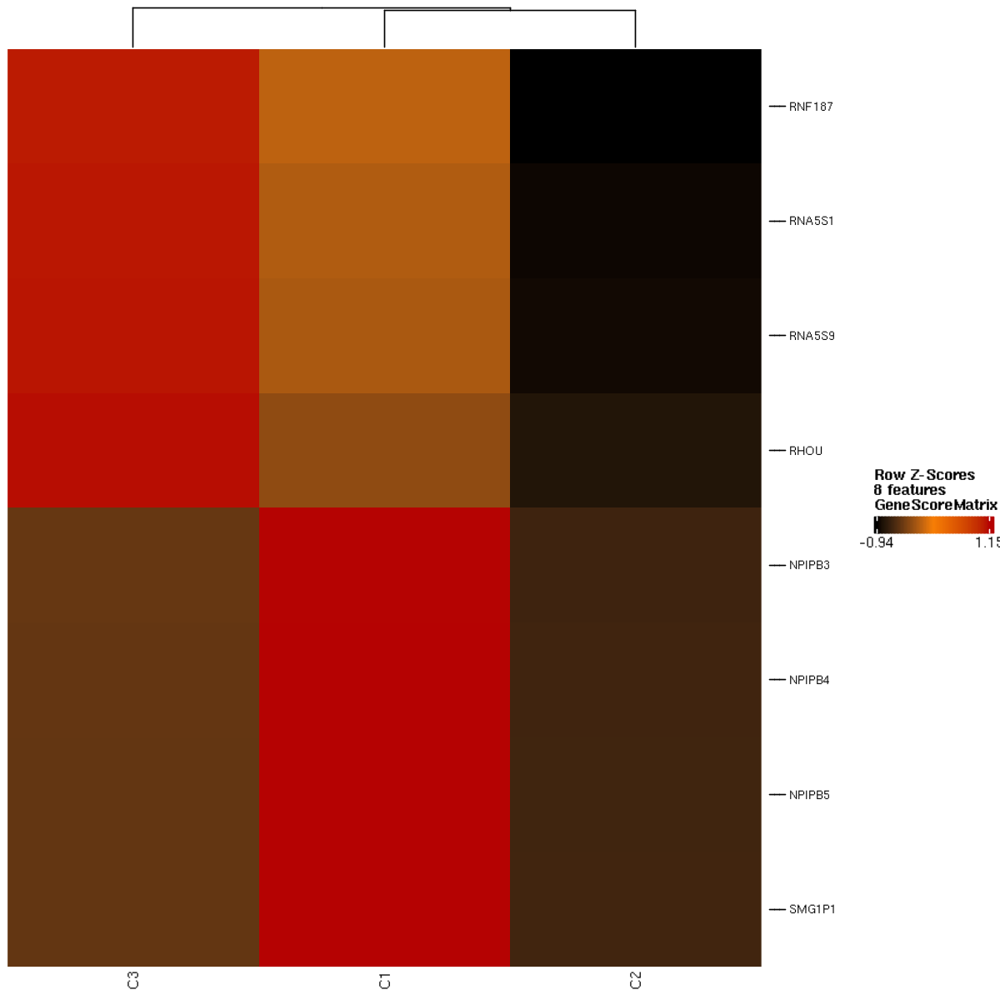

In [75]:
plotMarkerHeatmap(
  seMarker = markersGS,
  cutOff = "FDR <= 0.01 & Log2FC <= -0.5",
  log2Norm = TRUE,
  scaleTo = 10^4,
  scaleRows = TRUE,
  plotLog2FC = FALSE,
  limits = c(-2, 2),
  grepExclude = NULL,
  pal = c("3"="black","2"="#f77e05", "1"="#b50202"),
  binaryClusterRows = TRUE,
  clusterCols = TRUE,
  #labelMarkers = markerGenes,
  nLabel = 15,
  nPrint = 15,
  labelRows = FALSE,
  returnMatrix = FALSE,
  transpose = FALSE,
  invert = FALSE,
  logFile = createLogFile("plotMarkerHeatmap")
)

ArchR logging to : ArchRLogs/ArchR-plotEmbedding-57dd67766696-Date-2022-10-16_Time-13-53-53.log
If there is an issue, please report to github with logFile!

Getting UMAP Embedding

ColorBy = GeneScoreMatrix

Getting Matrix Values...

2022-10-16 13:53:53 : 

1 


Plotting Embedding

1 


ArchR logging successful to : ArchRLogs/ArchR-plotEmbedding-57dd67766696-Date-2022-10-16_Time-13-53-53.log



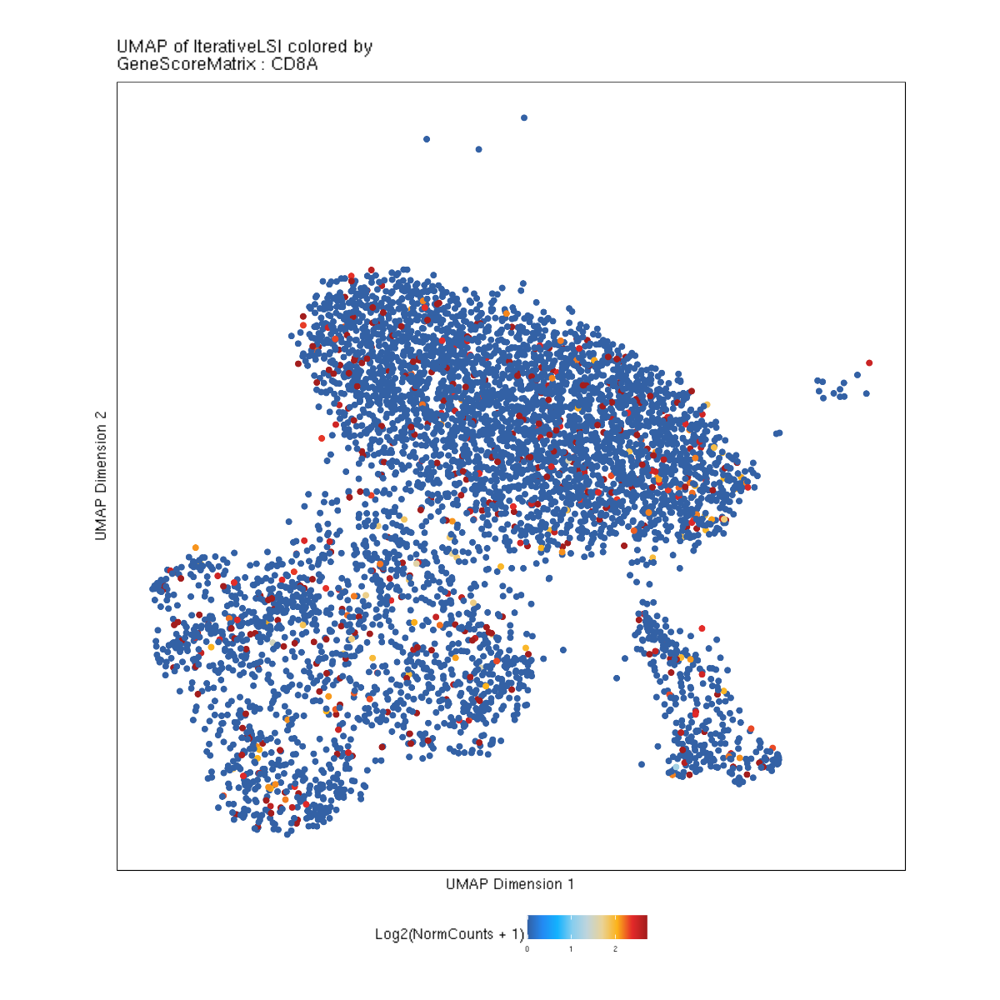

In [78]:
 plotEmbedding(
        ArchRProj = projT, 
        colorBy = "GeneScoreMatrix", 
        name = 'CD8A', 
        embedding = "UMAP",
        quantCut = c(0.01, 0.95),
        size =1, 
        pal= paletteContinuous(), 
        plotAs= "points", 
        imputeWeights = NULL#getImputeWeights(projT)
)#+theme_void()+theme(legend.title=element_blank(), legend.text=element_text(size=18))

In [91]:
unique(projT$Clusters)

[1] "C6" "C4" "C5" "C7" "C8" "C2" "C9" "C1" "C3"

In [49]:
#label clusters
remapClust <- c(
    "C1" = "T Mem 1",
    "C3" = "T Naive", 
    "C4" = "T Mem 2"
)

projT$Clusters1 = projT$Clusters

projT$Clusters1 = mapLabels(projT$Clusters, newLabels = remapClust, oldLabels = names(remapClust))

In [93]:
#add to data
proj = addCellColData(ArchRProj = proj, 
                           data = paste0(projT$Clusters1),
                           cells = proj[proj$cellNames %in% c(projT$cellNames)]$cellNames, 
                           name = "Clusters_T", 
                          force = TRUE
                          )

Dropping ImputeWeights Since You Are Subsetting Cells! ImputeWeights is a cell-x-cell Matrix!

Overriding previous entry for Clusters_T



# NK alone

ArchR logging to : ArchRLogs/ArchR-plotEmbedding-41683faa6e7a-Date-2022-10-16_Time-18-17-38.log
If there is an issue, please report to github with logFile!

Getting UMAP Embedding

ColorBy = cellColData

Plotting Embedding

1 


ArchR logging successful to : ArchRLogs/ArchR-plotEmbedding-41683faa6e7a-Date-2022-10-16_Time-18-17-38.log



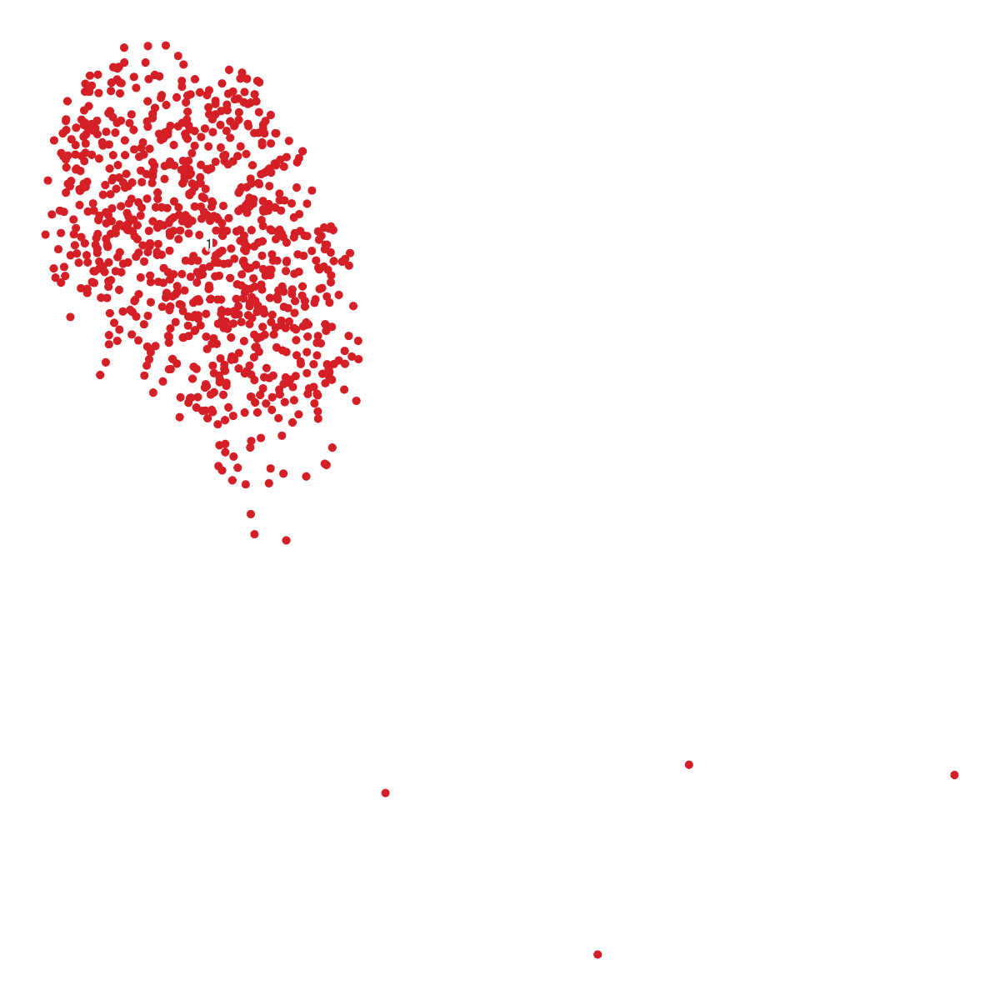

In [50]:
#Visualize clusters
plotEmbedding(ArchRProj = projNK, colorBy = "cellColData", 
              name = "Clusters", 
              embedding = "UMAP", 
              size =1, 
              #pal= paletteContinuous(), 
              plotAs= "points", 
              #imputeWeights = getImputeWeights(proj)
             )+theme_void()+theme(plot.title = element_blank())+ NoLegend()

In [51]:
unique(projNK$Clusters)

[1] "C2"

In [64]:
projNK


           ___      .______        ______  __    __  .______      
          /   \     |   _  \      /      ||  |  |  | |   _  \     
         /  ^  \    |  |_)  |    |  ,----'|  |__|  | |  |_)  |    
        /  /_\  \   |      /     |  |     |   __   | |      /     
       /  _____  \  |  |\  \\___ |  `----.|  |  |  | |  |\  \\___.
      /__/     \__\ | _| `._____| \______||__|  |__| | _| `._____|
    



class: ArchRProject 
outputDirectory: /fh/fast/henikoff_s/user/jgreene/projects/sciCnT/data/ArchR/DJ_Hs_PBMC_K27me3_220523_220527_79x79_MERGE_50k/proj_FINAL 
samples(1): DJ_Hs_PBMC_K27me3_ALLSEQ_220523_220527
sampleColData names(1): ArrowFiles
cellColData names(19): Sample TSSEnrichment ... Clusters_M Clusters_T
numberOfCells(1): 1511
medianTSS(1): 1.42
medianFrags(1): 2571

In [65]:
mean(projNK$nFrags)

[1] 2960.494

In [66]:
projNK <- addGeneScoreMatrix(projNK, matrixName='GeneScoreMatrix', force=TRUE) 

ArchR logging to : ArchRLogs/ArchR-addGeneScoreMatrix-5a195494b10f-Date-2022-10-04_Time-18-59-01.log
If there is an issue, please report to github with logFile!

2022-10-04 18:59:01 : Batch Execution w/ safelapply!, 0 mins elapsed.

.createArrowGroup : Arrow Group already exists! Dropping Group from ArrowFile! This will take ~10-30 seconds!

.dropGroupsFromArrow : Initializing Temp ArrowFile

.dropGroupsFromArrow : Adding Metadata to Temp ArrowFile

.dropGroupsFromArrow : Adding SubGroups to Temp ArrowFile

.dropGroupsFromArrow : Move Temp ArrowFile to ArrowFile

DJ_Hs_PBMC_K27me3_ALLSEQ_220523_220527 .addGeneScoreMat useTSS = FALSE

2022-10-04 18:59:12 : Computing Gene Scores using distance relative to GeneBody! , 0.179 mins elapsed.

ArchR logging successful to : ArchRLogs/ArchR-addGeneScoreMatrix-5a195494b10f-Date-2022-10-04_Time-18-59-01.log



In [67]:
#impute
projNK = addImputeWeights(      
ArchRProj = projNK,
reducedDims = "IterativeLSI",
dimsToUse = 1:15,
scaleDims = NULL,
corCutOff = 0.75,
td = 3,
ka = 4,
sampleCells = 3000,
nRep = 5,
k = 15,
epsilon = 1,
useHdf5 = TRUE,
randomSuffix = FALSE,
threads = getArchRThreads(),
seed = 1,
verbose = TRUE,
logFile = createLogFile("addImputeWeights")
)

ArchR logging to : ArchRLogs/ArchR-addImputeWeights-5a195f7f8446-Date-2022-10-04_Time-18-59-48.log
If there is an issue, please report to github with logFile!

2022-10-04 18:59:48 : Computing Impute Weights Using Magic (Cell 2018), 0 mins elapsed.

Warning message in sprintf("Completed Getting Magic Weights!", round(object.size(weightList)/10^9, :
“one argument not used by format 'Completed Getting Magic Weights!'”


In [68]:
#marker genes
markersGS <- getMarkerFeatures(
ArchRProj = projNK, 
useMatrix = "GeneScoreMatrix", 
groupBy = "Clusters",
bias = c("log10(nFrags)"),
testMethod = "wilcoxon"
)

ArchR logging to : ArchRLogs/ArchR-getMarkerFeatures-5a197d7e9d3e-Date-2022-10-04_Time-18-59-50.log
If there is an issue, please report to github with logFile!

MatrixClass = Sparse.Double.Matrix

2022-10-04 18:59:50 : Matching Known Biases, 0.002 mins elapsed.

2022-10-04 18:59:51 : Computing Pairwise Tests (1 of 1), 0.018 mins elapsed.

Pairwise Test C6 : Seqnames chr1

Pairwise Test C6 : Seqnames chr10

Pairwise Test C6 : Seqnames chr11

Pairwise Test C6 : Seqnames chr12

Pairwise Test C6 : Seqnames chr13

Pairwise Test C6 : Seqnames chr14

Pairwise Test C6 : Seqnames chr15

Pairwise Test C6 : Seqnames chr16

Pairwise Test C6 : Seqnames chr17

Pairwise Test C6 : Seqnames chr18

Pairwise Test C6 : Seqnames chr19

Pairwise Test C6 : Seqnames chr2

Pairwise Test C6 : Seqnames chr20

Pairwise Test C6 : Seqnames chr21

Pairwise Test C6 : Seqnames chr22

Pairwise Test C6 : Seqnames chr3

Pairwise Test C6 : Seqnames chr4

Pairwise Test C6 : Seqnames chr5

Pairwise Test C6 : Seqnames chr6



In [69]:
markerGenes  <- c(
    "CD34", #Early Progenitor
    "GATA1", #Erythroid
    "PAX5", "MS4A1", "EBF1", "MME", #B-Cell Trajectory
    "CD14", "CEBPB", "MPO", #Monocytes
    "IRF8", 'RUNX1', 'FCGR3A', 'HAVCR2', 'TOX', 'PDCD1',
    "CD3D", "CD8A", "TBX21", "IL7R", #TCells
    'CD163', 'IRAK3', 'FLT3', 'CEBPA', 'NCAM2', 'LEF1', 
    'BACH2', 'PRDM1', 'KLRD1', 'S100A12', 'PTPRC',
    'CCR3', 'CCR5', 'IL17A', 'IL17F', 'IL2RA', 'IL10RA', 'ITGAX', 'CDH5', 'CEACAM4', 'GYPA', 'ENPP2',
    'HLA-DRA', 'HLA-DQB2', 'FCGR2B',
    
    ## CD34 progenitors
    "CD34","CD38","PTPRC", "KIT", "FLT3", "HMGB3", "IL3RA", "IL7R", "MME", "CD27", "BCR", "ABL1",
    ## CD33 myeloid progenitors
   # "CD34", "CD33","KIT","CD68", "NECTIN2", "FLT3", "CSF3R",
    ## B-cells
   # "CD19", "MS4A1", "HLA-DRB1", "FCGR3A", "CD27", "IGheavy1", "CD9", "CD58", "PRDM2",
    ## Plasma Cells
   # "ENPP1", "CD38", "SDC1", "CD27",
    ## T-cells
    "CD2", "CD3D", "NCAM1", "IL2RA", "CD69", "CD5", "CD4", "CD8A", "CD40LG",           
    "CD4", "CD8A","IL7R", "CCR7", "TCF7", "GZMK", "CTLA4", "TIGIT", "TBX21", "GATA3", "RORA", "FOXP3",
    ## NK-cells
    "CD3D", "NCAM1", "FCGR3A"
    ## dendritic cells
   # "CD1C", "CD83", "THBD", "CD209", "HLA-DRB1", "ITGAX", "IL3RA", "CLEC4C", "NRP1",
    ## platelets, should be no platelets 
    #"GP1BA", "SELP",
    ## Macrophages
    #"ITGAM", "CD68", "CD163", "ANPEP",
    ## Monocytes
    #"CD14", "FCGR3A", "FCGR1A",
    ## Red Blood Cells and erythroblast
    #"ST6GALNAC1", "TFRC", "SLC4A1", "GYPA", "GYPB", "RHD", "RHCE", "RHAG", "HBB",
    ## Neutrophiles
    #"FUT4", "FCGR3A", "CEACAM8", "CEACAM3",
    ## Basophils/Eosinophils
    #"IL3RA", "ENPP3", "FCER1A", "ITGAM", "CCR3", "ADGRE1", "SIGLEC8",
    ##Endothelial
    #"CD36", "CD93", "PECAM1", "VCAM1", "CDH5", "ESAM"
  )

ArchR logging to : ArchRLogs/ArchR-plotEmbedding-5a19549d861e-Date-2022-10-04_Time-19-02-04.log
If there is an issue, please report to github with logFile!

Getting UMAP Embedding

ColorBy = GeneScoreMatrix

Getting Matrix Values...

2022-10-04 19:02:04 : 

1 


Plotting Embedding

1 


ArchR logging successful to : ArchRLogs/ArchR-plotEmbedding-5a19549d861e-Date-2022-10-04_Time-19-02-04.log



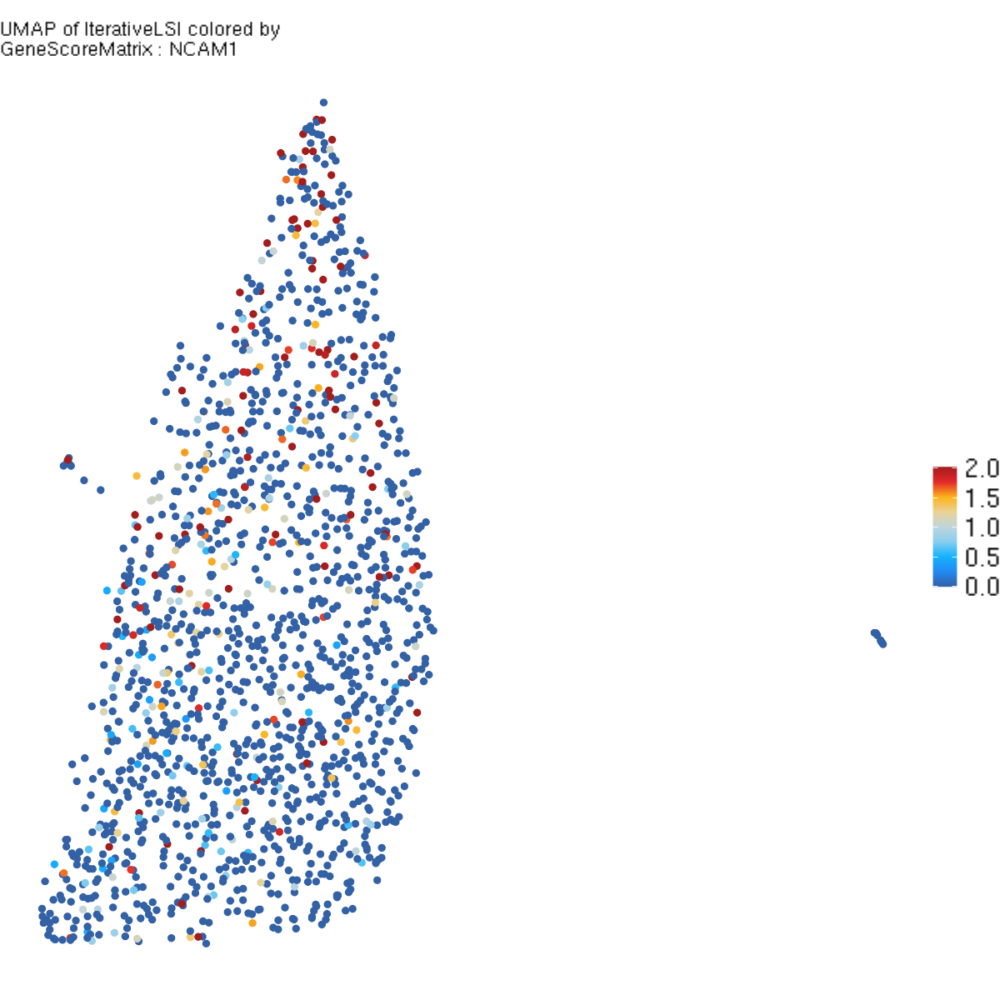

In [74]:
 plotEmbedding(
        ArchRProj = projNK, 
        colorBy = "GeneScoreMatrix", 
        name = 'NCAM1', 
        embedding = "UMAP",
        quantCut = c(0.01, 0.95),
        size =1, 
        pal= paletteContinuous(), 
        plotAs= "points", 
        imputeWeights = NULL#getImputeWeights(projT)
)+theme_void()+theme(legend.title=element_blank(), legend.text=element_text(size=18))

ArchR logging to : ArchRLogs/ArchR-plotEmbedding-5a1913db56f1-Date-2022-10-04_Time-19-02-26.log
If there is an issue, please report to github with logFile!

Getting UMAP Embedding

ColorBy = GeneScoreMatrix

Getting Matrix Values...

2022-10-04 19:02:26 : 

1 


Plotting Embedding

1 


ArchR logging successful to : ArchRLogs/ArchR-plotEmbedding-5a1913db56f1-Date-2022-10-04_Time-19-02-26.log



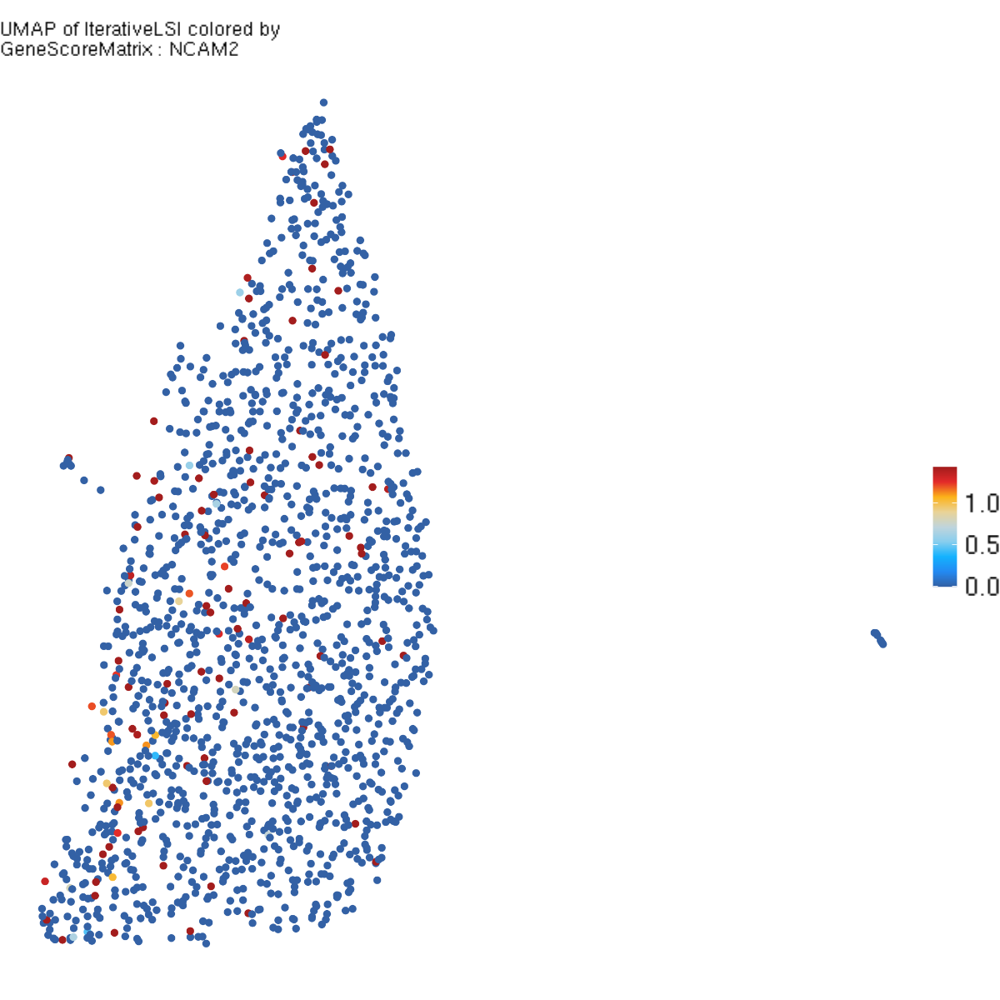

In [76]:
 plotEmbedding(
        ArchRProj = projNK, 
        colorBy = "GeneScoreMatrix", 
        name = 'NCAM2', 
        embedding = "UMAP",
        quantCut = c(0.01, 0.95),
        size =1, 
        pal= paletteContinuous(), 
        plotAs= "points", 
        imputeWeights = NULL#getImputeWeights(projT)
)+theme_void()+theme(legend.title=element_blank(), legend.text=element_text(size=18))

In [52]:
#label clusters
remapClust <- c(
    "C2" = "NK"
)

projNK$Clusters1 = projNK$Clusters

projNK$Clusters1 = mapLabels(projNK$Clusters, newLabels = remapClust, oldLabels = names(remapClust))

In [86]:
#add to data
proj = addCellColData(ArchRProj = proj, 
                           data = paste0(projNK$Clusters1),
                           cells = proj[proj$cellNames %in% c(projNK$cellNames)]$cellNames, 
                           name = "Clusters_NK", 
                          force = TRUE
                          )

Dropping ImputeWeights Since You Are Subsetting Cells! ImputeWeights is a cell-x-cell Matrix!



# Merge

In [53]:
#extract cluster assignments 
Clusters_B = projB$Clusters1
Clusters_M = projM$Clusters1
Clusters_T = projT$Clusters1
Clusters_NK = projNK$Clusters1

#name
names(Clusters_B) = projB$cellNames
names(Clusters_M) = projM$cellNames
names(Clusters_T) = projT$cellNames
names(Clusters_NK) = projNK$cellNames

#cat
Clusters_ALL = data.frame(c(Clusters_B, Clusters_M, Clusters_T, Clusters_NK))
Clusters_ALL[,2] = row.names(Clusters_ALL)

#add func
add_meta = function(proj, meta){

    meta1 = meta[meta[,2] %in% proj$cellNames,]
    meta2 = meta1[match(proj$cellNames, meta1[,2]),]
    proj$annotation = meta2[,1]
    return(proj)
}

#add to all 
proj = add_meta(proj, Clusters_ALL)

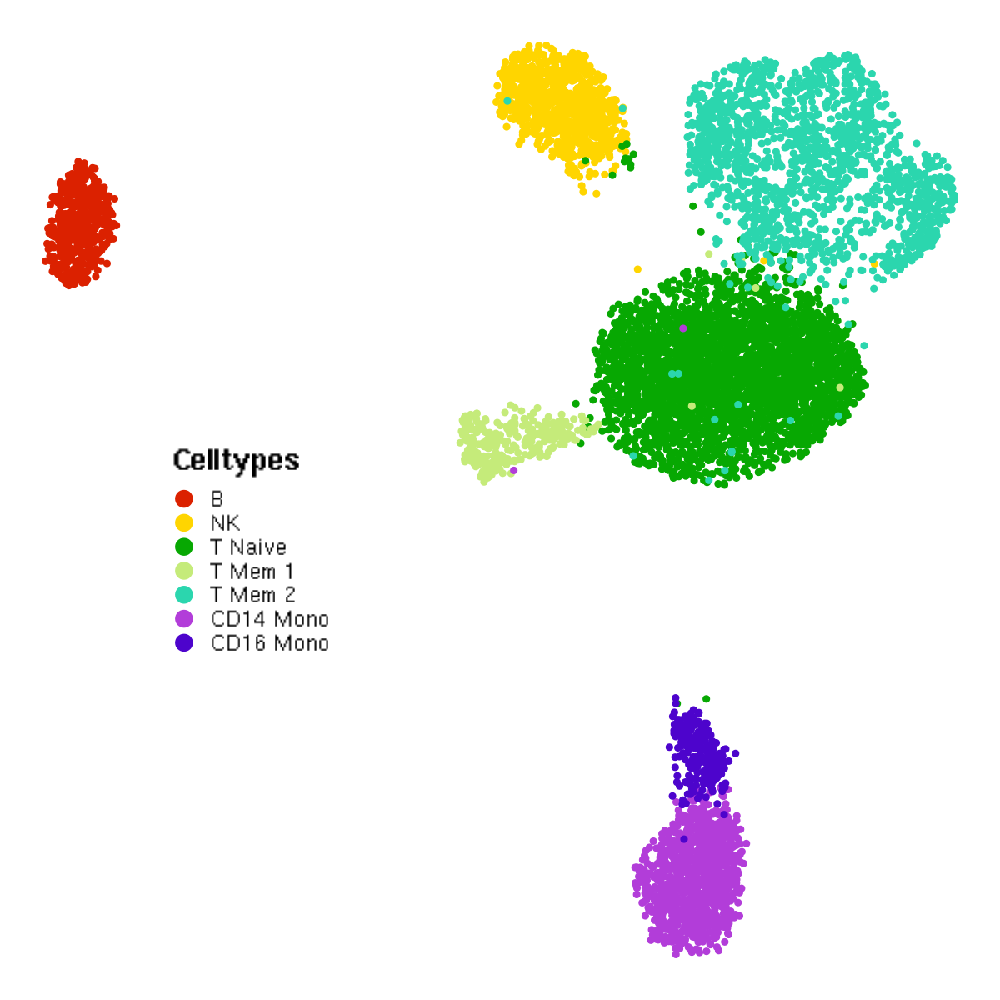

In [62]:
#extract umap
umap_df = proj@cellColData %>% data.frame()
umap_df$UMAP_1 = proj@embeddings$UMAP$df[,1]
umap_df$UMAP_2 = proj@embeddings$UMAP$df[,2]

#reorder and plot
ord_new = c( 'B','NK', 'T Naive', 'T Mem 1','T Mem 2', 'CD14 Mono', 'CD16 Mono')
umap_df$Clusters <- factor(umap_df$annotation, levels = ord_new)
umap_df <- umap_df[order(umap_df$Clusters),]


p0 = ggplot(umap_df, aes(x = UMAP_1, 
                    y = UMAP_2, 
                    color = Clusters)
    )+geom_point(position = "jitter"
    )+theme_void(
    )+theme(plot.title = element_blank(), 
            strip.text = element_blank(), 
            legend.position = c(.25, .45), 
            legend.text = element_text(size=15, family = 'Helvetica'),
            legend.title = element_text(size=20, family = 'Helvetica', face = "bold")
    )+guides(color = guide_legend(override.aes = list(size = 5))
    )+scale_color_manual(name = "Celltypes",
                         values = c("#db2100", 
                                    "#ffd500",
                                    
                                    "#07a802",
                                    #"#139c90",
                                    
                                    "#c5eb7a", 
                                    "#2bd6ae",
                                     
                                    '#b23dd9',
                                    "#4d04cc")
)
p0

In [63]:
plot_dir = '/fh/fast/henikoff_s/user/jgreene/projects/sciCnT/data/Figures/'
pdf(file=paste0(plot_dir, '221016_PBMC_K4me3_clean_celltypes.pdf'),width=10, height=10)
p0
dev.off()

png 
  2

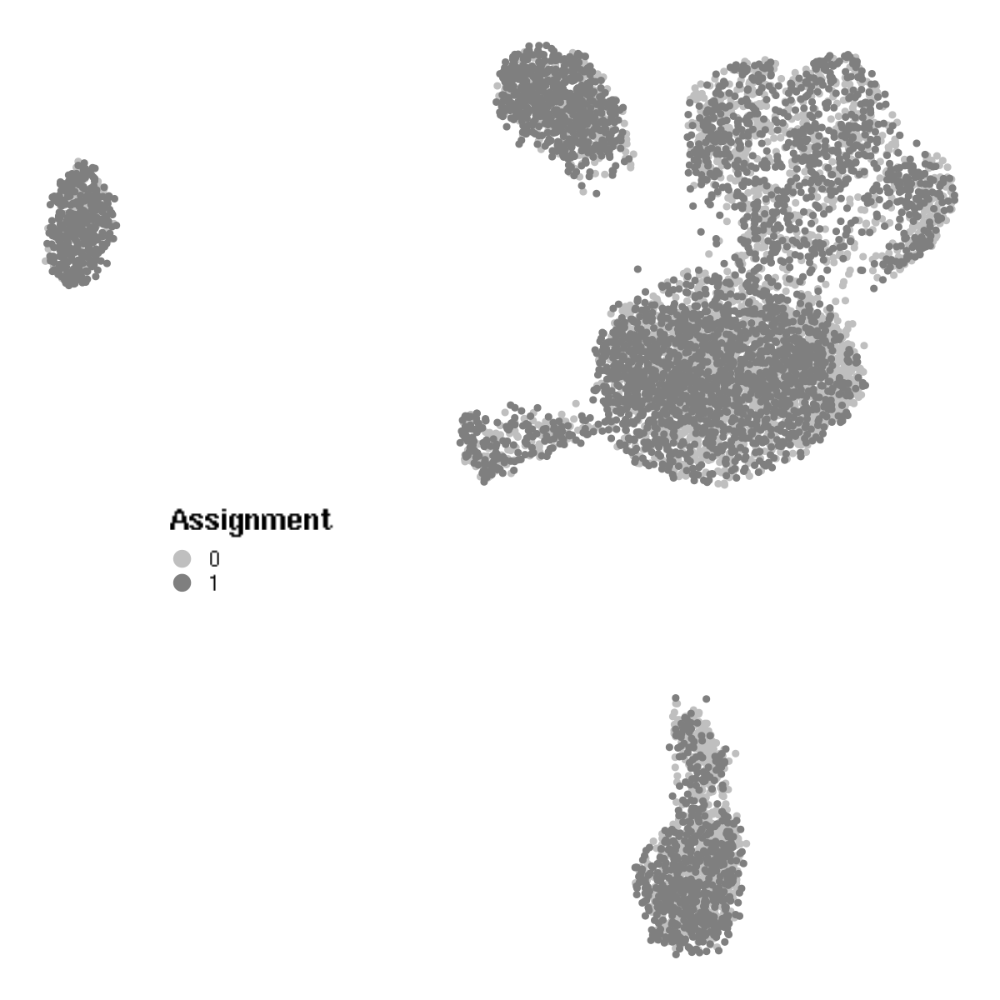

In [66]:
#extract umap
umap_df = proj@cellColData %>% data.frame()
umap_df$UMAP_1 = proj@embeddings$UMAP$df[,1]
umap_df$UMAP_2 = proj@embeddings$UMAP$df[,2]

#reorder and plot
ord_new = c('0','1','1/0','0/1')
umap_df$assignment <- factor(umap_df$assignment, levels = ord_new)
umap_df <- umap_df[order(umap_df$assignment),]

p0 = ggplot(umap_df, aes(x = UMAP_1, 
                    y = UMAP_2, 
                    color = assignment)
    )+geom_point(
    )+theme_void(
    )+theme(plot.title = element_blank(), 
            strip.text = element_blank(), 
           legend.position = c(.25, .45), 
            legend.text = element_text(size=15, family = 'Helvetica'),
            legend.title = element_text(size=20, family = 'Helvetica', face = "bold")
    )+guides(color = guide_legend(override.aes = list(size = 5))
    )+scale_color_manual(name = "Assignment",
                         values = c('#bfbfbf', '#7f7f7f', '#9705ff', '#3f00bd'
                                   )
)
p0

In [67]:
plot_dir = '/fh/fast/henikoff_s/user/jgreene/projects/sciCnT/data/Figures/'
pdf(file=paste0(plot_dir, '221016_PBMC_K4me3_clean_assignment.pdf'),width=10, height=10)
p0
dev.off()

png 
  2

In [68]:
proj = saveArchRProject(
  ArchRProj = proj,
  outputDirectory = getOutputDirectory(proj),
  overwrite = TRUE,
  load = TRUE,
  dropCells = FALSE,
  logFile = createLogFile("saveArchRProject"),
  threads = getArchRThreads()
)

Saving ArchRProject...

Loading ArchRProject...

Successfully loaded ArchRProject!


                                                   / |
                                                 /    \
            .                                  /      |.
            \\\                              /        |.
              \\\                          /           `|.
                \\\                      /              |.
                  \                    /                |\
                  \\#####\           /                  ||
                ==###########>      /                   ||
                 \\##==......\    /                     ||
            ______ =       =|__ /__                     ||      \\\
        ,--' ,----`-,__ ___/'  --,-`-===================##========>
       \               '        ##_______ _____ ,--,__,=##,__   ///
        ,    __==    ___,-,__,--'#'  ==='      `-'    | ##,-/
        -,____,---'       \\####\\________________,--\\_##,/
         

# Donor

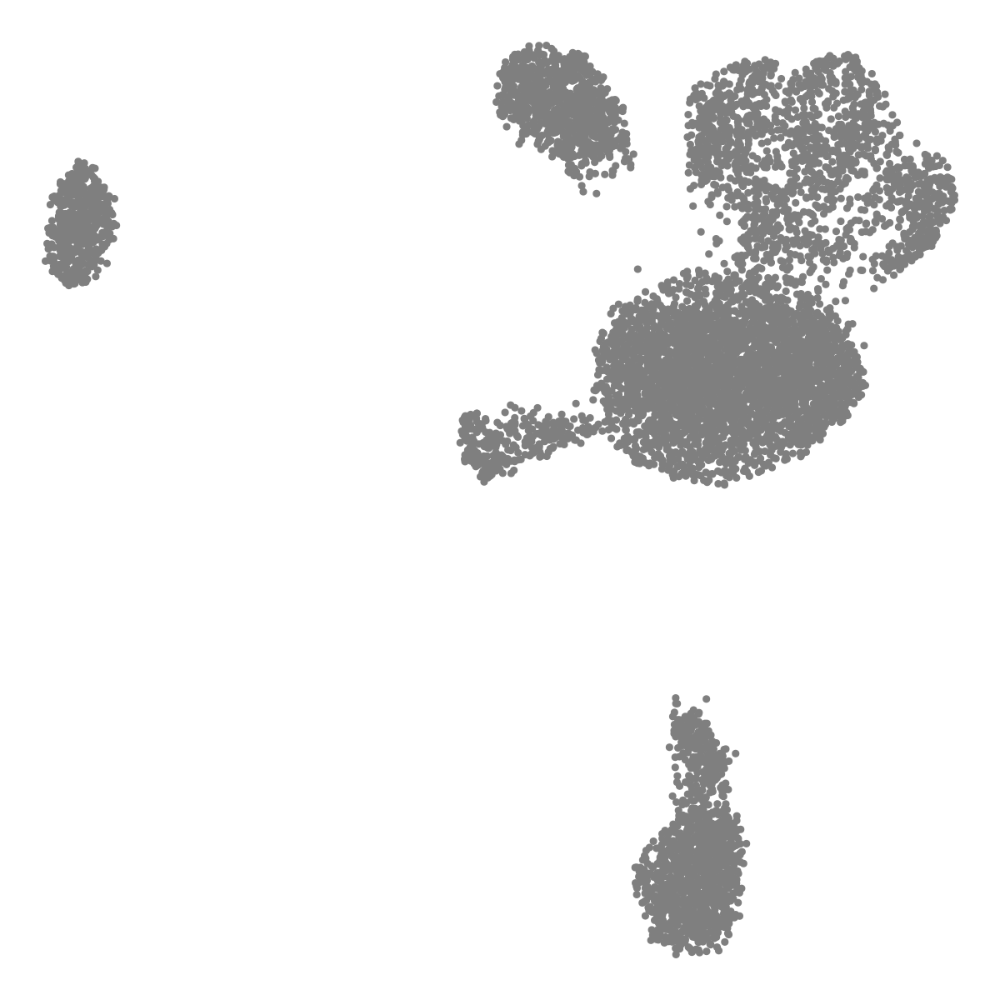

In [69]:
#extract umap
umap_df = proj@cellColData %>% data.frame()
umap_df$UMAP_1 = proj@embeddings$UMAP$df[,1]
umap_df$UMAP_2 = proj@embeddings$UMAP$df[,2]

#reorder and plot
ord_new = c('A','B','A+B')
umap_df$Donor <- factor(umap_df$Donor, levels = ord_new)
umap_df <- umap_df[order(umap_df$Donor),]

ggplot(umap_df, aes(x = UMAP_1, 
                    y = UMAP_2, 
                    color = Donor)
    )+geom_point(
    )+theme_void(
    )+theme(plot.title = element_blank(), 
            strip.text = element_blank(), 
            legend.position = c(.86, .79), 
            legend.text = element_text(size=25),# face = "bold"),
            legend.title = element_text(size=25, face = "bold")
    )+guides(color = guide_legend(override.aes = list(size = 5))
    )+scale_color_manual(name = "Donor",
                         values = c('#bfbfbf', '#7f7f7f', '#9705ff'
                                   )
)

# Genes

In [75]:
proj <- addGeneScoreMatrix(proj, matrixName='GeneScoreMatrix', force=TRUE, threads = 1) 

ArchR logging to : ArchRLogs/ArchR-addGeneScoreMatrix-416811ea2e1f-Date-2022-10-17_Time-15-37-08.log
If there is an issue, please report to github with logFile!

2022-10-17 15:37:08 : Batch Execution w/ safelapply!, 0 mins elapsed.

.createArrowGroup : Arrow Group already exists! Dropping Group from ArrowFile! This will take ~10-30 seconds!

.dropGroupsFromArrow : Initializing Temp ArrowFile

.dropGroupsFromArrow : Adding Metadata to Temp ArrowFile

.dropGroupsFromArrow : Adding SubGroups to Temp ArrowFile

.dropGroupsFromArrow : Move Temp ArrowFile to ArrowFile

DJ_Hs_PBMC_K4me123_ALLSEQ_220523_220527 .addGeneScoreMat useTSS = FALSE

2022-10-17 15:37:30 : Computing Gene Scores using distance relative to GeneBody! , 0.368 mins elapsed.

ArchR logging successful to : ArchRLogs/ArchR-addGeneScoreMatrix-416811ea2e1f-Date-2022-10-17_Time-15-37-08.log



In [20]:
#impute
proj = addImputeWeights(      
ArchRProj = proj,
reducedDims = "IterativeLSI",
dimsToUse = 1:15,
scaleDims = NULL,
corCutOff = 0.75,
td = 3,
ka = 4,
sampleCells = 3000,
nRep = 5,
k = 15,
epsilon = 1,
useHdf5 = TRUE,
randomSuffix = FALSE,
threads = getArchRThreads(),
seed = 1,
verbose = TRUE,
logFile = createLogFile("addImputeWeights")
)

ArchR logging to : ArchRLogs/ArchR-addImputeWeights-7b585cb4eaca-Date-2023-04-28_Time-14-51-06.log
If there is an issue, please report to github with logFile!

2023-04-28 14:51:06 : Computing Impute Weights Using Magic (Cell 2018), 0 mins elapsed.



In [7]:
#marker genes
markersGS <- getMarkerFeatures(
ArchRProj = proj, 
useMatrix = "GeneScoreMatrix", 
groupBy = 'annotation',
bias = c("log10(nFrags)"),
testMethod = "wilcoxon"
)

ArchR logging to : ArchRLogs/ArchR-getMarkerFeatures-7b584b613bb9-Date-2023-04-28_Time-14-46-44.log
If there is an issue, please report to github with logFile!

MatrixClass = Sparse.Double.Matrix

2023-04-28 14:46:45 : Matching Known Biases, 0.007 mins elapsed.

###########
2023-04-28 14:47:27 : Completed Pairwise Tests, 0.709 mins elapsed.
###########

ArchR logging successful to : ArchRLogs/ArchR-getMarkerFeatures-7b584b613bb9-Date-2023-04-28_Time-14-46-44.log



In [15]:
#Final markers
fin = c("EBF1", "PAX5", #B
        "SECISBP2L", "CCR6","FCGR3A", 'CEBPA', 'CEBPB','CD14', #M
        "LEF1", "CD4", "CD8A", "CD3D", "TBX21", "GATA3", 'RUNX3', 'IFNG', 'IL4', 'TP73', #T
        "NCAM1", "NCAM2" #NK
       )

In [16]:
#Visualize clusters
p = plotEmbedding(
        ArchRProj = proj, 
        colorBy = "GeneScoreMatrix", 
        name = fin, 
        embedding = "UMAP",
        quantCut = c(0.01, 0.95),
        size =1, 
        pal= paletteContinuous(), 
        plotAs= "points", 
        imputeWeights = NULL
)

ArchR logging to : ArchRLogs/ArchR-plotEmbedding-7b5878cc7c6b-Date-2023-04-28_Time-14-49-35.log
If there is an issue, please report to github with logFile!

Getting UMAP Embedding

ColorBy = GeneScoreMatrix

Getting Matrix Values...

2023-04-28 14:49:36 : 

1 


Plotting Embedding

1 
2 
3 
4 
5 
6 
7 
8 
9 
10 
11 
12 
13 
14 
15 
16 
17 
18 
19 
20 


ArchR logging successful to : ArchRLogs/ArchR-plotEmbedding-7b5878cc7c6b-Date-2023-04-28_Time-14-49-35.log



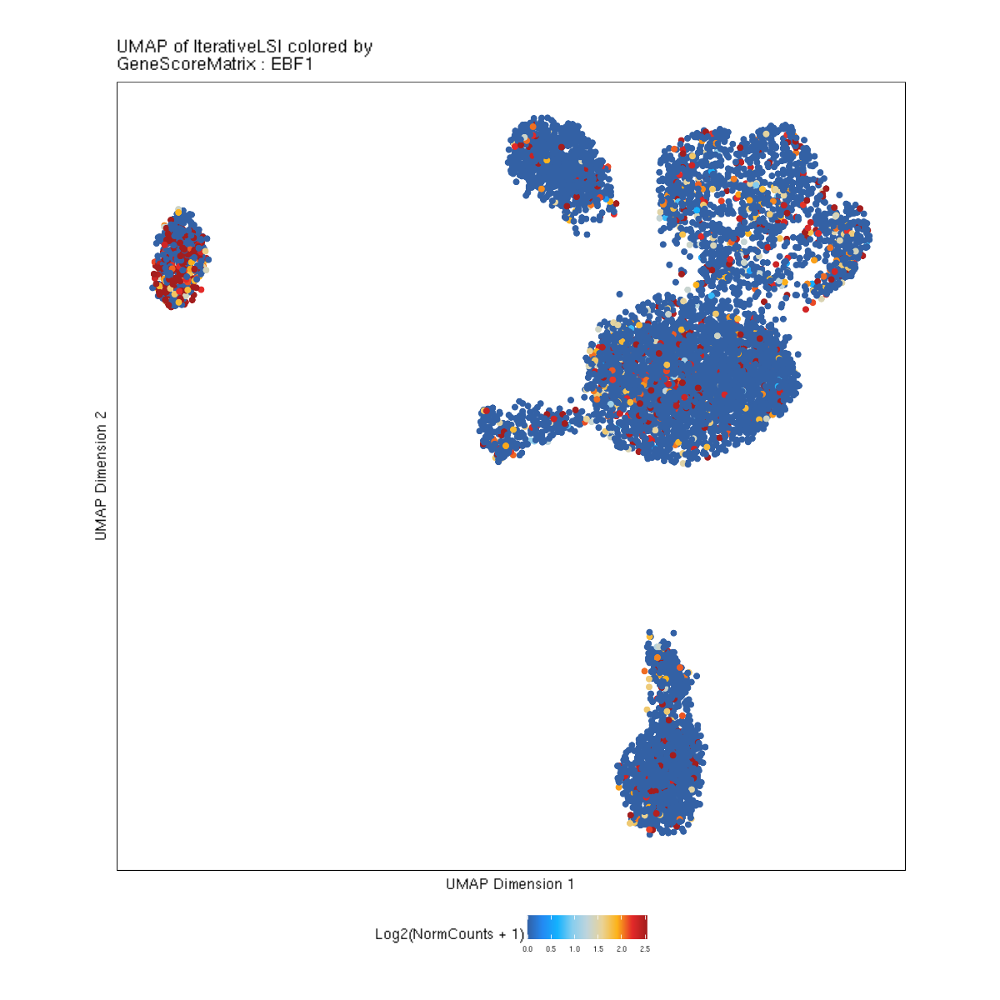

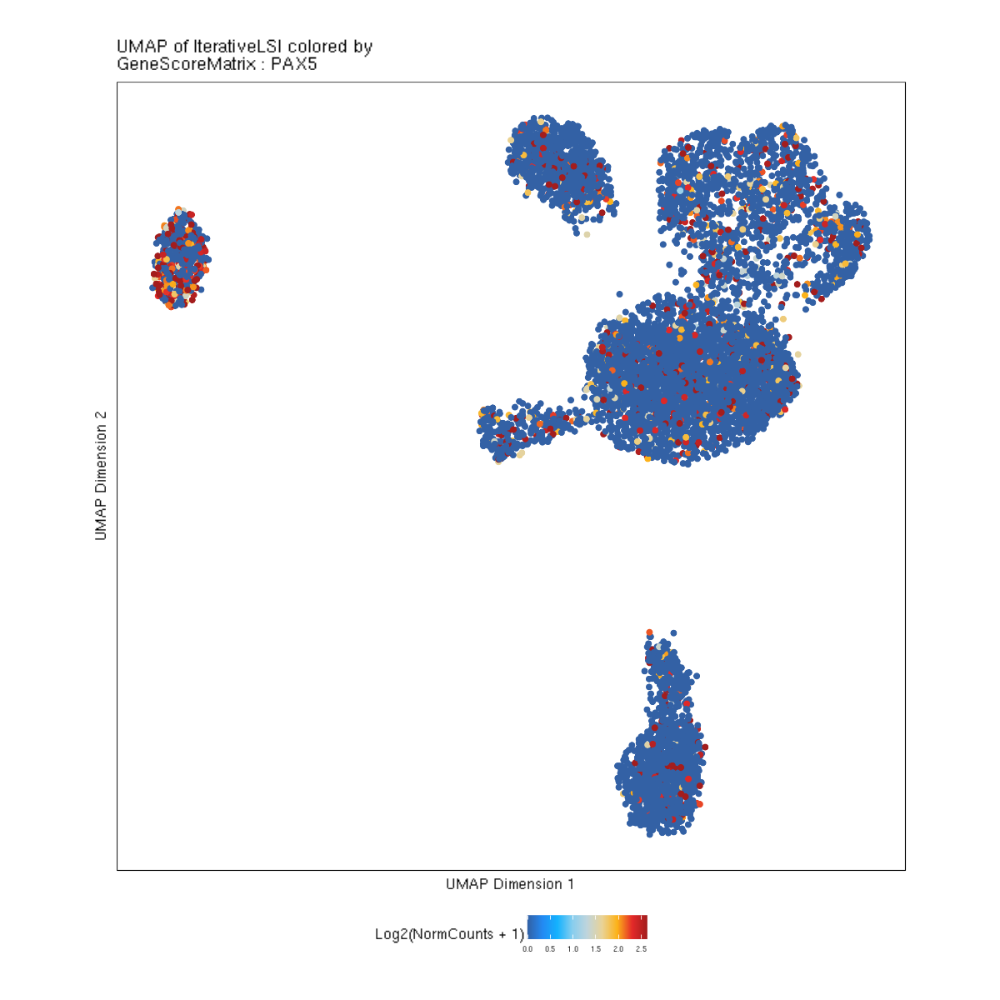

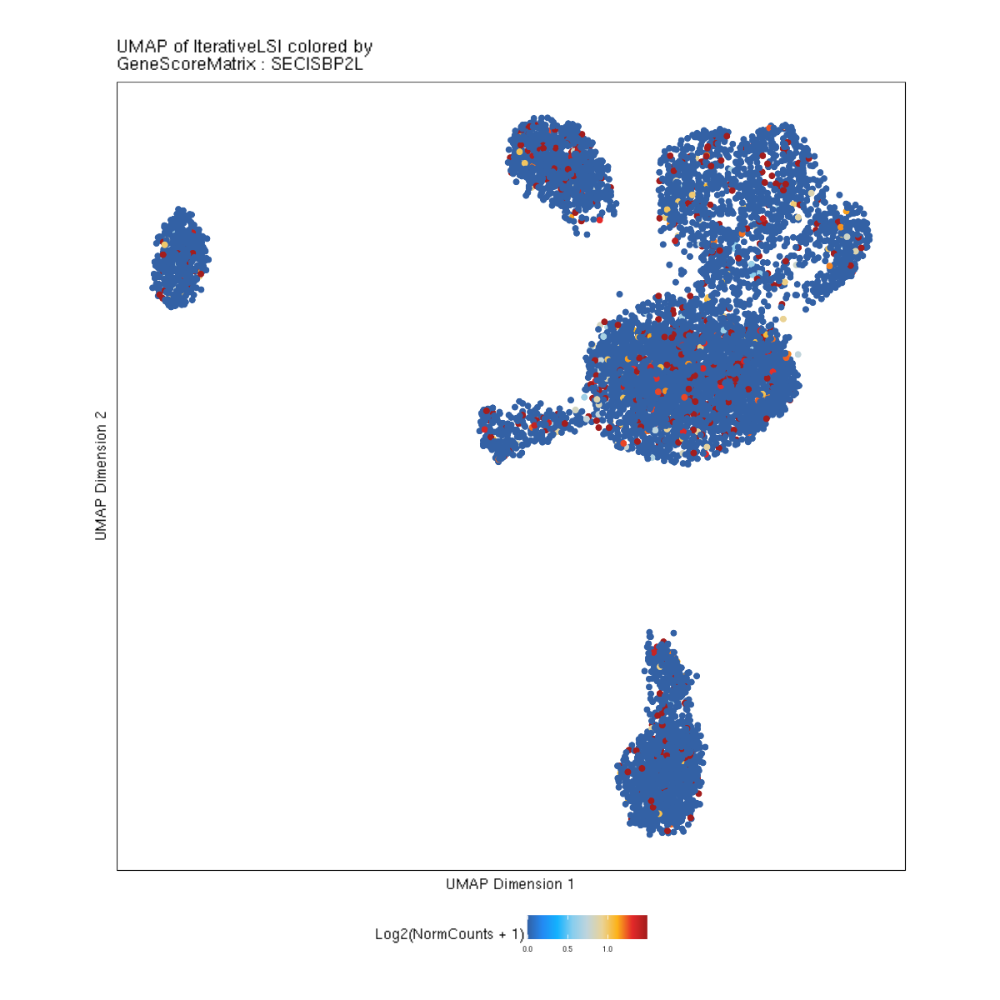

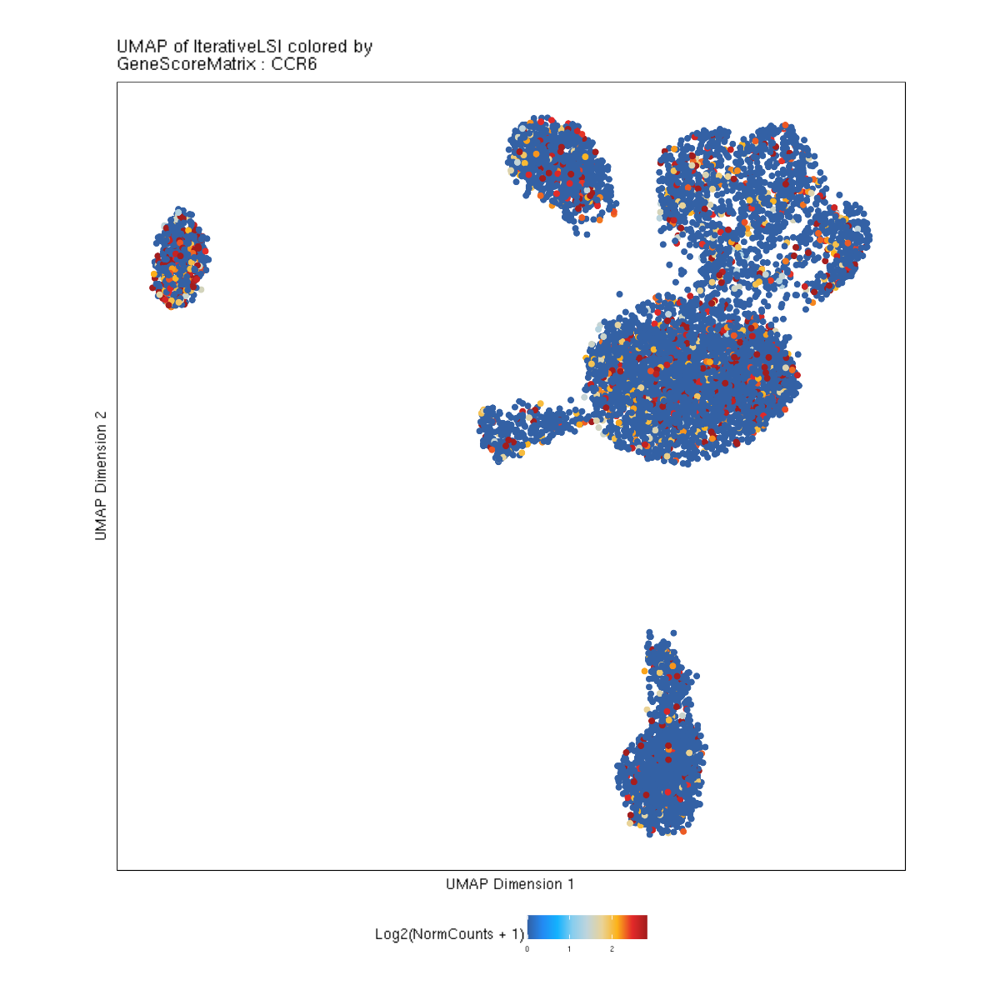

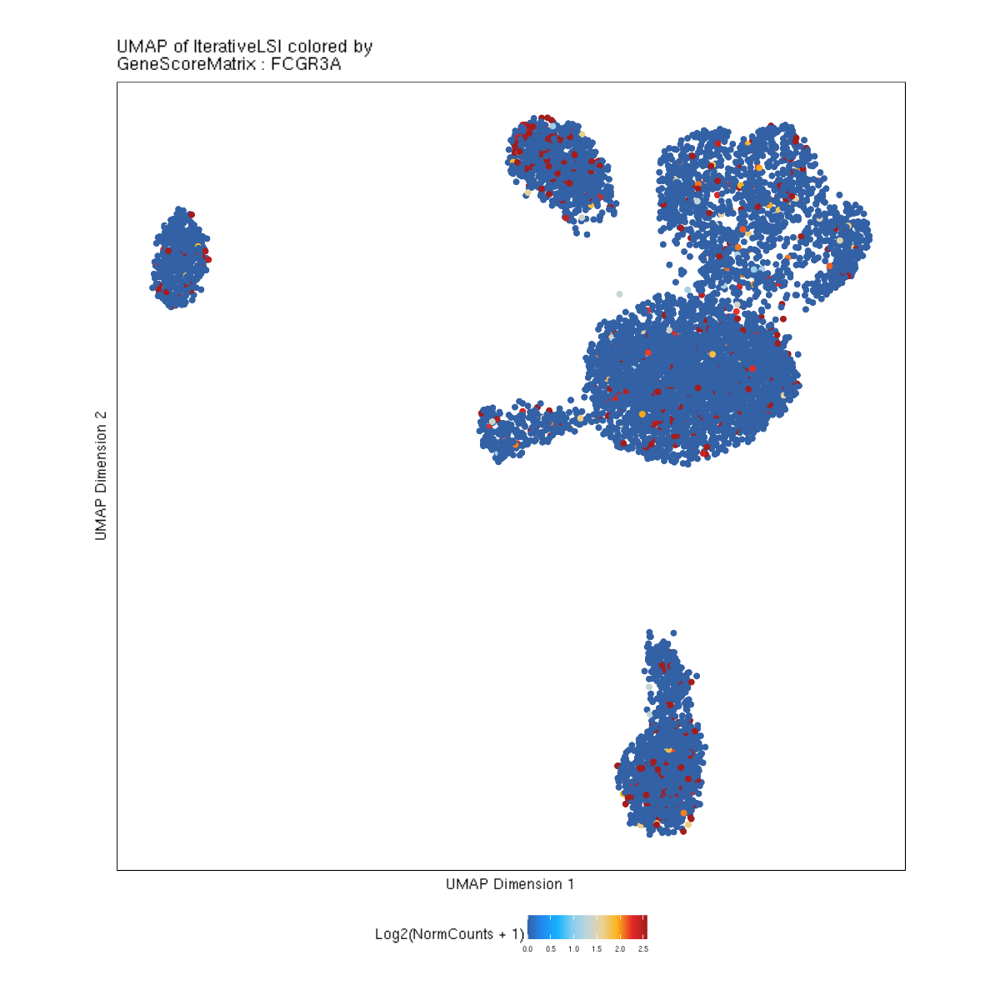

...

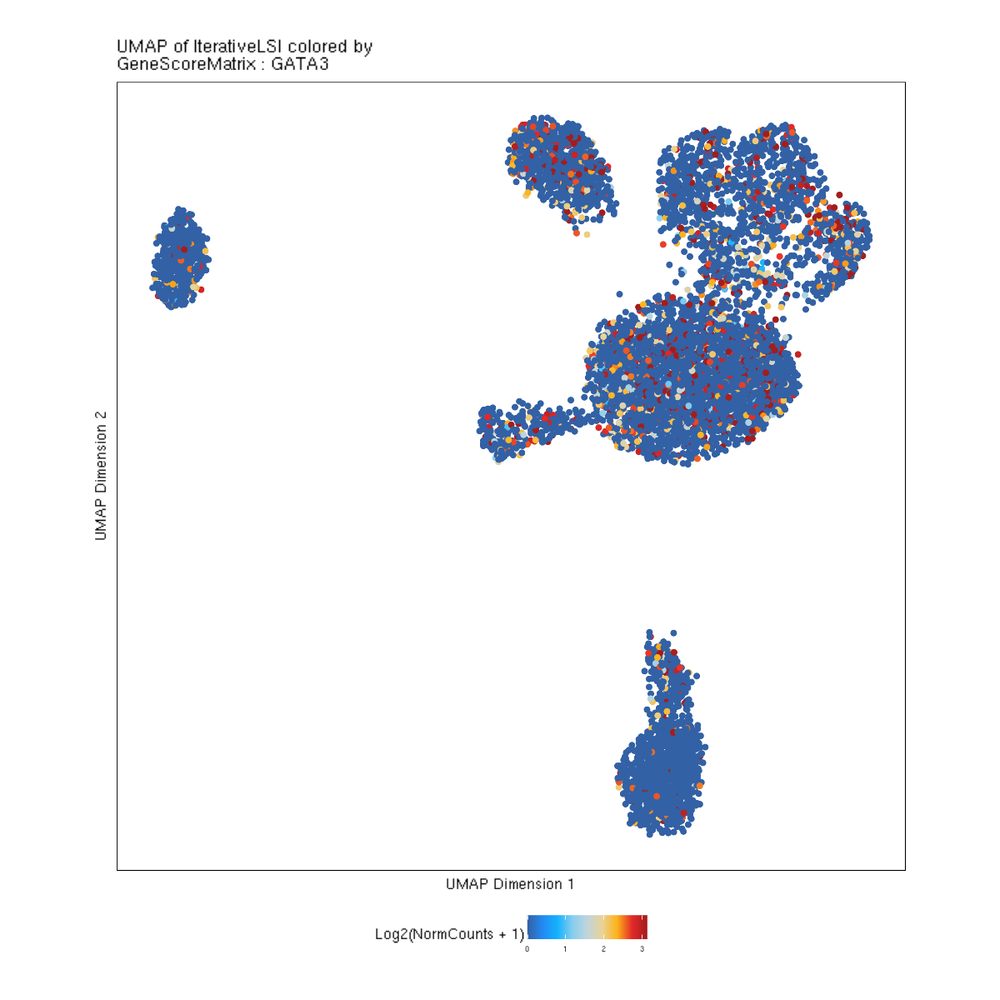

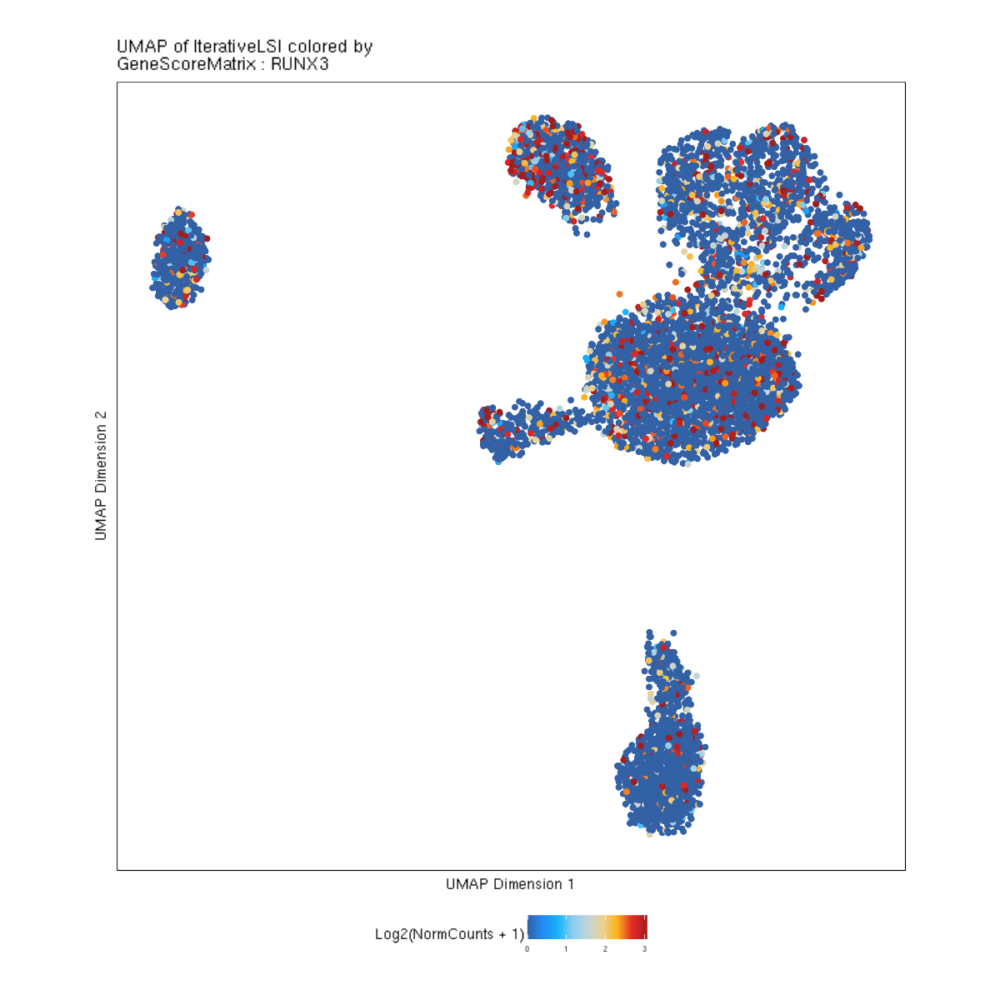

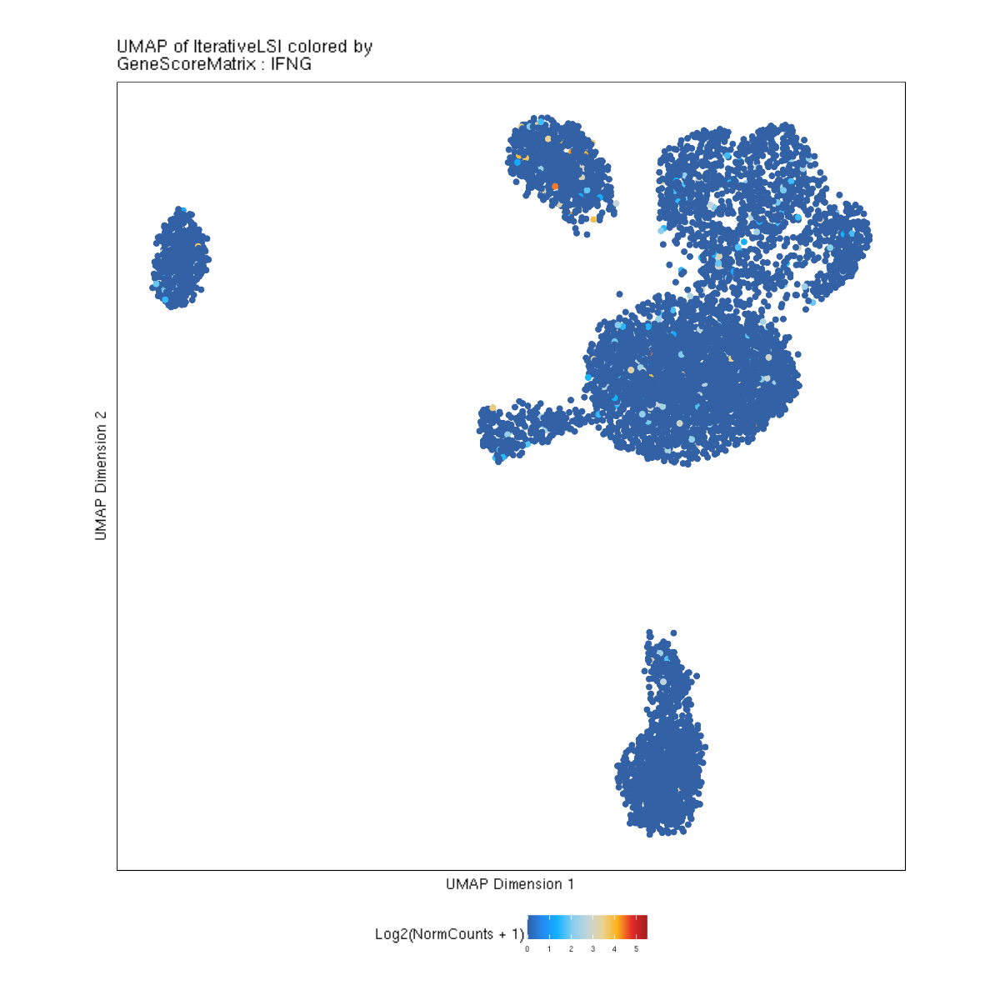

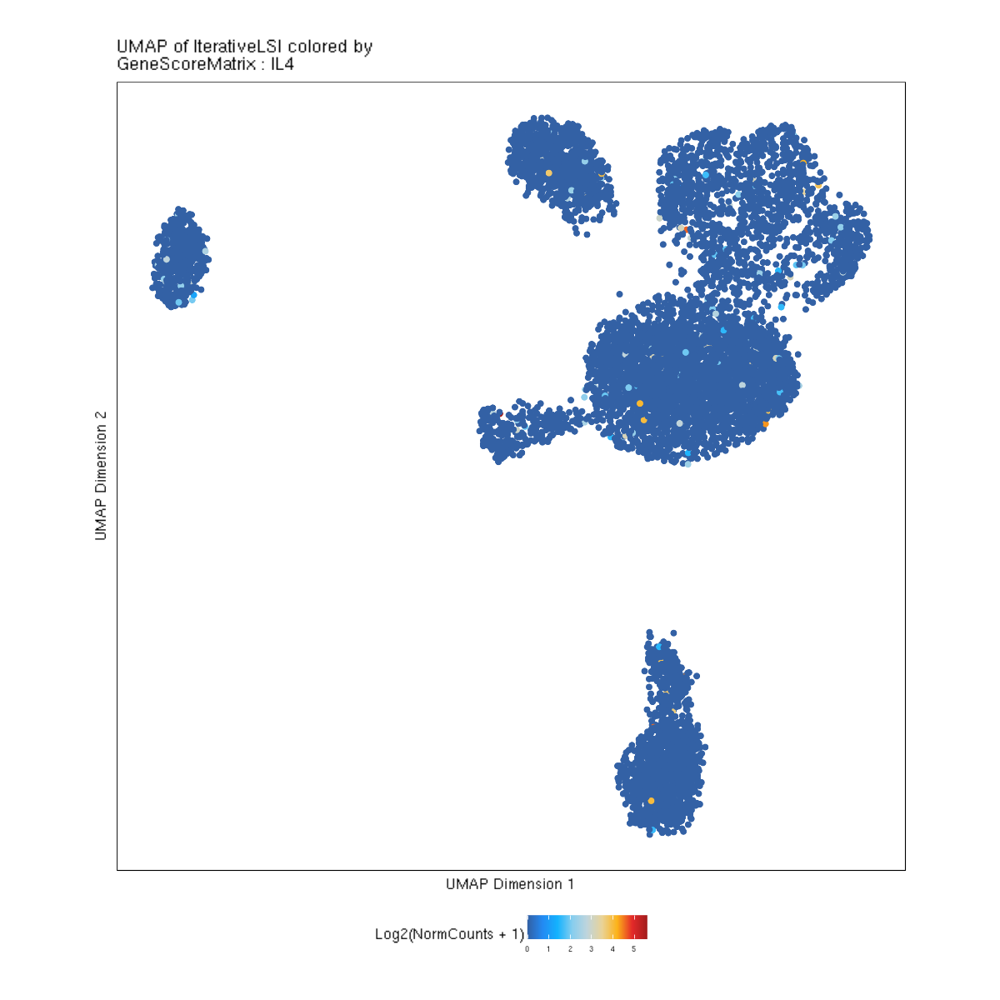

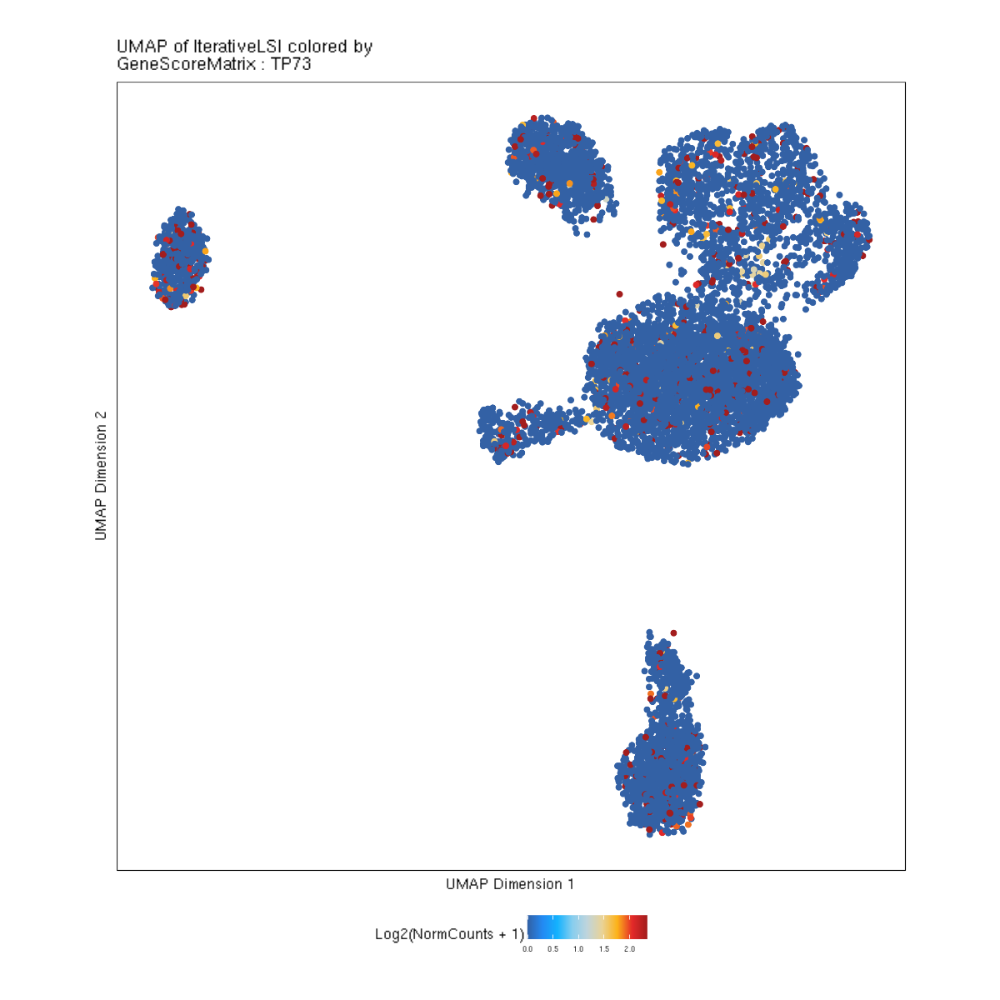

$EBF1

$PAX5

$SECISBP2L

$CCR6

$FCGR3A

$CEBPA

$CEBPB

$CD14

$LEF1

$CD4

$CD8A

$CD3D

$TBX21

$GATA3

$RUNX3

$IFNG

$IL4

$TP73

$NCAM1

$NCAM2


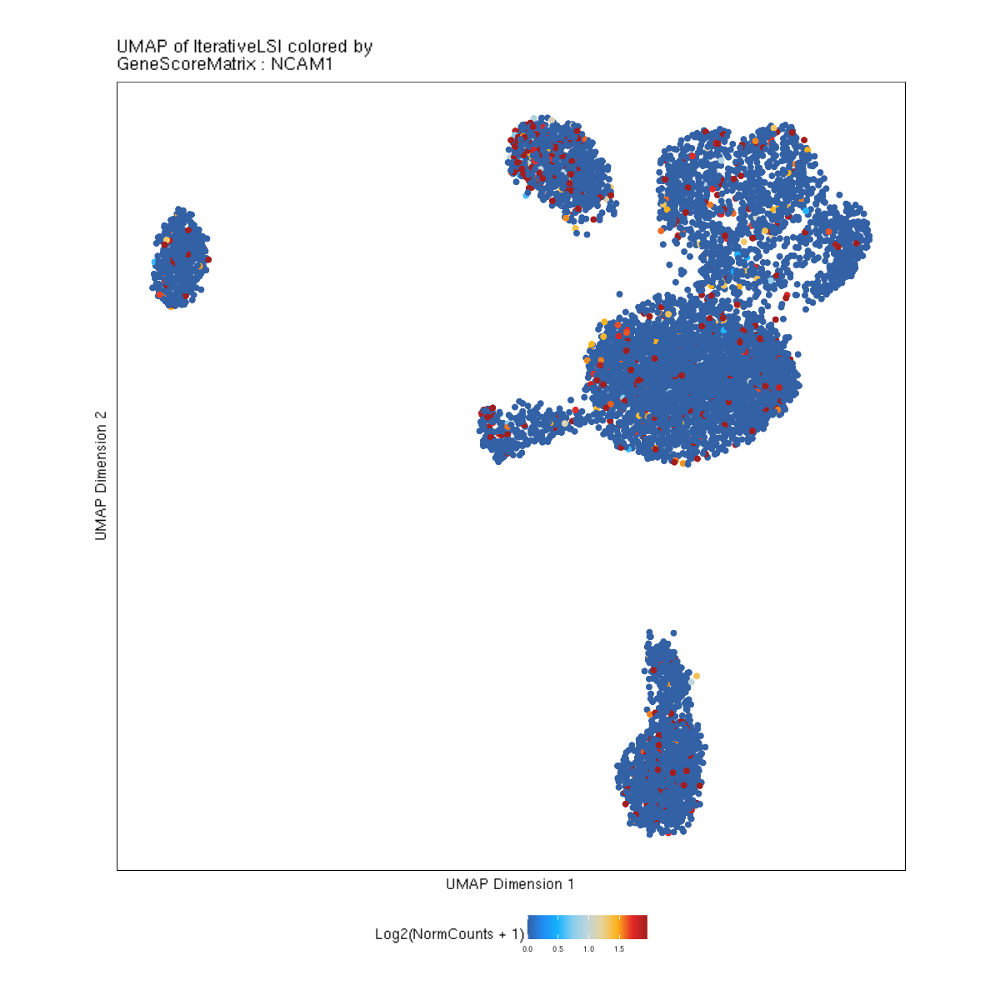

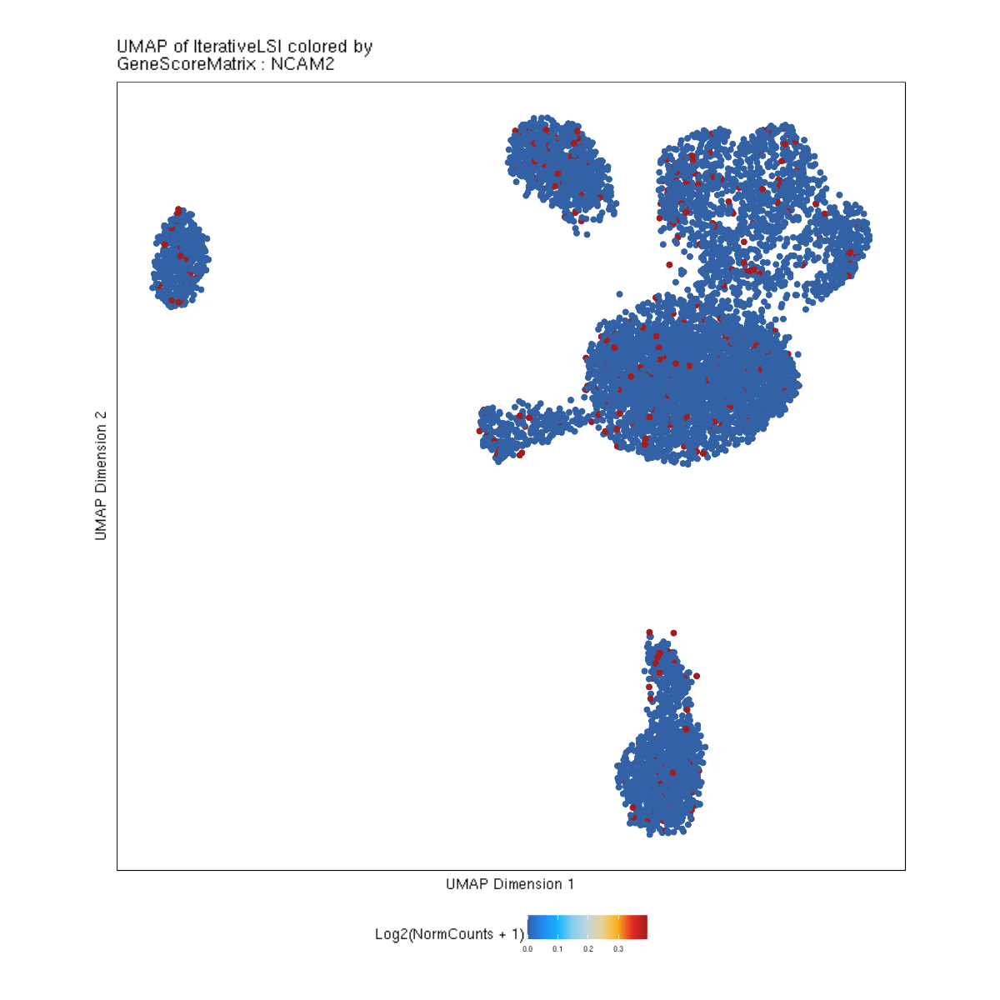

In [17]:
p

In [107]:
proj


           ___      .______        ______  __    __  .______      
          /   \     |   _  \      /      ||  |  |  | |   _  \     
         /  ^  \    |  |_)  |    |  ,----'|  |__|  | |  |_)  |    
        /  /_\  \   |      /     |  |     |   __   | |      /     
       /  _____  \  |  |\  \\___ |  `----.|  |  |  | |  |\  \\___.
      /__/     \__\ | _| `._____| \______||__|  |__| | _| `._____|
    



class: ArchRProject 
outputDirectory: /fh/fast/henikoff_s/user/jgreene/projects/sciCnT/data/ArchR/DJ_Hs_PBMC_K4me123_220523_220527_79x79_MERGE_50k/proj_FINAL_v3 
samples(1): DJ_Hs_PBMC_K4me123_ALLSEQ_220523_220527
sampleColData names(1): ArrowFiles
cellColData names(23): Sample TSSEnrichment ... Clusters annotation
numberOfCells(1): 8162
medianTSS(1): 7.49
medianFrags(1): 1213

In [80]:
## CD34 progenitors
CD34_genes = c("CD34","CD38","PTPRC", "KIT", "FLT3", "HMGB3", "IL3RA", "IL7R", "MME", "CD27", "BCR", "ABL1")
## CD33 myeloid progenitors
MyProg_genes = c("CD34", "CD33","KIT","CD68", "NECTIN2", "FLT3", "CSF3R")
## B-cells
B_genes = c("CD19", "MS4A1", "HLA-DRB1", "FCGR3A", "CD27", "IGheavy1", "CD9", "CD58")
## Plasma Cells
Plasma_genes = c("ENPP1", "CD38", "SDC1", "CD27")
## T-cells
T_genes = c("CD2", "CD3D", "NCAM1", "IL2RA", "CD69", "CD5", "CD4", "CD8A", "CD40LG")           
T_genes2 = c("CD4", "CD8A","IL7R", "CCR7", "TCF7", "GZMK", "CTLA4", "TIGIT", "TBX21", "GATA3", "RORA", "FOXP3")
## NK-cells
NK_genes = c("CD3D", "NCAM1", "FCGR3A")
## dendritic cells
DC_genes = c("CD1C", "CD83", "THBD", "CD209", "HLA-DRB1", "ITGAX", "IL3RA", "CLEC4C", "NRP1")
## platelets, should be no platelets 
Plate_genes = c("GP1BA", "SELP")
## Macrophages
Mac_Genes = c("ITGAM", "CD68", "CD163", "ANPEP")
## Monocytes
Mono_genes = c("CD14", "FCGR3A", "FCGR1A")
## Red Blood Cells and erythroblast
RBC_genes = c("ST6GALNAC1", "TFRC", "SLC4A1", "GYPA", "GYPB", "RHD", "RHCE", "RHAG", "HBB")
## Neutrophiles
Neutro_genes = c("FUT4", "FCGR3A", "CEACAM8", "CEACAM3")
## Basophils/Eosinophils
BasoEo_genes = c("IL3RA", "ENPP3", "FCER1A", "ITGAM", "CCR3", "ADGRE1", "SIGLEC8")
##Endothelial
Endo_genes = c("CD36", "CD93", "PECAM1", "VCAM1", "CDH5", "ESAM")

#Final markers
fin = c("EBF1", "PAX5", #B
        "SECISBP2L", "CCR6","FCGR3A", 'CEBPA', 'CEBPB', #M
        "LEF1", "CD4", "CD8A", "CD3D", "TBX21", "GATA3", 'RUNX3', 'IFNG', 'IL4', 'TP73', #T
        "NCAM1", "NCAM2" #NK
       )

In [16]:
#raw counts
p1 = plotEmbedding(
        ArchRProj = proj, 
        colorBy = "GeneScoreMatrix", 
        name = fin, 
        embedding = "UMAP",
        quantCut = c(0.01, 0.95),
        size =1, 
        pal= paletteContinuous(), 
        plotAs= "points", 
        imputeWeights = NULL
    #getImputeWeights(proj)
)

ArchR logging to : ArchRLogs/ArchR-plotEmbedding-698959bf5b94-Date-2022-10-04_Time-20-44-06.log
If there is an issue, please report to github with logFile!

Getting UMAP Embedding

ColorBy = GeneScoreMatrix

Getting Matrix Values...

2022-10-04 20:44:06 : 

1 


Plotting Embedding

1 
2 
3 
4 
5 
6 
7 
8 
9 
10 
11 
12 
13 
14 
15 
16 


ArchR logging successful to : ArchRLogs/ArchR-plotEmbedding-698959bf5b94-Date-2022-10-04_Time-20-44-06.log



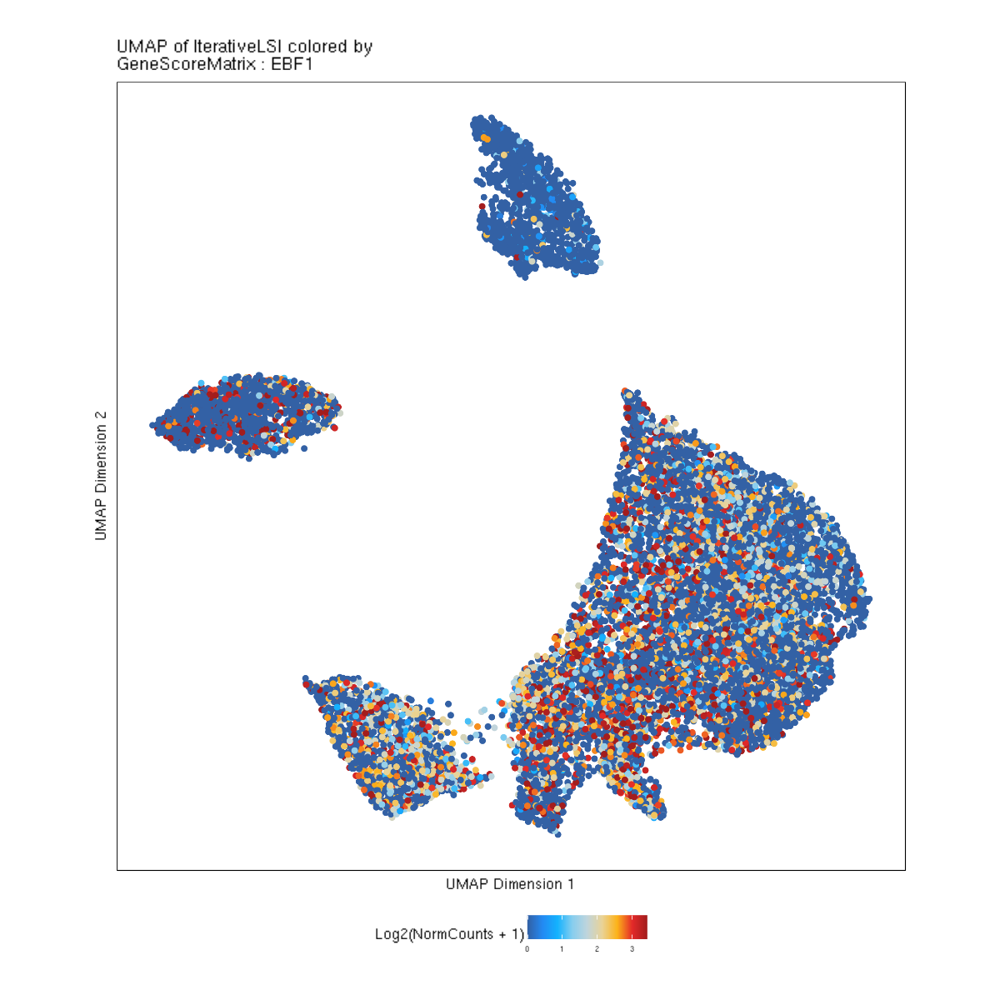

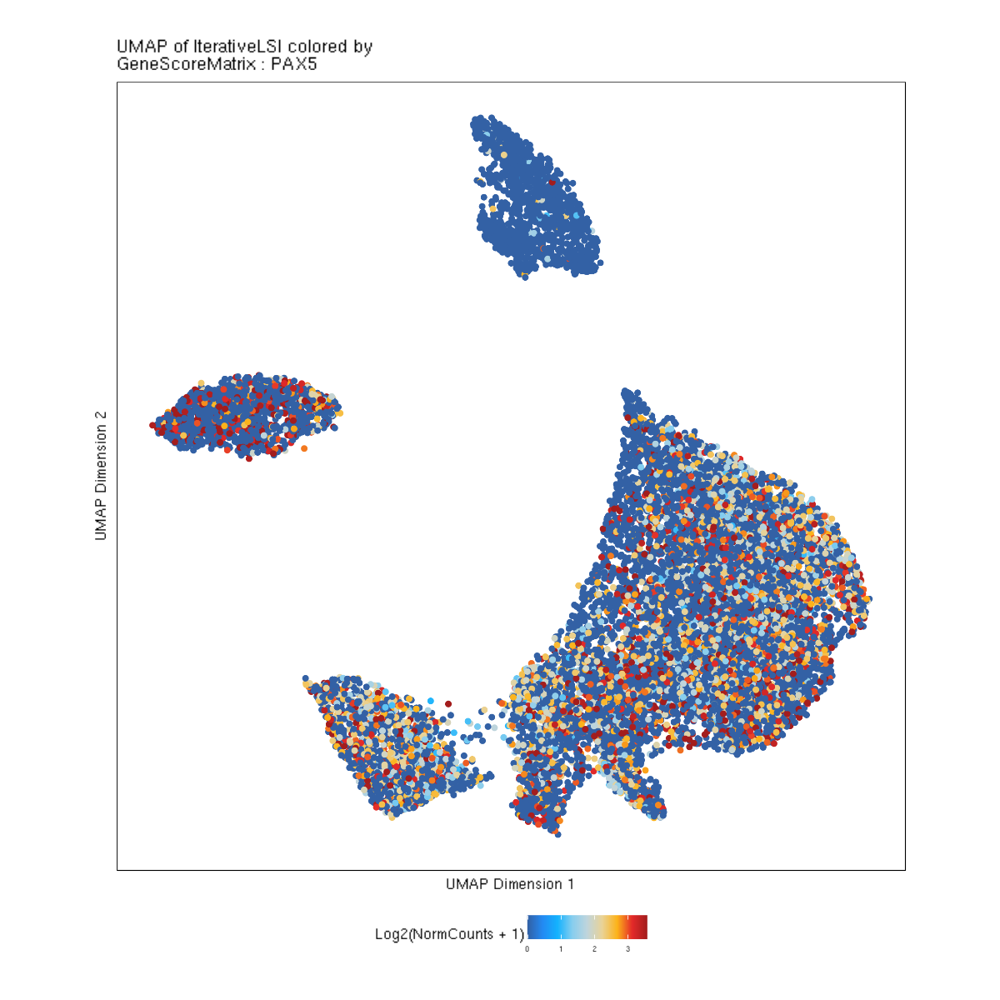

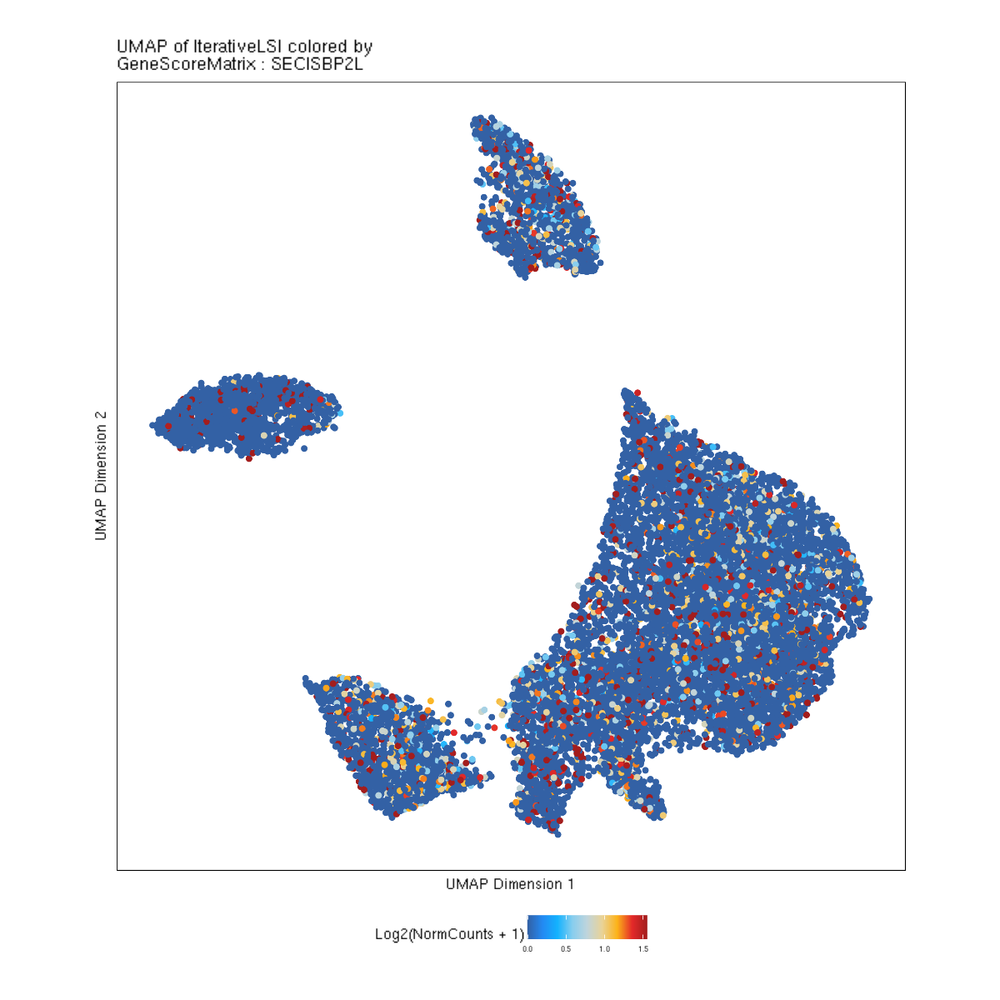

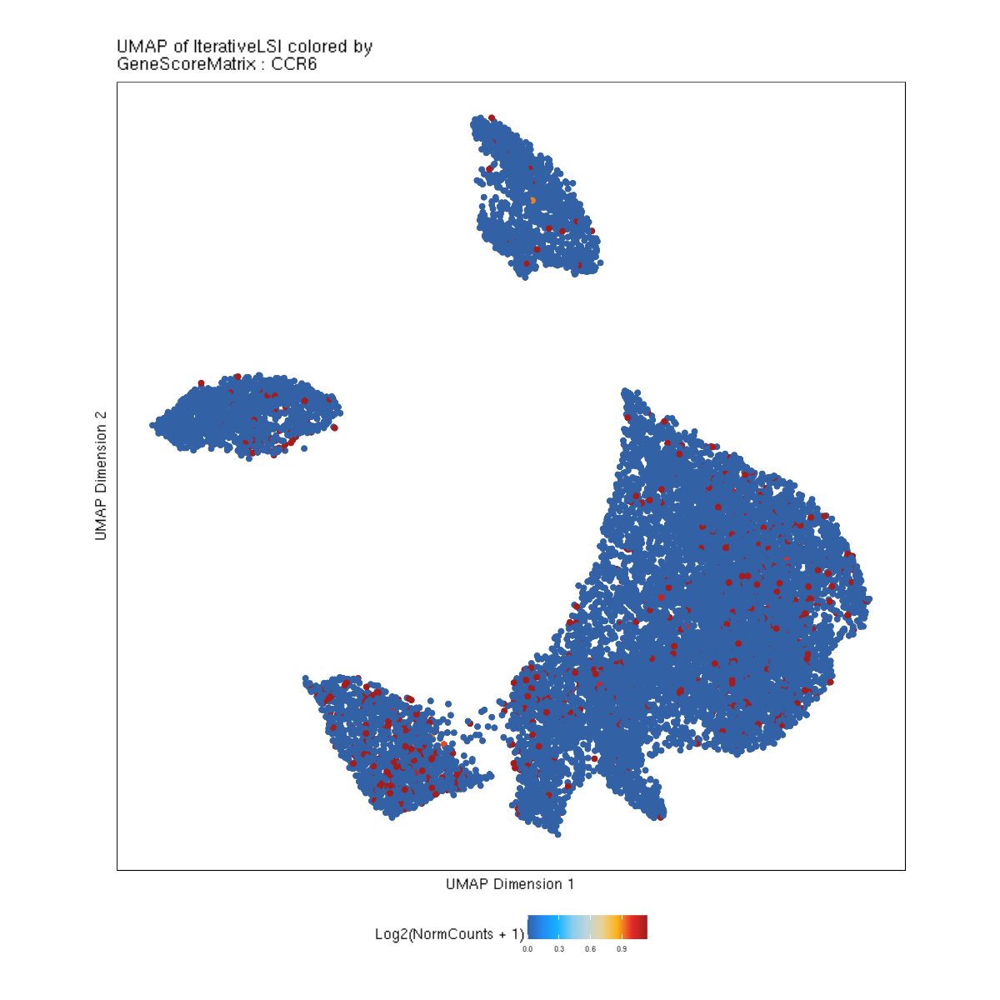

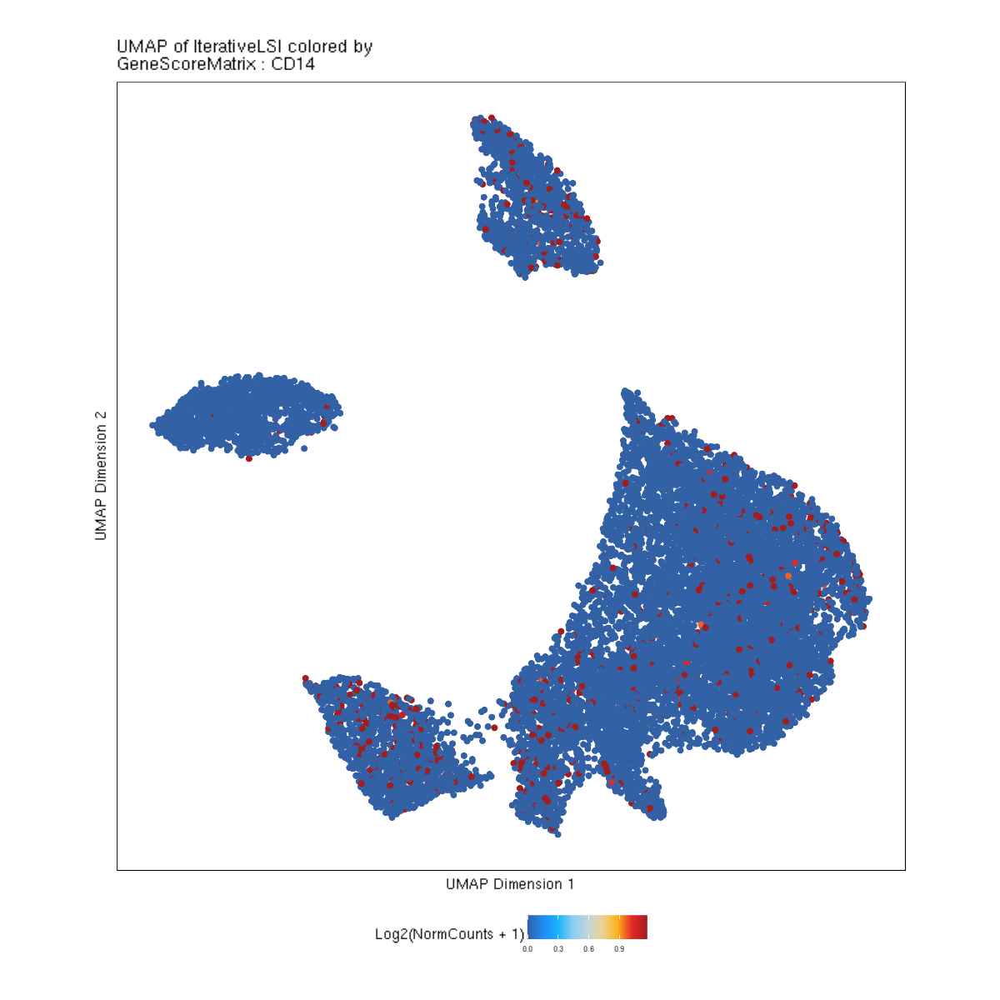

...

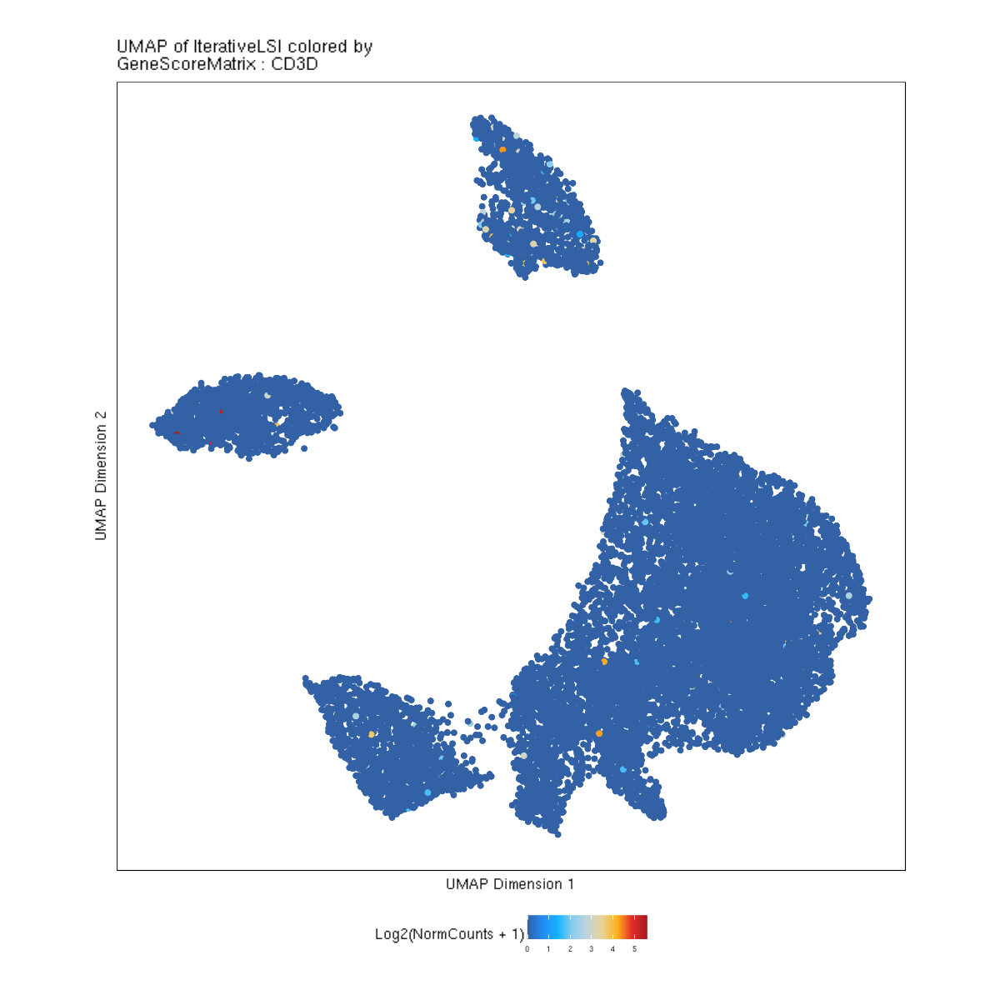

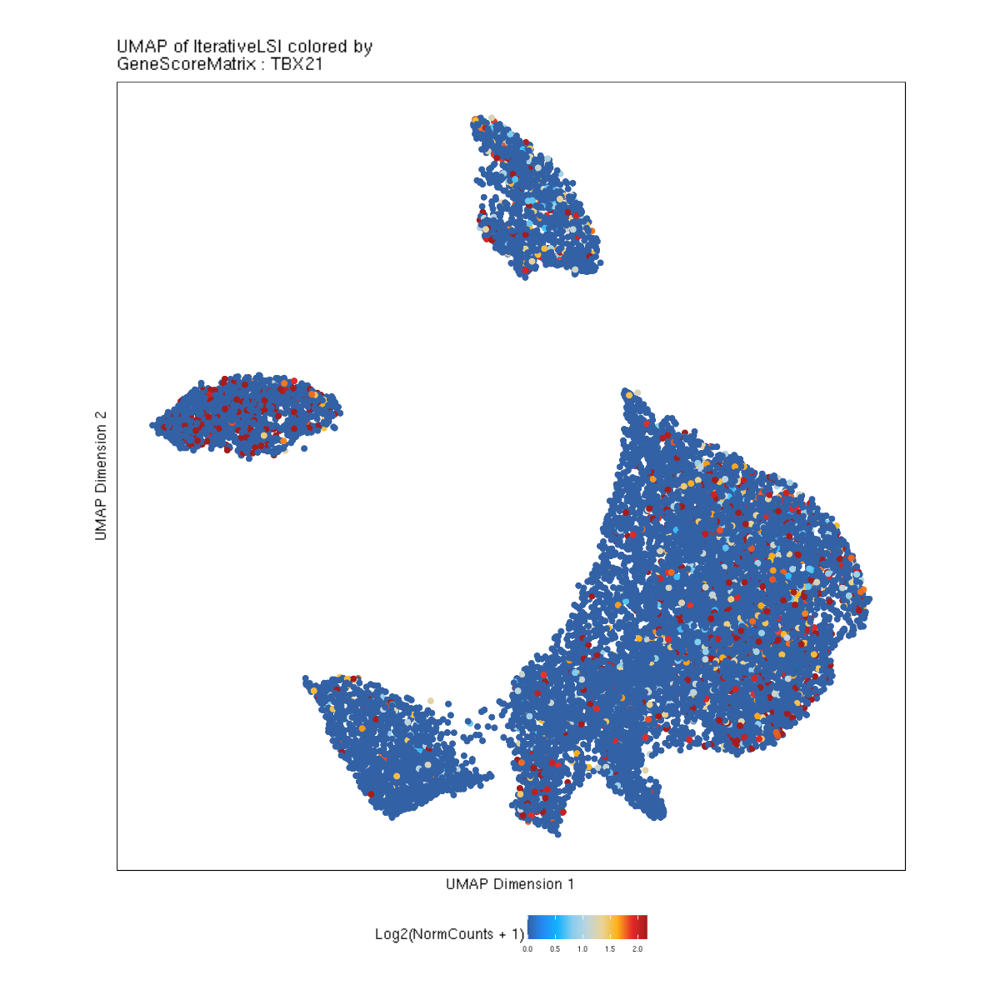

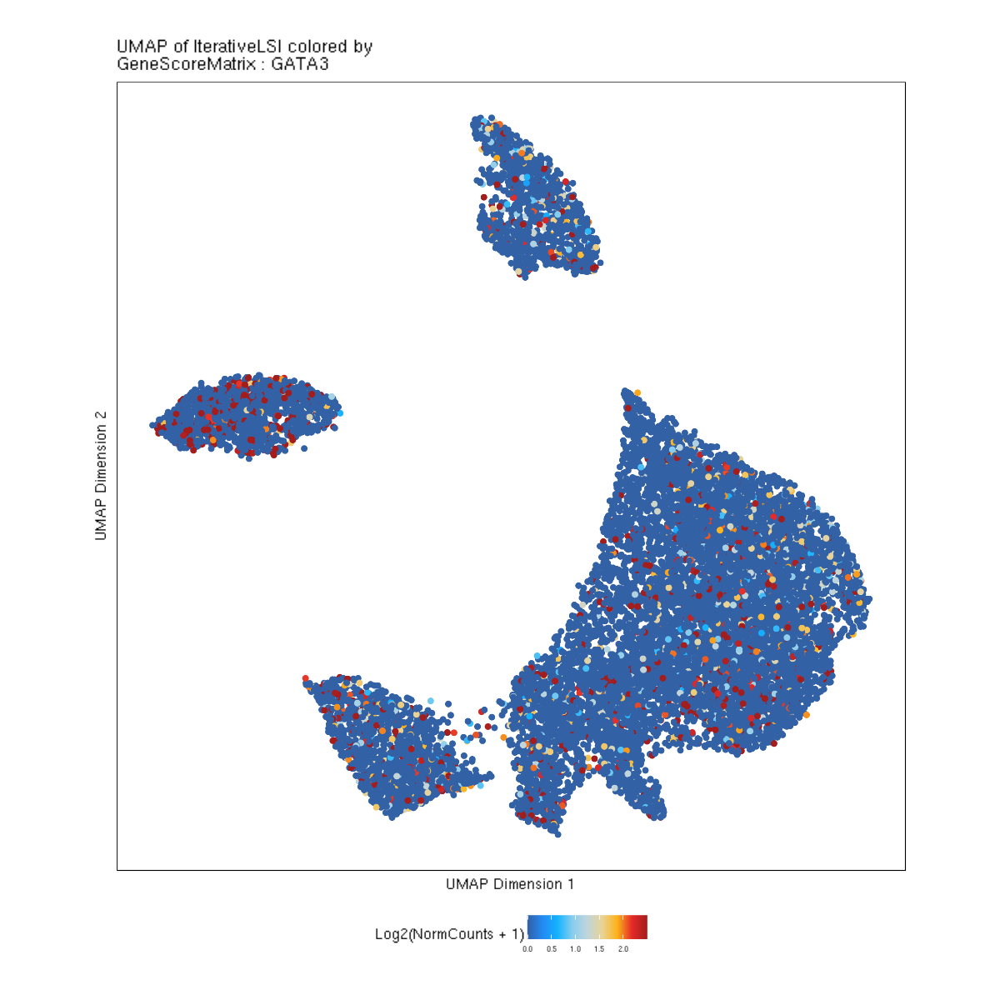

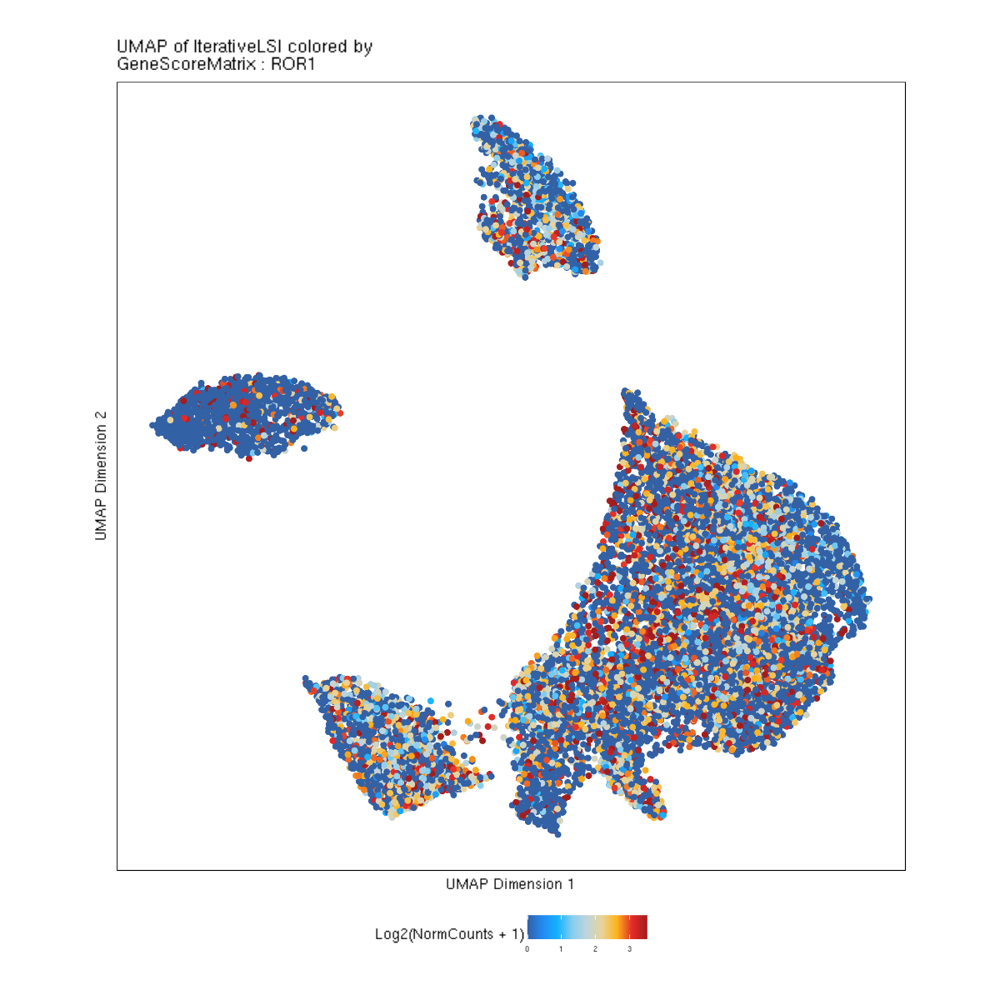

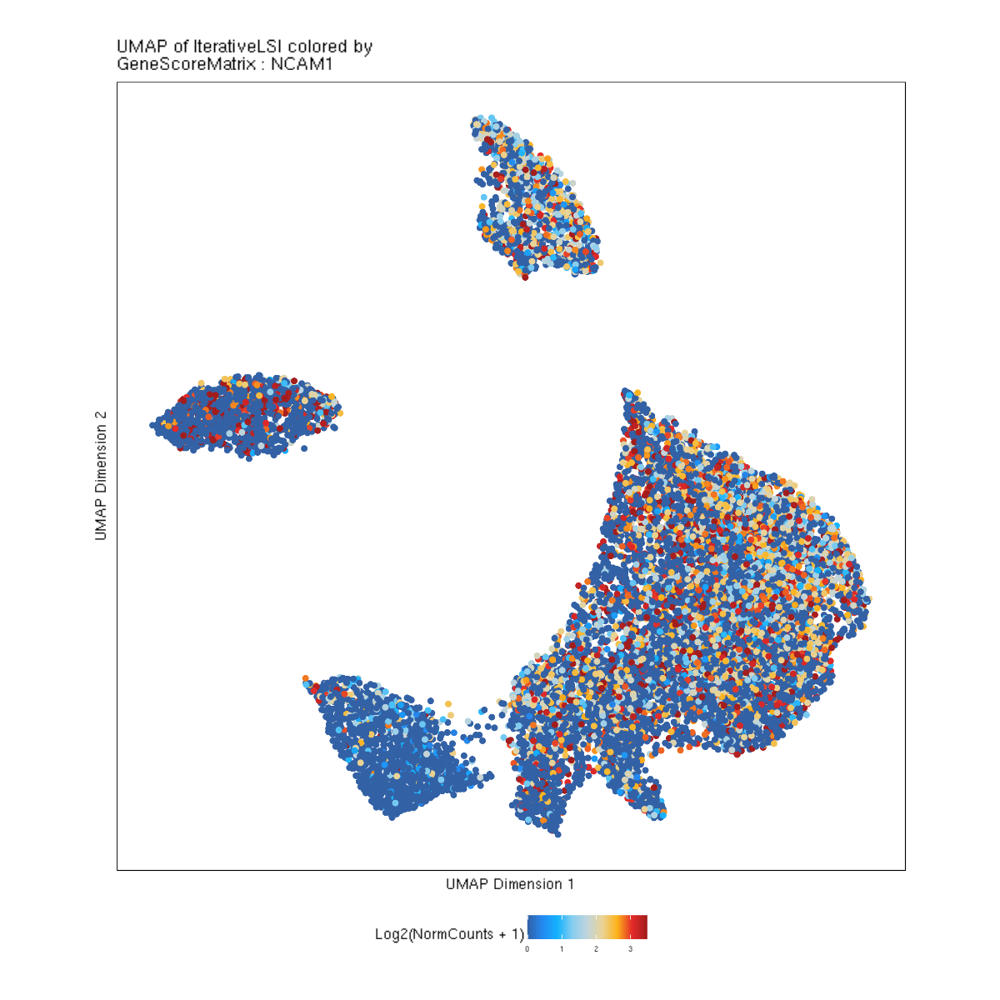

$EBF1

$PAX5

$SECISBP2L

$CCR6

$CD14

$FCGR3A

$LEF1

$CD4

$CD8A

$CD3D

$TBX21

$GATA3

$ROR1

$NCAM1

$NCAM2

$ITGAX


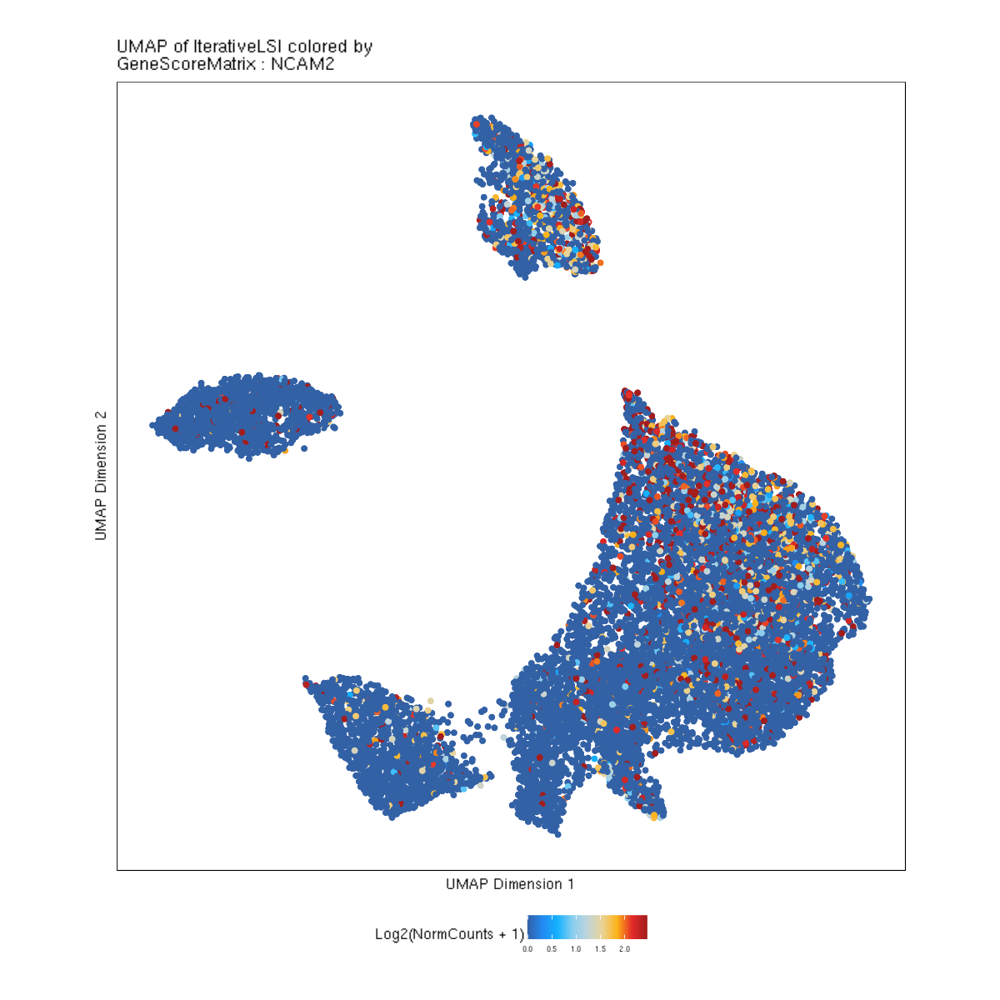

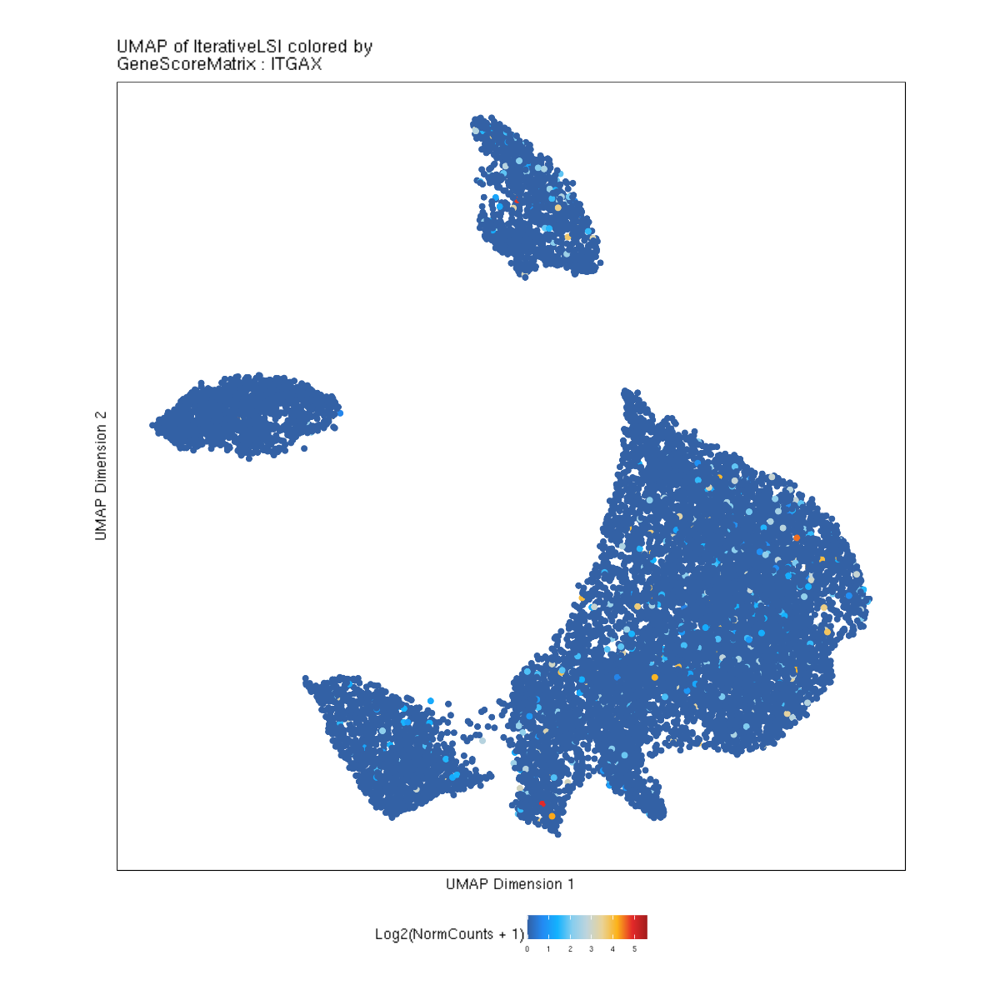

In [20]:
p1

In [21]:
#imputed counts
p2 = plotEmbedding(
        ArchRProj = proj, 
        colorBy = "GeneScoreMatrix", 
        name = fin, 
        embedding = "UMAP",
        quantCut = c(0.01, 0.95),
        size =1, 
        pal= paletteContinuous(), 
        plotAs= "points", 
        imputeWeights = getImputeWeights(proj)
)

Getting ImputeWeights

ArchR logging to : ArchRLogs/ArchR-plotEmbedding-7b583f4a5ec0-Date-2023-04-28_Time-14-52-59.log
If there is an issue, please report to github with logFile!

Getting UMAP Embedding

ColorBy = GeneScoreMatrix

Getting Matrix Values...

2023-04-28 14:53:00 : 

1 


Imputing Matrix

Using weights on disk

Using weights on disk

Using weights on disk

Using weights on disk

Using weights on disk

Plotting Embedding

1 
2 
3 
4 
5 
6 
7 
8 
9 
10 
11 
12 
13 
14 
15 
16 
17 
18 
19 
20 


ArchR logging successful to : ArchRLogs/ArchR-plotEmbedding-7b583f4a5ec0-Date-2023-04-28_Time-14-52-59.log



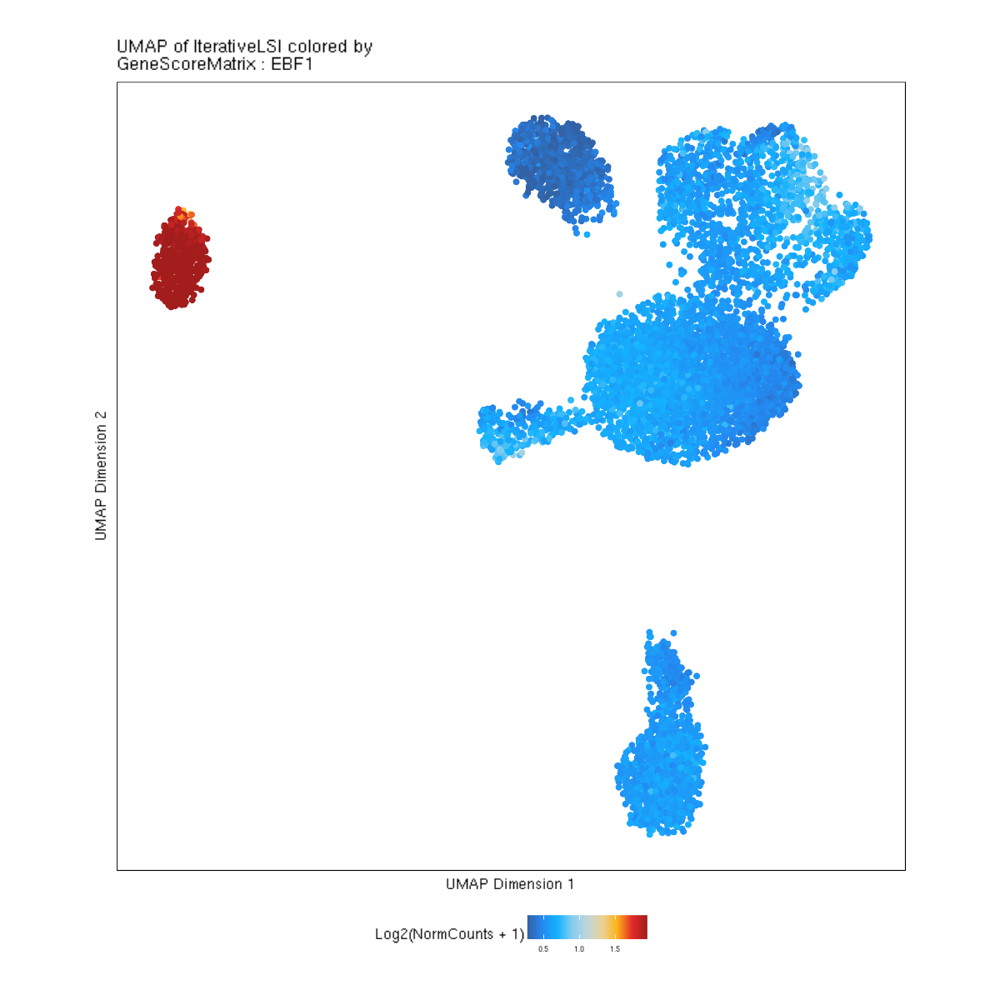

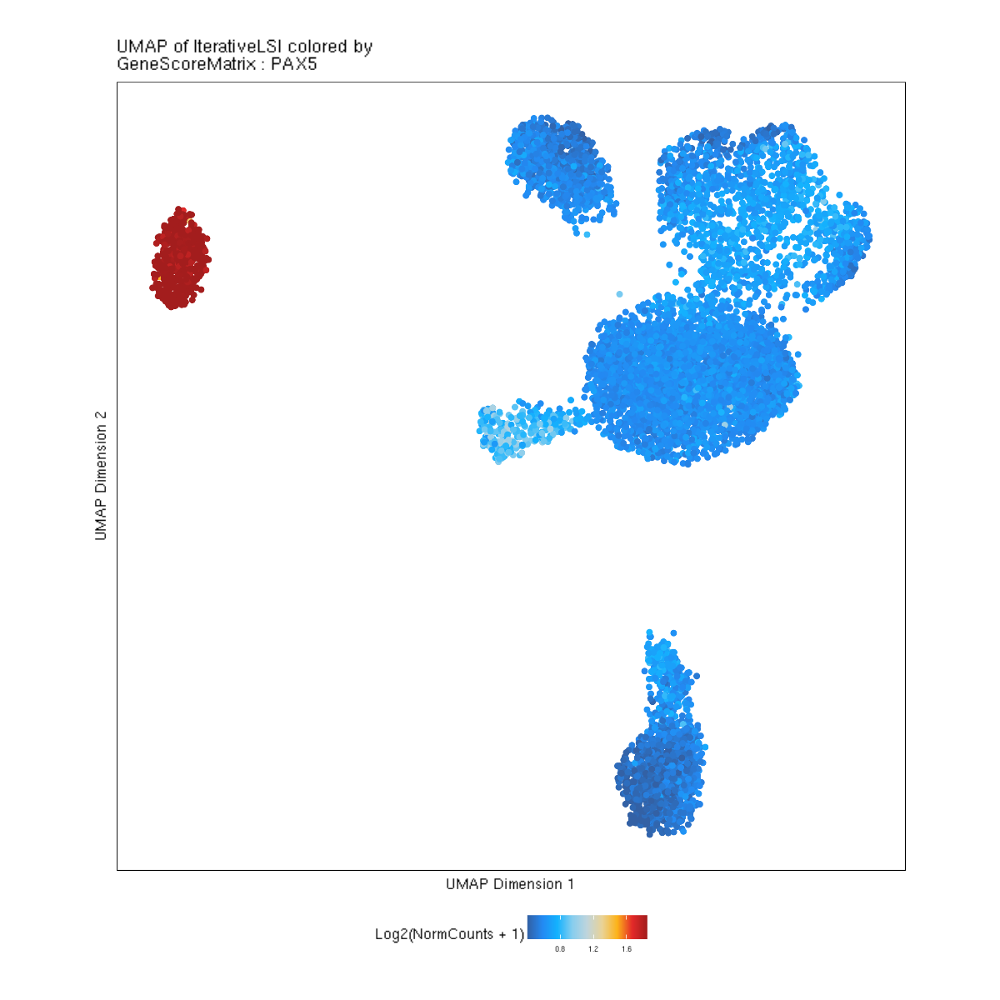

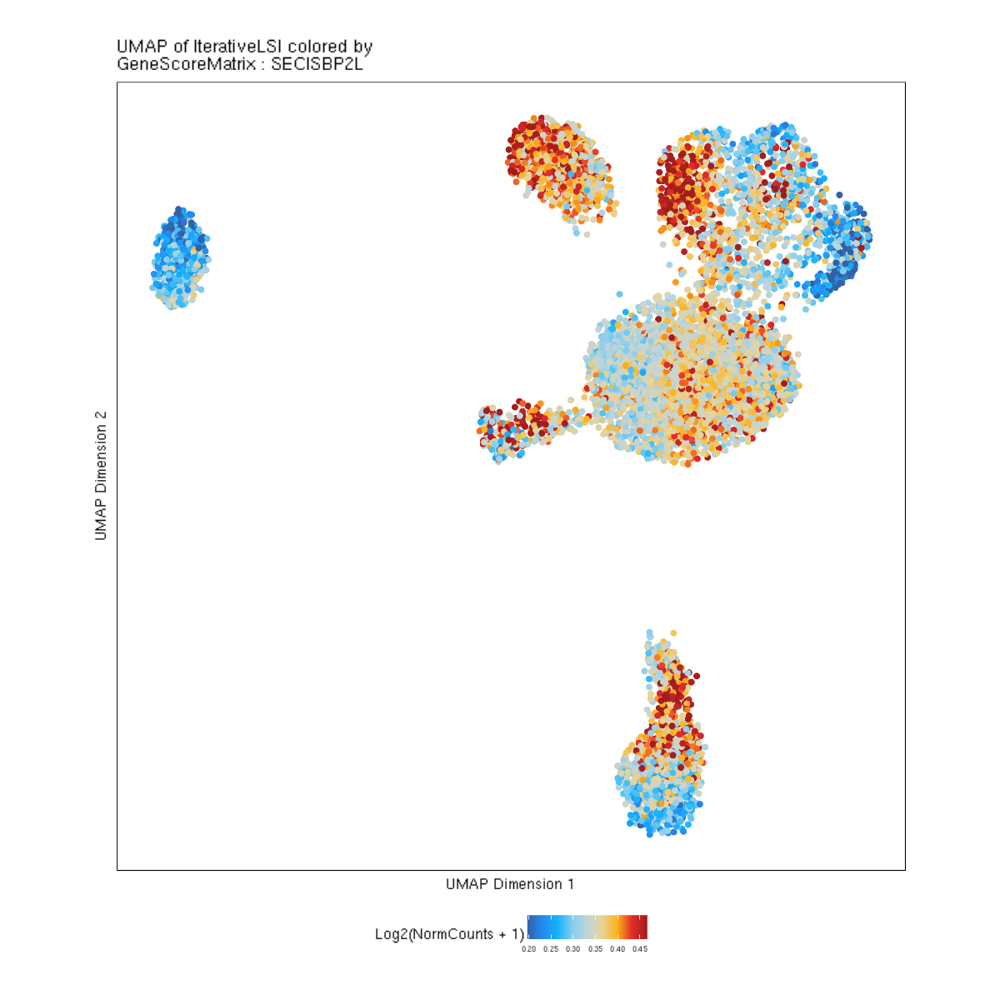

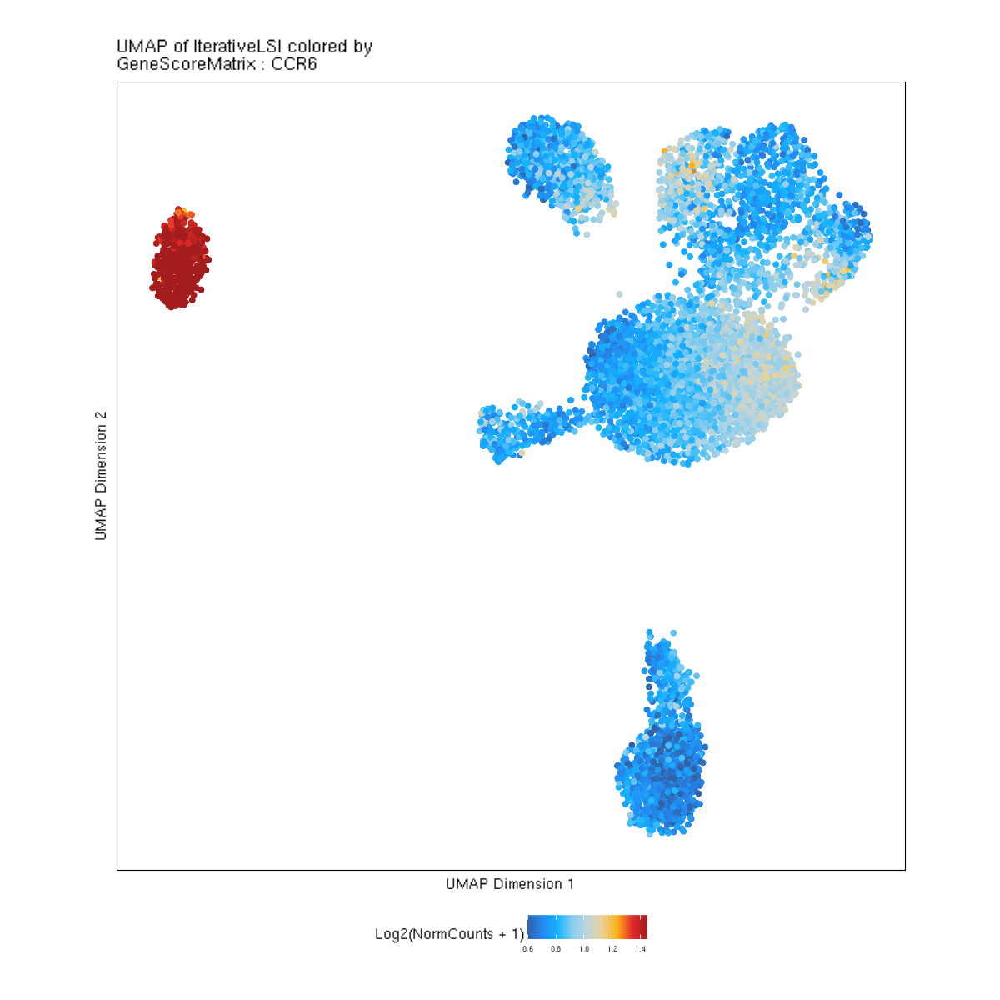

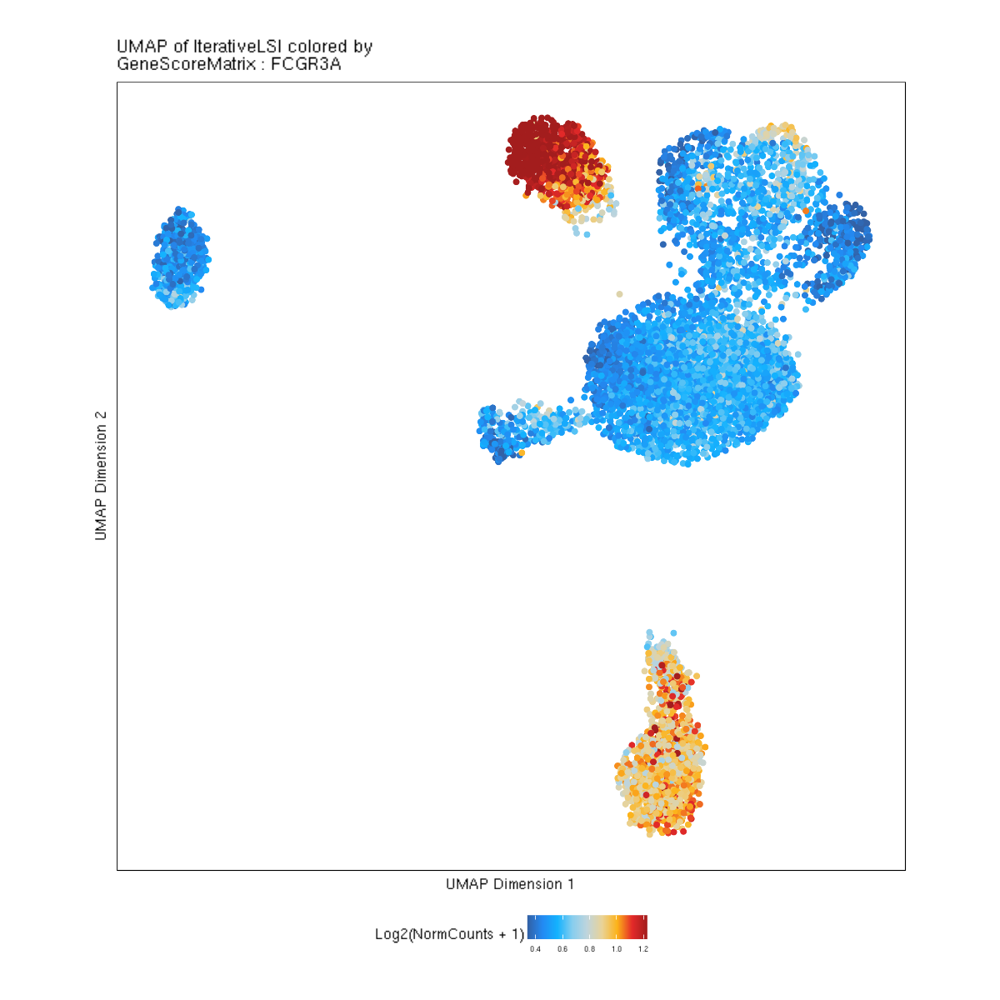

...

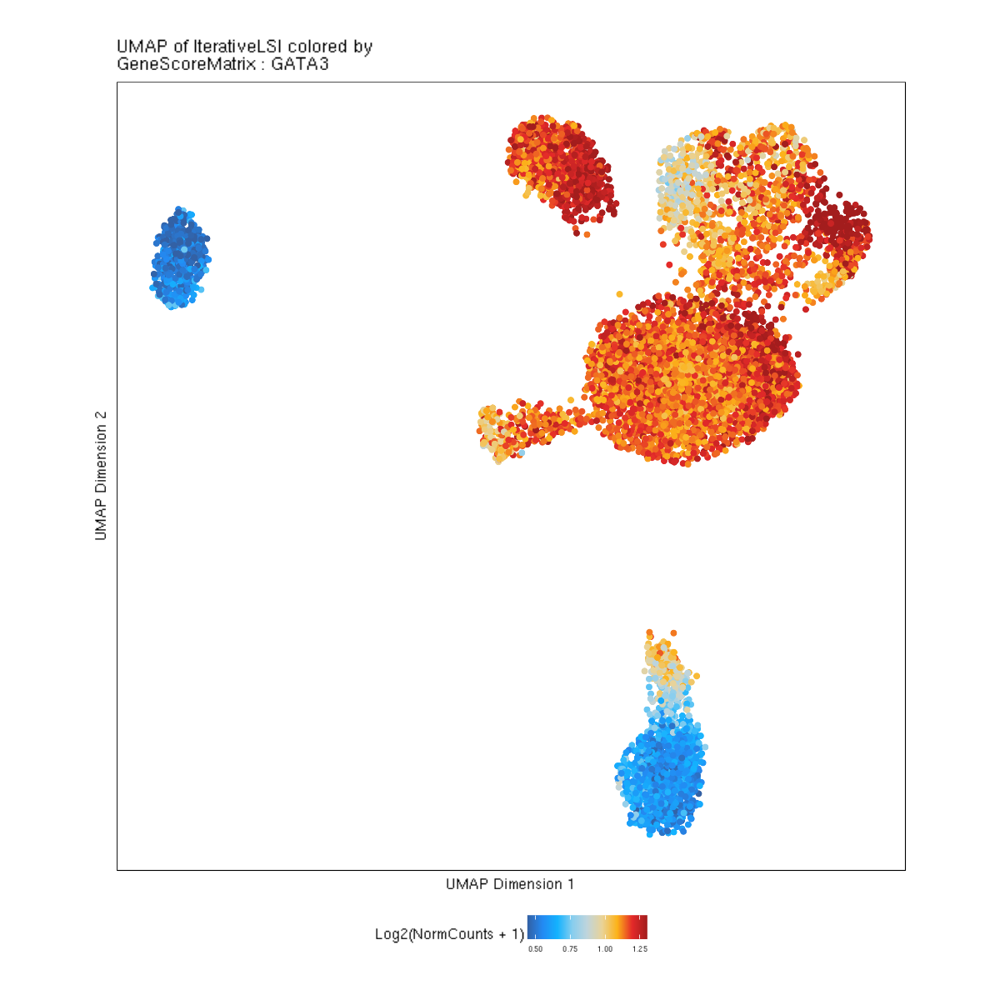

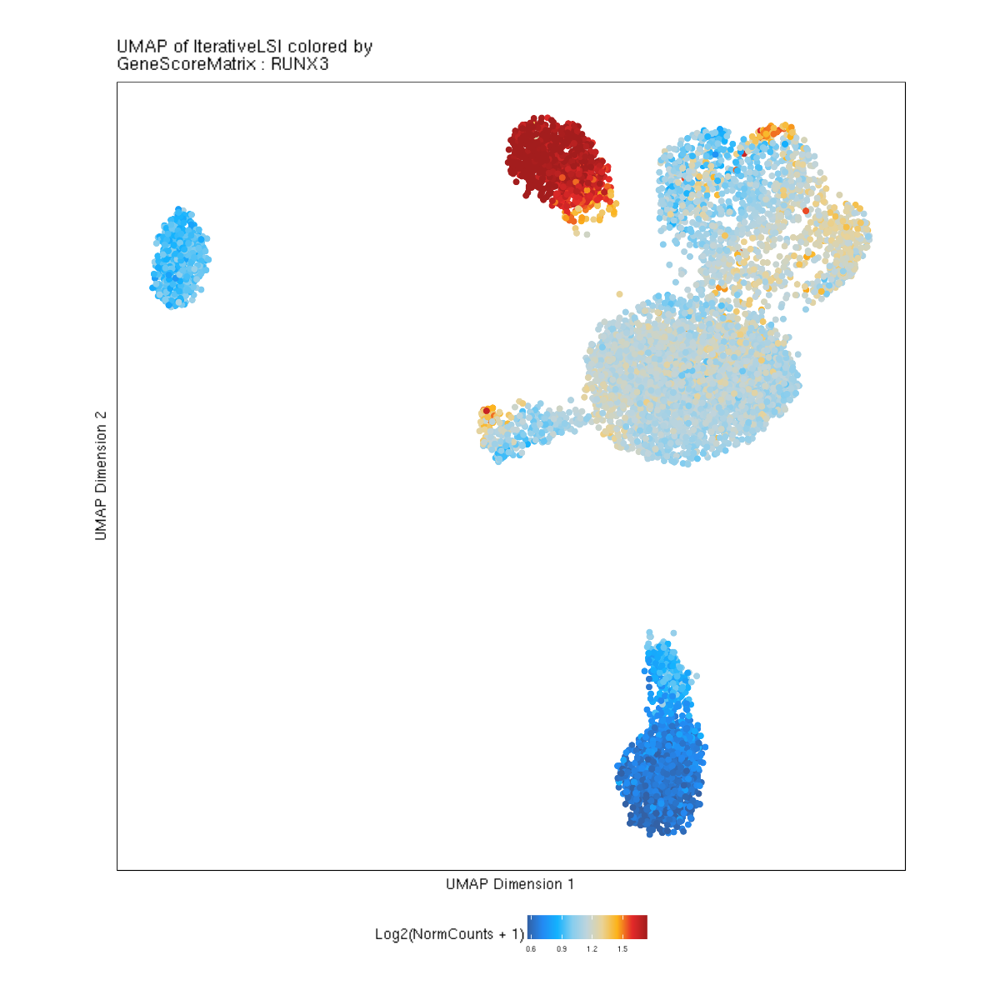

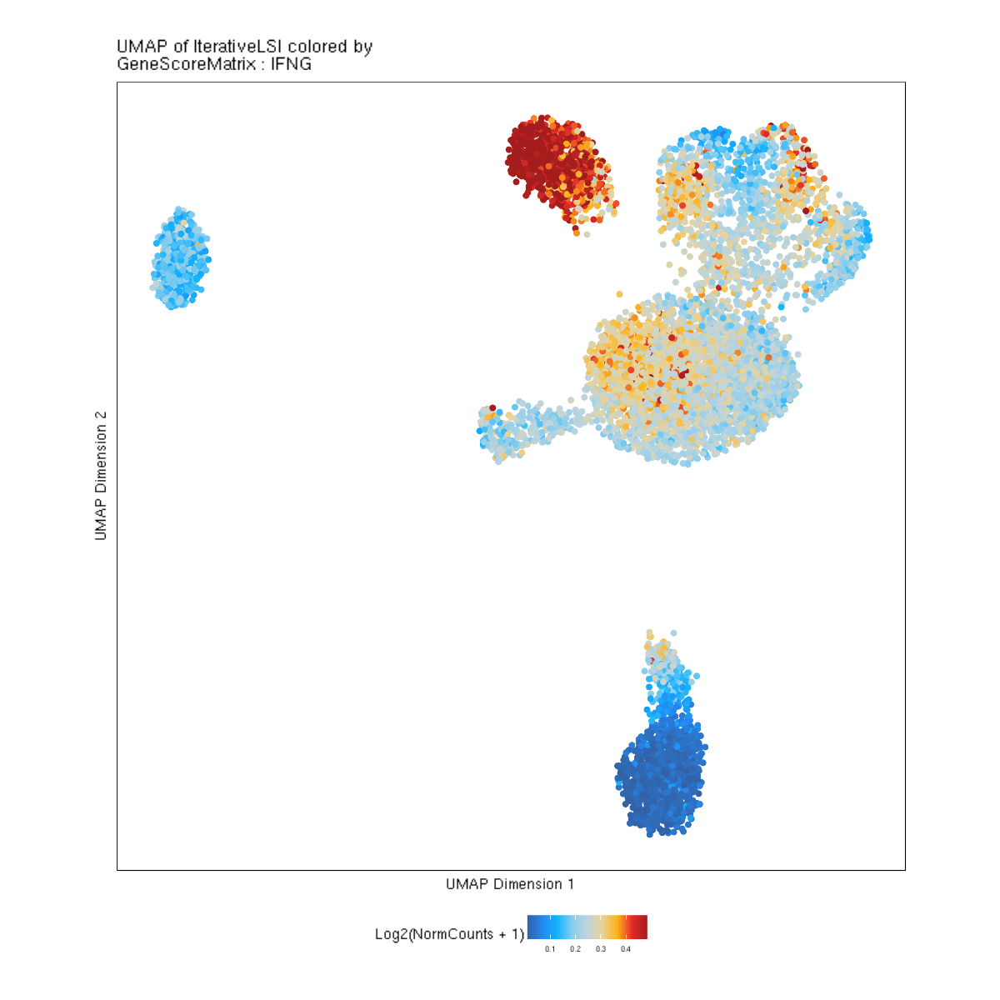

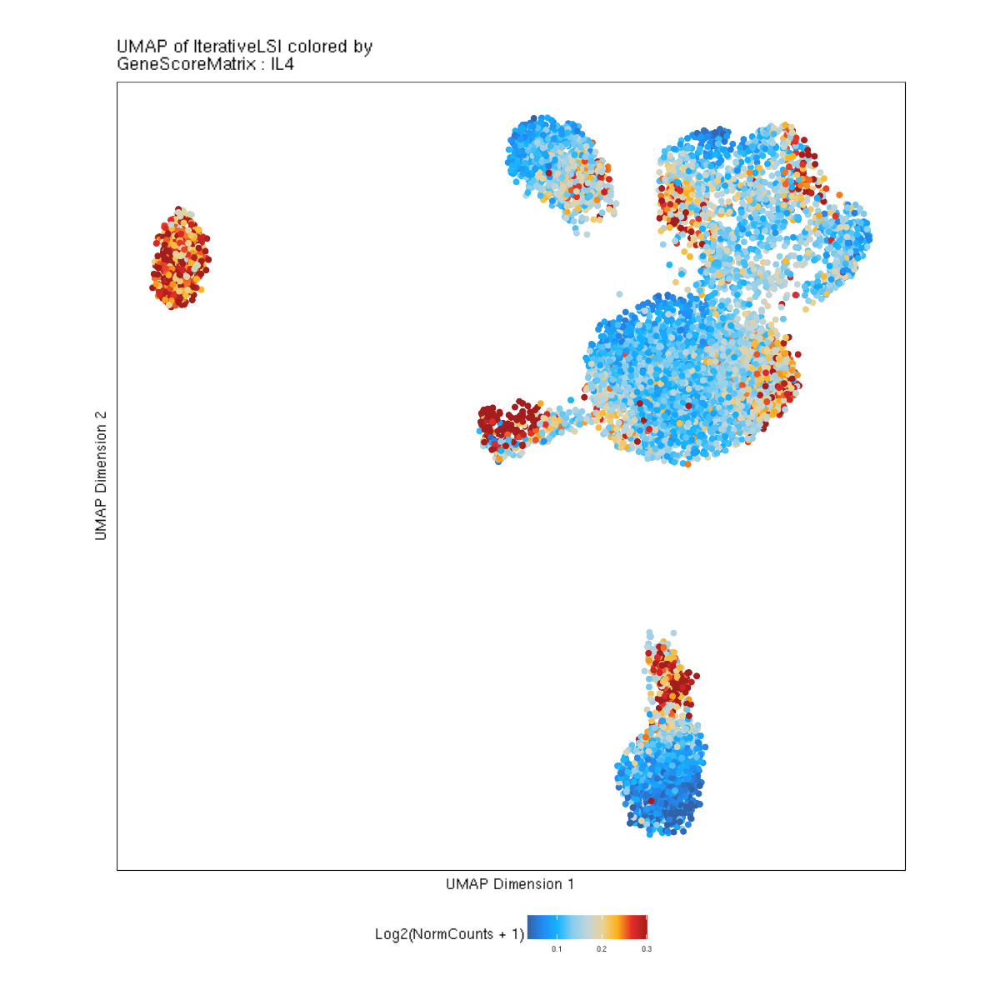

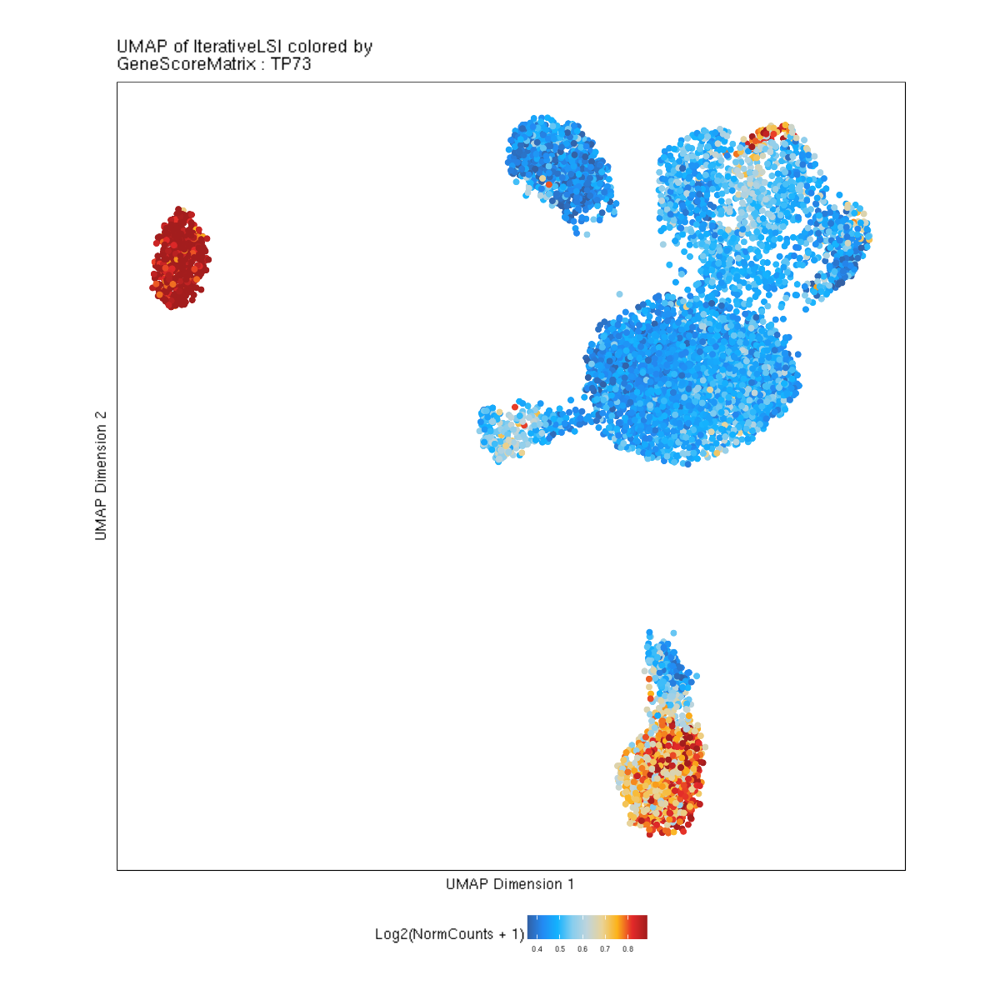

$EBF1

$PAX5

$SECISBP2L

$CCR6

$FCGR3A

$CEBPA

$CEBPB

$CD14

$LEF1

$CD4

$CD8A

$CD3D

$TBX21

$GATA3

$RUNX3

$IFNG

$IL4

$TP73

$NCAM1

$NCAM2


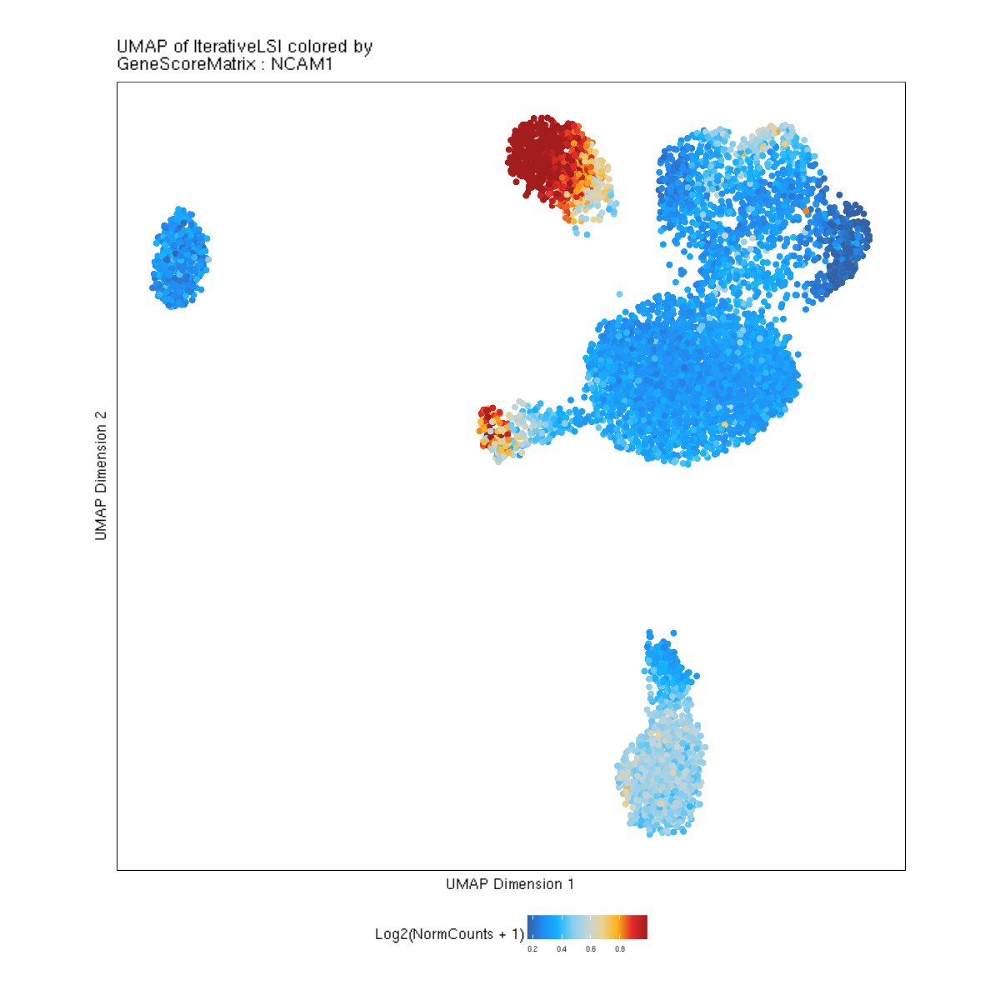

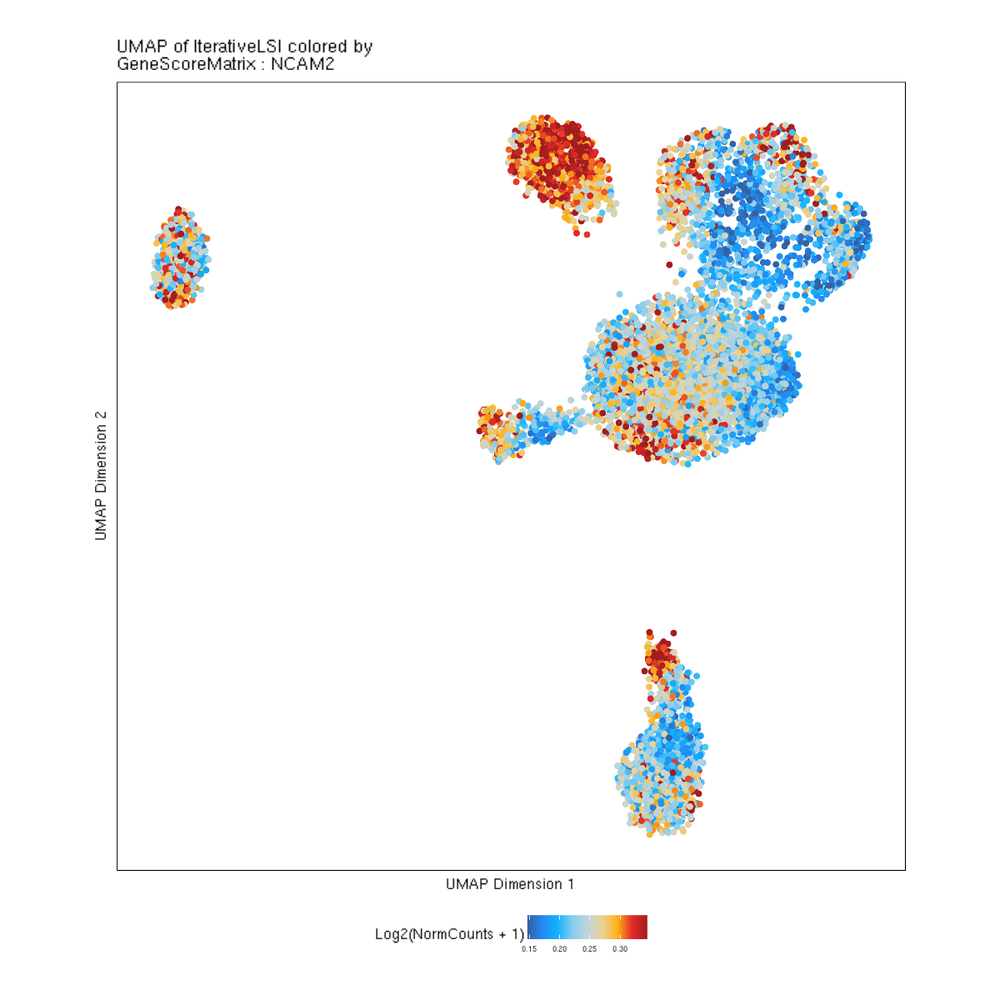

In [22]:
p2

ArchR logging to : ArchRLogs/ArchR-plotEmbedding-6989794d9c6d-Date-2022-10-04_Time-21-07-54.log
If there is an issue, please report to github with logFile!

Getting UMAP Embedding

ColorBy = GeneScoreMatrix

Getting Matrix Values...

2022-10-04 21:07:54 : 

1 


Plotting Embedding

1 


ArchR logging successful to : ArchRLogs/ArchR-plotEmbedding-6989794d9c6d-Date-2022-10-04_Time-21-07-54.log



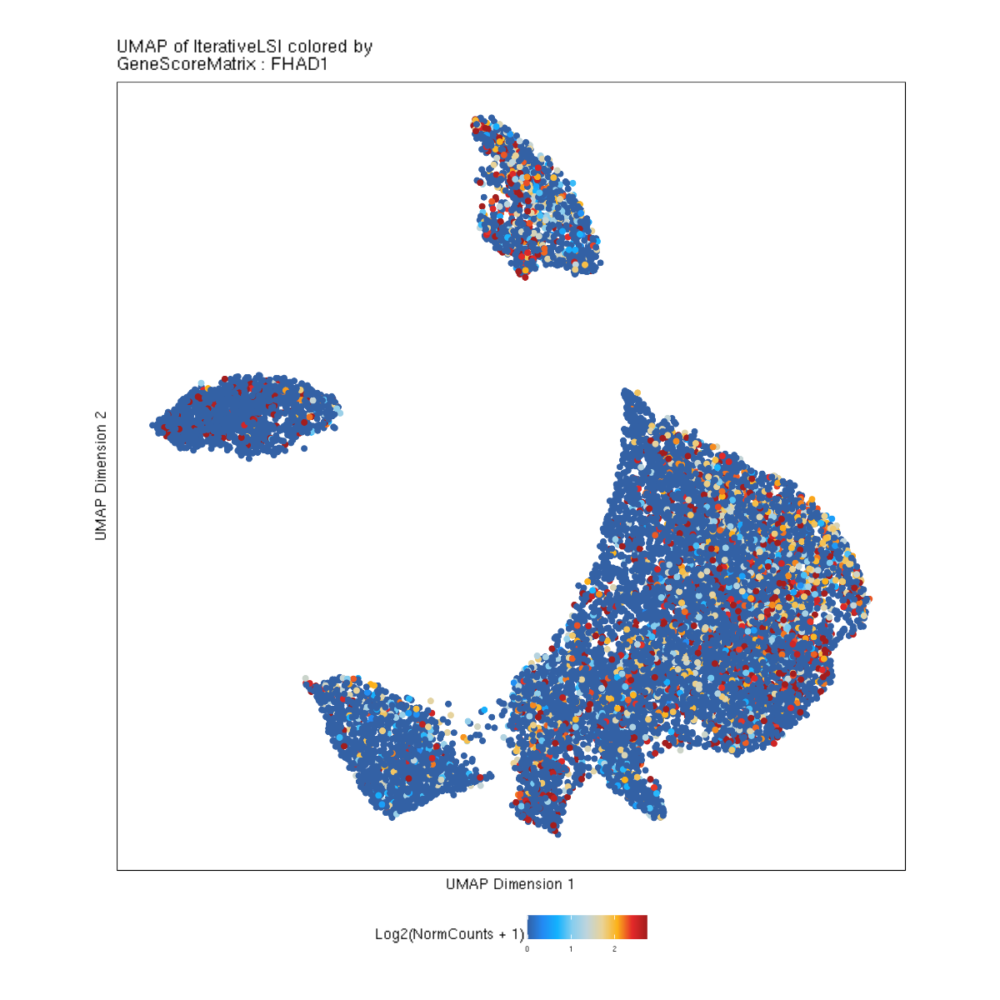

In [31]:
plotEmbedding(
        ArchRProj = proj, 
        colorBy = "GeneScoreMatrix", 
        name = 'FHAD1', 
        embedding = "UMAP",
        quantCut = c(0.01, 0.95),
        size =1, 
        pal= paletteContinuous(), 
        plotAs= "points", 
        imputeWeights = NULL#getImputeWeights(proj)
)

ArchR logging to : ArchRLogs/ArchR-plotMarkerHeatmap-416875b307d0-Date-2022-10-17_Time-15-43-52.log
If there is an issue, please report to github with logFile!

Printing Top Marker Genes:

B:

	LINC01342, TP73, LINC01346, RERE, PQLC2, ALPL, CNR2, CLIC4, BMP8A, SLC2A1, SLC2A1-AS1, AGBL4, BEND5, MIR4422, PLPP3

CD14 Mono:

	MIR34AHG, PDPN, PADI2, MIR3972, PADI4, ARHGEF10L, CDA, EPHB2, MIR4684, HMGCL, MIR1976, TRNP1, TENT5B, SLC9A1, FGR

CD16 Mono:

	LINC01342, PLCH2, TP73, LINC01346, ACOT7, RERE, SLC2A5, MIR34AHG, PDPN, FHAD1, EFHD2, PADI2, MIR3972, PADI4, ARHGEF10L

NK:

	PLCH2, ACOT7, RUNX3, HIVEP3, SLC1A7, GLIS1, SSBP3, SSBP3-AS1, TTC22, LEXM, C8A, IL12RB2, TGFBR3, ABCA4, LINC01776

T Mem 1:

	NPIPB3, MIR3680-1, NPIPB4, NPIPB5, SMG1P1, NPIPB11, CORO1A, NPIPB13, LINC01342, PLCH2, TP73, LINC01346, ACOT7, RERE, SLC2A5

T Mem 2:

	RNF187, RNA5S1, RNA5S9, RHOU, LINC01342, PLCH2, TP73, LINC01346, ACOT7, RERE, SLC2A5, MIR34AHG, PDPN, FHAD1, EFHD2

T Naive:

	MAN1C1, LBX1-AS1, CD6, CD5, MAML2

 [1] "EBF1"      "PAX5"      "SECISBP2L" "CCR6"      "FCGR3A"    "CEBPA"    
 [7] "CEBPB"     "LEF1"      "CD4"       "CD8A"      "CD3D"      "TBX21"    
[13] "GATA3"     "RUNX3"     "IFNG"      "IL4"       "TP73"      "NCAM1"    
[19] "NCAM2"    


Preparing Main Heatmap..

ArchR logging successful to : ArchRLogs/ArchR-plotMarkerHeatmap-416875b307d0-Date-2022-10-17_Time-15-43-52.log



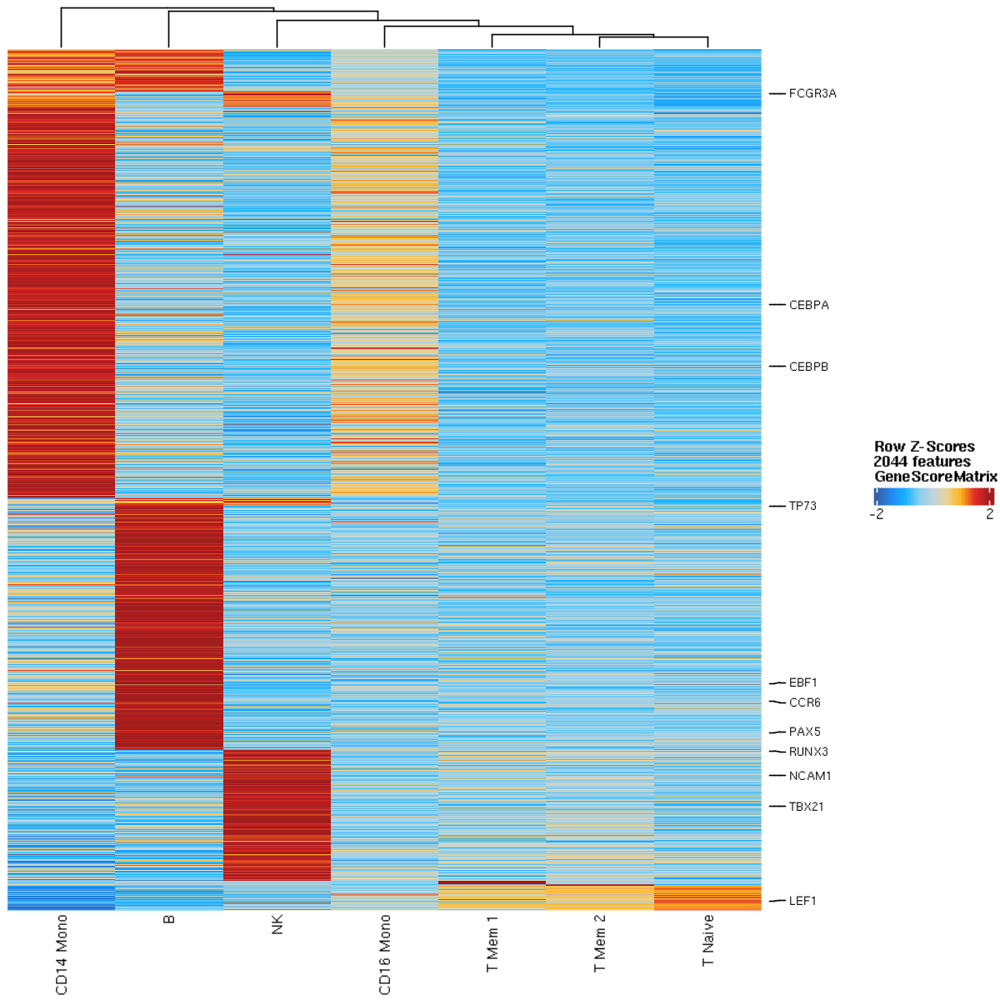

In [83]:
p0 = plotMarkerHeatmap(
  seMarker = markersGS,
  cutOff = "FDR <= 0.01 & Log2FC >= 0.5",
  log2Norm = TRUE,
  scaleTo = 10^4,
  scaleRows = TRUE,
  plotLog2FC = FALSE,
  limits = c(-2, 2),
  grepExclude = NULL,
  pal = paletteContinuous(),
  binaryClusterRows = TRUE,
  clusterCols = TRUE,
  labelMarkers = fin,
  nLabel = 15,
  nPrint = 15,
  labelRows = FALSE,
  returnMatrix = FALSE,
  transpose = FALSE,
  invert = FALSE,
  logFile = createLogFile("plotMarkerHeatmap")
)
p0

In [84]:
plot_dir = '/fh/fast/henikoff_s/user/jgreene/projects/sciCnT/data/Figures/'
pdf(file=paste0(plot_dir, '221017_PBMC_K4me123_genemap_up.pdf'),width=10, height=10)
p0
dev.off()

png 
  2

ArchR logging to : ArchRLogs/ArchR-plotMarkerHeatmap-4168cee9a48-Date-2022-10-17_Time-16-10-33.log
If there is an issue, please report to github with logFile!

Printing Top Marker Genes:

B:

	LINC01714, H6PD, TNFRSF1B, VPS13D, UBR4, MINOS1-NBL1, TCEA3, ACOT11, AK5, LPAR3, GBP5, LRRC8C, CDC7, RPAP2, GFI1

CD14 Mono:

	LINC01128, LINC00115, FAM41C, SAMD11, TTLL10, TNFRSF18, MMP23A, PLCH2, PANK4, HES2, ESPN, MIR4252, PLEKHG5, PIK3CD, PIK3CD-AS2

CD16 Mono:

	LINC01128, LINC00115, FAM41C, SAMD11, TTLL10, TNFRSF18, MMP23A, PLCH2, PANK4, AJAP1, HES2, ESPN, MIR4252, TNFRSF25, PLEKHG5

NK:

	AJAP1, ID3, LINC01725, PLPPR5, CSF1, PDE4DIP, SEMA4A, CACNA1E, RGL1, LINC00862, NAV1, NLRP3, OR2T5, IL2RA, FRMD4A

T Mem 1:

	LINC01128, LINC00115, FAM41C, SAMD11, TTLL10, TNFRSF18, MMP23A, PLCH2, PANK4, AJAP1, HES2, ESPN, MIR4252, TNFRSF25, PLEKHG5

T Mem 2:

	GAS7, LINC01128, LINC00115, FAM41C, SAMD11, TTLL10, TNFRSF18, MMP23A, PLCH2, PANK4, AJAP1, HES2, ESPN, MIR4252, TNFRSF25

T Naive:

	EFHD2, ARHGEF

 [1] "EBF1"      "PAX5"      "SECISBP2L" "CCR6"      "FCGR3A"    "CEBPA"    
 [7] "CEBPB"     "LEF1"      "CD4"       "CD8A"      "CD3D"      "TBX21"    
[13] "GATA3"     "RUNX3"     "IFNG"      "IL4"       "TP73"      "NCAM1"    
[19] "NCAM2"    


Preparing Main Heatmap..

ArchR logging successful to : ArchRLogs/ArchR-plotMarkerHeatmap-4168cee9a48-Date-2022-10-17_Time-16-10-33.log



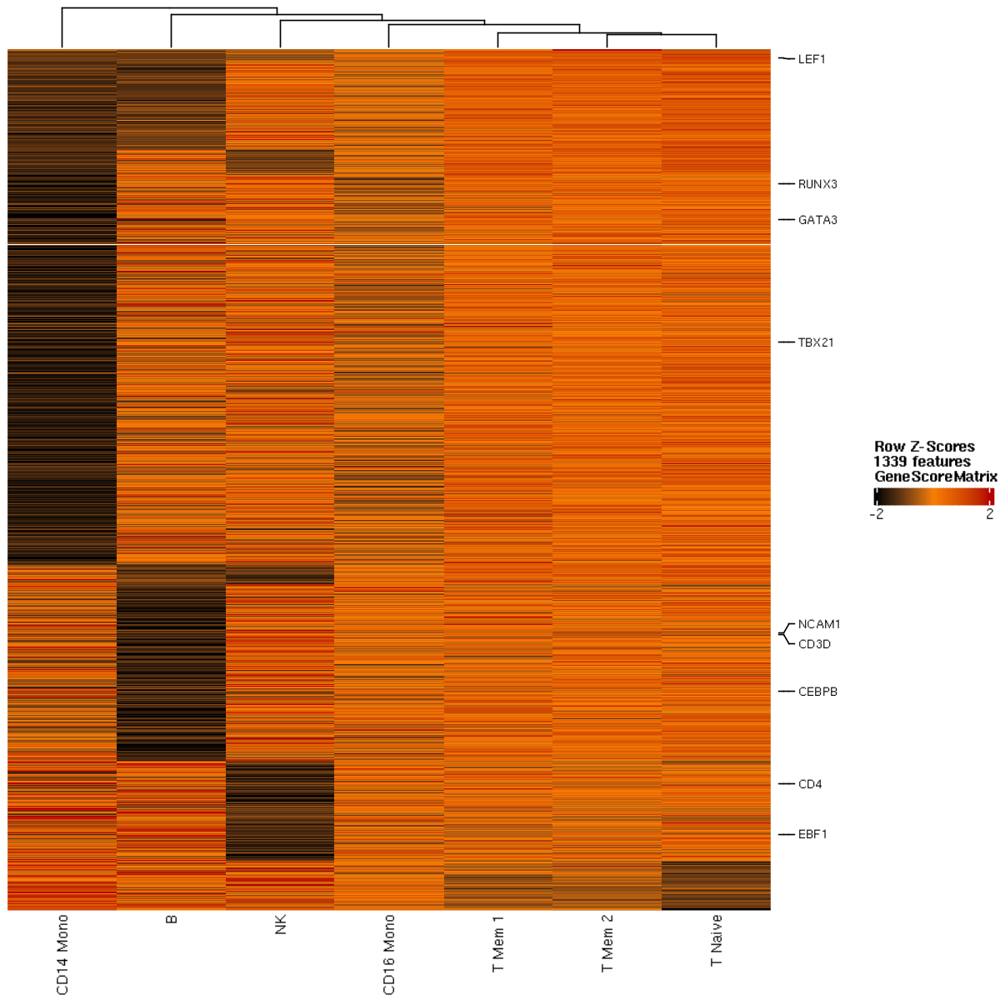

In [87]:
p0 = plotMarkerHeatmap(
  seMarker = markersGS,
  cutOff = "FDR <= 0.01 & Log2FC <= -0.5",
  log2Norm = TRUE,
  scaleTo = 10^4,
  scaleRows = TRUE,
  plotLog2FC = FALSE,
  limits = c(-2, 2),
  grepExclude = NULL,
  pal = c("3"="black","2"="#f77e05", "1"="#b50202"),
  binaryClusterRows = TRUE,
  clusterCols = TRUE,
  labelMarkers = fin,
  nLabel = 15,
  nPrint = 15,
  labelRows = FALSE,
  returnMatrix = FALSE,
  transpose = FALSE,
  invert = FALSE,
  logFile = createLogFile("plotMarkerHeatmap")
)
p0

In [90]:
proj
mean(proj$nFrags)


           ___      .______        ______  __    __  .______      
          /   \     |   _  \      /      ||  |  |  | |   _  \     
         /  ^  \    |  |_)  |    |  ,----'|  |__|  | |  |_)  |    
        /  /_\  \   |      /     |  |     |   __   | |      /     
       /  _____  \  |  |\  \\___ |  `----.|  |  |  | |  |\  \\___.
      /__/     \__\ | _| `._____| \______||__|  |__| | _| `._____|
    



class: ArchRProject 
outputDirectory: /fh/fast/henikoff_s/user/jgreene/projects/sciCnT/data/ArchR/DJ_Hs_PBMC_K4me123_220523_220527_79x79_MERGE_50k/proj_FINAL_v4 
samples(1): DJ_Hs_PBMC_K4me123_ALLSEQ_220523_220527
sampleColData names(1): ArrowFiles
cellColData names(23): Sample TSSEnrichment ... Clusters annotation
numberOfCells(1): 8024
medianTSS(1): 7.477
medianFrags(1): 1212

[1] 1420

In [88]:
plot_dir = '/fh/fast/henikoff_s/user/jgreene/projects/sciCnT/data/Figures/'
pdf(file=paste0(plot_dir, '221017_PBMC_K4me123_genemap_down.pdf'),width=10, height=10)
p0
dev.off()

png 
  2

In [45]:
tracks = plotBrowserTrack(
    ArchRProj = proj, 
    groupBy = "annotation", 
    geneSymbol = fin, 
    upstream = 500000,
    downstream = 500000,
    normMethod = 'nFrags'
)


ArchR logging to : ArchRLogs/ArchR-plotBrowserTrack-3b867a1b11c5-Date-2022-10-06_Time-13-13-08.log
If there is an issue, please report to github with logFile!

2022-10-06 13:13:09 : Validating Region, 0.007 mins elapsed.



GRanges object with 20 ranges and 2 metadata columns:
       seqnames              ranges strand |     gene_id      symbol
          <Rle>           <IRanges>  <Rle> | <character> <character>
   [1]     chr5 158695916-159099761      - |        1879        EBF1
   [2]     chr9   36833275-37034185      - |        5079        PAX5
   [3]    chr15   48988476-49046563      - |        9728   SECISBP2L
   [4]     chr6 166999405-167139696      + |        1235        CCR6
   [5]     chr5 140631728-140633701      - |         929        CD14
   ...      ...                 ...    ... .         ...         ...
  [16]     chr5 157085832-157142869      - |       84868      HAVCR2
  [17]     chr6   89926529-90296908      - |       60468       BACH2
  [18]    chr11 112961247-113278436      + |        4684       NCAM1
  [19]    chr21   20998315-21543329      + |        4685       NCAM2
  [20]    chr16   31355134-31382997      + |        3687       ITGAX
  -------
  seqinfo: 24 sequences from hg38 genom

Warning message in valid.GenomicRanges.seqinfo(x, suggest.trim = TRUE):
“GRanges object contains 1 out-of-bound range located on sequence chr2.
  Note that ranges located on a sequence whose length is unknown (NA) or
  on a circular sequence are not considered out-of-bound (use
  seqlengths() and isCircular() to get the lengths and circularity flags
  of the underlying sequences). You can use trim() to trim these ranges.
  See ?`trim,GenomicRanges-method` for more information.”
Warning message in valid.GenomicRanges.seqinfo(x, suggest.trim = TRUE):
“GRanges object contains 1 out-of-bound range located on sequence chr2.
  Note that ranges located on a sequence whose length is unknown (NA) or
  on a circular sequence are not considered out-of-bound (use
  seqlengths() and isCircular() to get the lengths and circularity flags
  of the underlying sequences). You can use trim() to trim these ranges.
  See ?`trim,GenomicRanges-method` for more information.”
Warning message in valid.GenomicRa

In [46]:
plotPDF(plotList = tracks, 
    name = "Plot-Tracks-Marker-Genes.pdf", 
    ArchRProj = proj, 
    addDOC = FALSE, width = 5, height = 5)

Plotting Gtable!



NULL


Plotting Gtable!



NULL


Plotting Gtable!



NULL


Plotting Gtable!



NULL


Plotting Gtable!

Warning message:
“ggrepel: 18 unlabeled data points (too many overlaps). Consider increasing max.overlaps”


NULL


Plotting Gtable!



NULL


Plotting Gtable!



NULL


Plotting Gtable!

Warning message:
“ggrepel: 14 unlabeled data points (too many overlaps). Consider increasing max.overlaps”
Warning message:
“ggrepel: 9 unlabeled data points (too many overlaps). Consider increasing max.overlaps”


NULL


Plotting Gtable!



NULL


Plotting Gtable!



NULL


Plotting Gtable!



NULL


Plotting Gtable!



NULL


Plotting Gtable!



NULL


Plotting Gtable!



NULL


Plotting Gtable!



NULL


Plotting Gtable!



NULL


Plotting Gtable!



NULL


Plotting Gtable!



NULL


Plotting Gtable!



NULL


Plotting Gtable!



NULL


In [ ]:
colnames(getCellColData(proj))

In [12]:
write.csv(getCellColData(proj), 'cell_metadata.csv', quote=FALSE)

In [117]:
saveArchRProject(ArchRProj = proj,load = FALSE)

Saving ArchRProject...

